# Analyis for the Dark Machines Collider Unsupervised Challenge
This notebook examines the results for the [hackathon dataset](https://zenodo.org/record/3961917#.X2tooJNKhQM). The methods were trained on background only samples and then applied to a mix of background and signal. In this step of the challenge, truth information was available. This was used to determine the receiver operating characteristic (ROC) curve, the area under the ROC curve (AUC), and the signal effeficency at different fixed background rejection working points.

There are 554 different models which were submitted. They are applied to 19 different dark matter signals across 4 channels, for a combined 34 unique channel + signature combinations.

Notebook author: Bryan Ostdiek (bostdiek at g.harvard.edu)

In [1]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gs
from matplotlib.patches import Patch

from scipy.interpolate import interp1d

from os import walk, path

from sklearn.metrics import roc_curve, auc

In [2]:
plt.rcParams.update({'font.family': 'cmr10',
                     'font.size': 12,
                     'axes.unicode_minus': False,
                     'axes.labelsize': 12,
                     'axes.labelsize': 12,
                     'figure.figsize': (4, 4),
                     'figure.dpi': 160,
                     'mathtext.fontset': 'cm',
                     'mathtext.rm': 'serif',
                     'xtick.direction': 'in',
                     'ytick.direction': 'in',
                     'xtick.top': True,
                     'ytick.right': True
                     })

# Load Data Files
## Adam Leinweber - Traditional VAE

In [3]:
AL = pd.read_csv('../data/all_csv/Adam_Leinweber_latent_combined_scores_all.csv',
            names=['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
           )

## Pratik Jawahar - Normalizing Flows

In [4]:
PJ = pd.read_csv('../data/all_csv/VAEwNormFlows_Results.csv',
                 names=['Signal', 'Model', 'AUC', '1e-2', '1e-3', '1e-4']
           )
snames = list(PJ['Signal'])
chan = [s.split('/')[0].replace('chan', '').replace('_sig', '') for s in snames]
snames = [s.split('/')[-1] for s in snames]

snames = ['_'.join(s.split('_')[:-1]) for s in snames]
PJ['Signal'] = snames
PJ['Chan'] = chan

## Alessandro Morandini - Density based models

In [5]:
AM = pd.read_csv('../data/all_csv/DE_scores.csv',
                 names=['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                )

## Luc Hendrix - VAE_AUC

In [6]:
LH_VAE = pd.read_csv('../data/all_csv/vae_auc_scores.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_VAE['Model'] = LH_VAE['Modelt'] + '_' + LH_VAE['Metric']

## Luc Hendrix - Flow

In [7]:
LH_Flow = pd.read_csv('../data/all_csv/flow_auc_scores.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Flow['Model'] = LH_Flow['Modelt'] + '_' + LH_Flow['Metric']

## Luc Hendrix - Combined

In [8]:
LH_Combined = pd.read_csv('../data/all_csv/combined_scores.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Combined['Model'] = LH_Combined['Modelt'] + '_' + LH_Combined['Metric']

## Luc Hendrix - Fixed Target

In [9]:
LH_Fixed = pd.read_csv('../data/all_csv/results-fixed-target.csv',
                     names=['Signal', 'Modelt', 'Metric', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
                    )
LH_Fixed['Model'] = LH_Fixed['Modelt'] + '_' + LH_Fixed['Metric']

In [10]:
LH_Fixed['Model'].unique().shape

(80,)

## Bryan Ostdiek - Deep Sets

In [11]:
BO = pd.read_csv('../data/all_csv/DeepSetsVAE_8d_results_combined.csv')
snames = list(BO['Signal'])
chan = [s.split('_')[-1].replace('chan', '') for s in snames]
sig = ['_'.join(s.split('_')[:-1]) for s in snames]
BO['Signal'] = sig
BO['Chan'] = chan
BO['Model'] = BO['ModelName']
BO['1e-2'] = BO['S1e-2']
BO['1e-3'] = BO['S1e-3']
BO['1e-4'] = BO['S1e-4']

## Combine All Submissions

In [12]:
names = ['Signal', 'Model', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
AllCombined = np.array(AL[names])
AllCombined = np.vstack([AllCombined, PJ[names]])
AllCombined = np.vstack([AllCombined, AM[names]])
AllCombined = np.vstack([AllCombined, LH_VAE[names]])
AllCombined = np.vstack([AllCombined, LH_Flow[names]])
AllCombined = np.vstack([AllCombined, LH_Combined[names]])
AllCombined = np.vstack([AllCombined, LH_Fixed[names]])
AllCombined = np.vstack([AllCombined, BO[names]])
AllCombined = pd.DataFrame(AllCombined, columns=names)

Check for models which were not applied to all of the signals.

In [13]:
incomplete_models = []
for Chan in ['1', '2a', '2b', '3']:
    for mod in list(AllCombined['Model'].unique()):
        if mod not in list(AllCombined[AllCombined['Chan'] == Chan]['Model']):
            print(f'Missing Chan {Chan} for {mod}')
            incomplete_models.append(mod)

Missing Chan 3 for Fixed-combined-z377_MSE
Missing Chan 3 for Fixed-MSE0-z377_MSE
Missing Chan 3 for Fixed-MSE1-z377_MSE
Missing Chan 3 for Fixed-MSE2-z377_MSE
Missing Chan 3 for Fixed-MSE3-z377_MSE
Missing Chan 3 for Fixed-MSE4-z377_MSE
Missing Chan 3 for Fixed-MSE10-z377_MSE
Missing Chan 3 for Fixed-MSE25-z377_MSE


Remove the `Fixed-z377` models

In [14]:
AllCombined = AllCombined[~AllCombined['Model'].isin(incomplete_models)]

In [15]:
AllCombined.Model.unique().shape

(554,)

There are over 550 models which are being analyzed

In [16]:
AllCombined['Signal'].unique().shape

(19,)

In [17]:
(AllCombined['Chan'] + AllCombined['Signal']).unique().shape

(34,)

There are 19 different signals across the 4 channels, with 34 unique chan + signal combinations.

# Build Analysis Function
It is not obvious what the best metric is to use for quantifying which model performs the best. This will examine the area under the ROC curve (AUC), and the signal efficiency at three different background efficiencies $\epsilon_{s}\big(\epsilon_b = 10^{-2(-3)[-4]}\big)$. For each metric, we will then find the model which has the highest score for each signal, the models which have the top 5 scores for each signal, the average rank, the average score, and the minimum score.

In [18]:
def Analyze(CombinedDataFrame, Chan, Metric, MetricNumberDict, Plot):
    """
    Inputs:
        CombineedDataFrame: Pandas dataframe with columns ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
        Chan: String with which signal chanel is being analyzed. Must be one of ['1', '2a', '2b', '3', 'All']
        Metric: String indicating the metric to use, must be one of ['AUC', '1e-2', '1e-3', '1e-4']
        MetricNumberDict: The number of models to include for each sorting. Will usually include 5, 
            but some of the rankings need different numbers.
            example: MetricNumberDict = {'top1': 5, 
                                         'top5': 5,
                                         'AverageRank': 5,
                                         'MeanScore': 5,
                                         'MedianScore': 5,
                                         'MinScore': 5}
        Plot: Boolean if to make bar plots or not
        
    """
    for col in ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']:
        if col not in CombinedDataFrame.columns:
            print(f'CombinedDataFrame is missing column {col}')
            return 0
    if Chan not in ['1', '2a', '2b', '3', 'All']:
        print(f'Invalid "Chan" selection: {Chan}')
        return 0
    if Metric not in ['AUC', '1e-2', '1e-3', '1e-4']:
        print(f'Invalid "Metric" selection: {Metric}')
        return 0
    
    if Chan != 'All':
        AnalyzeFrame = CombinedDataFrame[CombinedDataFrame['Chan'] == Chan]
    else:
        AnalyzeFrame = CombinedDataFrame
    
    # This helper variable combines the channel and signal since some signals appear in multiple channels
    chansig = AnalyzeFrame['Chan'] + '/' + AnalyzeFrame['Signal']
    chansig = np.unique(chansig)
    sigs = AnalyzeFrame.Signal.unique()
    mods = AnalyzeFrame.Model.unique()
    SortedScores = pd.DataFrame()
    SortedScores['Model'] = mods
    
    # Go through each of the signals to find the ranking of the models
    for sig in chansig:
        chan, sig = sig.split('/')
        cs = AnalyzeFrame[(AnalyzeFrame['Signal'] == sig) & (AnalyzeFrame['Chan']==chan)]
        scorelist = cs[Metric]
        score_ranking = np.zeros_like(scorelist)
        for i, score in enumerate(np.argsort(-scorelist)):  # argsort gives the ordering to sort them, we want the orthogonal information
            score_ranking[score] = i
        SortedScores[sig] = score_ranking
    SortedScores['AverageRank'] = SortedScores[[col for col in SortedScores.columns if 'Model' not in col]].mean(axis=1)
    SortedScores['top1'] = (SortedScores[[col for col in SortedScores.columns if (('AverageRank' not in col)
                                                                                  and ('Model' not in col)
                                                                                 )]] < 1).sum(axis=1)
    SortedScores['top5'] = (SortedScores[[col for col in SortedScores.columns if (('AverageRank' not in col) and 
                                                                                  ('top1' not in col) and
                                                                                  ('Model' not in col)
                                                                                 )]] < 5).sum(axis=1)

    meanscore = []
    medianscore = []
    minscore = []
    for m in mods:
        tmpdf = AnalyzeFrame[AnalyzeFrame['Model'] == m]
        tmpscores = tmpdf[Metric]
        meanscore.append(tmpscores.mean())
        medianscore.append(tmpscores.median())
        minscore.append(tmpscores.min())
    SortedScores['MeanScore'] = meanscore
    SortedScores['MedianScore'] = medianscore
    SortedScores['MinScore'] = minscore
    
    BestC = []
    TopDict = {}

    for key in ['top1', 'top5', 'AverageRank', 'MeanScore', 'MedianScore', 'MinScore']:
        num = MetricNumberDict[key]
        if num == 0: continue
        TopDict[key] = SortedScores.sort_values(by=key,ascending=True if key =='AverageRank' else False)[['Model']][:num].to_numpy().reshape(num)
        BestC += list(TopDict[key])
        print('*'*40)
        print(f'Models from chan={Chan} ranked by metric={Metric} sorted by {key}')
        print(SortedScores.sort_values(by=key,ascending=True if key =='AverageRank' else False)[['Model', key]][:num])
        print('*'*40)
        print()
        
    if Plot:
        BestC = np.array(BestC).flatten()
        BestCU = np.unique(BestC)
        
        Criteria = [['Top score on a signal', TopDict['top1']],
                    ['Top 5 score on a signal', TopDict['top5']],
                    ['Average Rank', TopDict['AverageRank']],
                    ['Mean Score', TopDict['MeanScore']],
                    ['Median Score', TopDict['MedianScore']],
                    ['Minimum Score', TopDict['MinScore'] if MetricNumberDict['MinScore'] else []]
                   ]
        if MetricNumberDict['MinScore'] == 0:
            Criteria=Criteria[:-1]

        for (name, crit) in Criteria:
            plt.figure(figsize=(8, 5))
            colors = ['grey' if m not in crit else 'C0' for m in BestCU]

            for colnum, col in enumerate(['AUC', '1e-2', '1e-3', '1e-4']):
                ax = plt.subplot(1, 4, colnum + 1)
                if col == Metric:
                    ax.set_facecolor('lavenderblush')
                yvs=[]
                names = []
                data_all = []
                for i,m in enumerate(BestCU):
                    tmp_data = []
                    tmpdf = AnalyzeFrame[AnalyzeFrame['Model']==m].copy()
                    for s in chansig:
                        chan, s = s.split('/')
                        tmpauc = tmpdf[(tmpdf['Signal'] == s) & (tmpdf['Chan']==chan)][col]
                        tmp_data.append(tmpauc)
                    data_all.append(np.array(tmp_data).reshape(len(chansig)))
                    yvs.append(i)
                    names.append(m)
                databp = np.array(data_all).reshape(len(BestCU), len(chansig))
                databp[databp == 0] = 1e-10
                bbox1 = plt.boxplot(databp.T,
                            vert=False,
                            manage_ticks=False,
                            patch_artist=True,
                            medianprops={'color':'k'},
                            positions=yvs
                           )

                if colnum == 0:
                    plt.yticks(yvs, [n.replace('_', r'$\_$') for n in names])
                    plt.xlim(0, 1)
                else:
                    plt.yticks(yvs, [])
                    plt.xscale('log')
                    plt.xlim(1e-4, 1)
                    plt.xticks([1e-4, 1e-3, 1e-2, 1e-1, 1e0])


                for patch, color in zip(bbox1['boxes'], colors):
                    patch.set_facecolor(color)
                    plt.minorticks_on()
                plt.grid()
                plt.xlabel(col)

            plt.suptitle(f'Best Models on Chan:{Chan} based on {Metric}: {name}')
            plt.savefig(f'../reports/Plots/TopChan{Chan}_{Metric}_{name.replace(" ", "_")}_boxplot.pdf', bbox_inches='tight')   

# Do the analysis
## Chan 1
### AUC

****************************************
Models from chan=1 ranked by metric=AUC sorted by top1
                                         Model  top1
477  Combined-AVG_VAE Radius + Flow Likelihood     4
294                      VAE_ConvolutionalFlow     2
510                         Fixed-MSE2-z55_MSE     1
509                         Fixed-MSE2-z34_MSE     1
****************************************

****************************************
Models from chan=1 ranked by metric=AUC sorted by top5
                                          Model  top5
476  Combined-PROD_VAE Radius + Flow Likelihood     5
477   Combined-AVG_VAE Radius + Flow Likelihood     5
474   Combined-AND_VAE Radius + Flow Likelihood     3
475    Combined-OR_VAE Radius + Flow Likelihood     3
294                       VAE_ConvolutionalFlow     3
134                           VAE_13_1e-05_1000     2
****************************************

****************************************
Models from chan=1 ranked by metric=AUC 

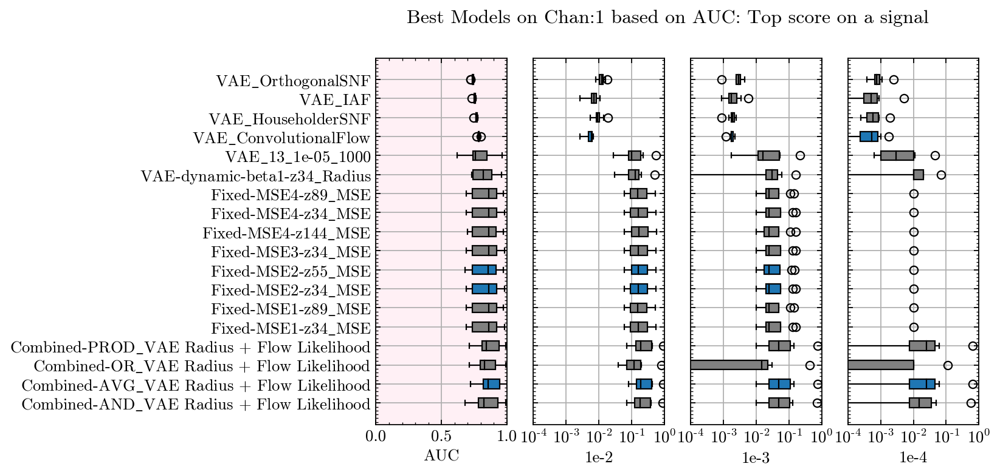

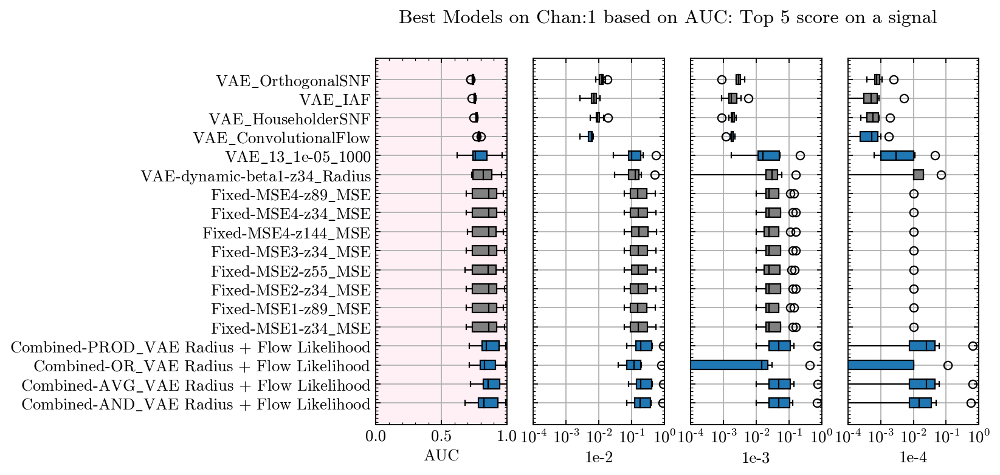

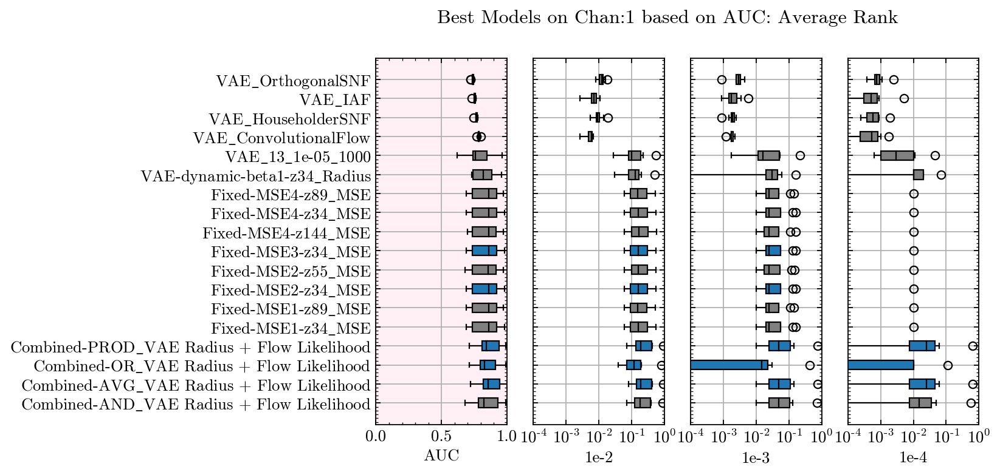

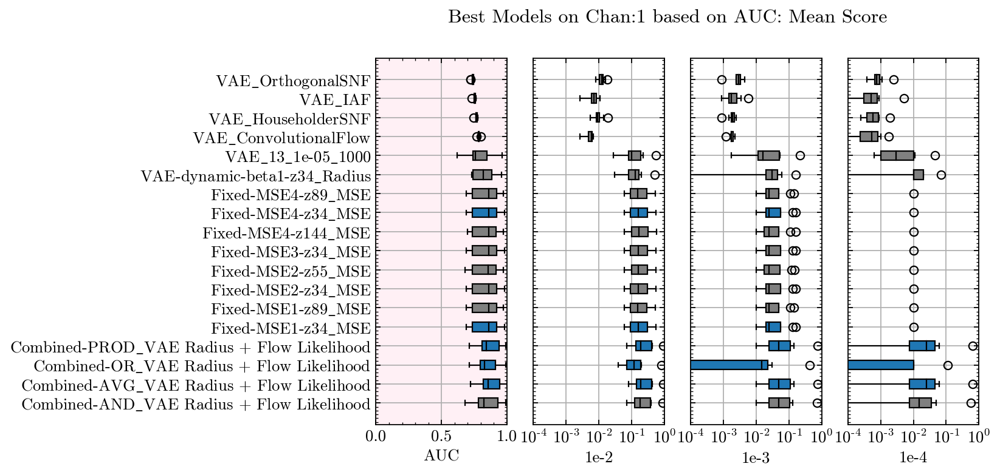

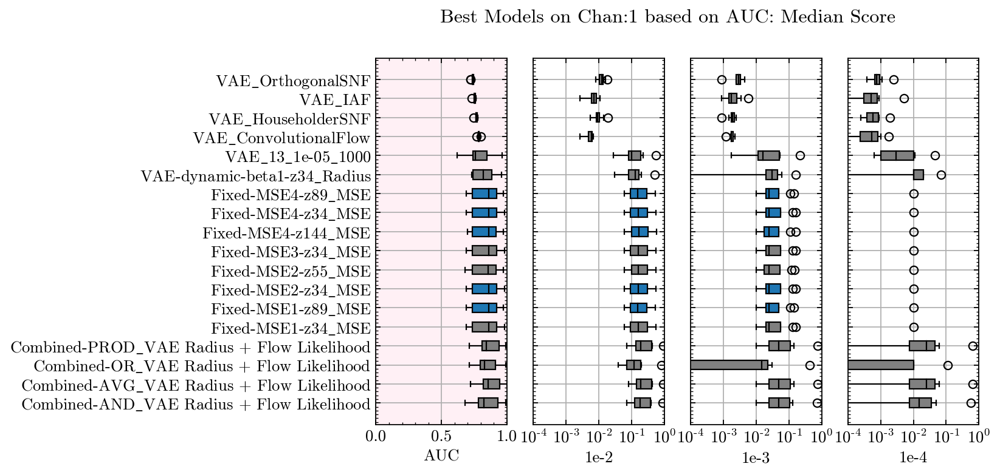

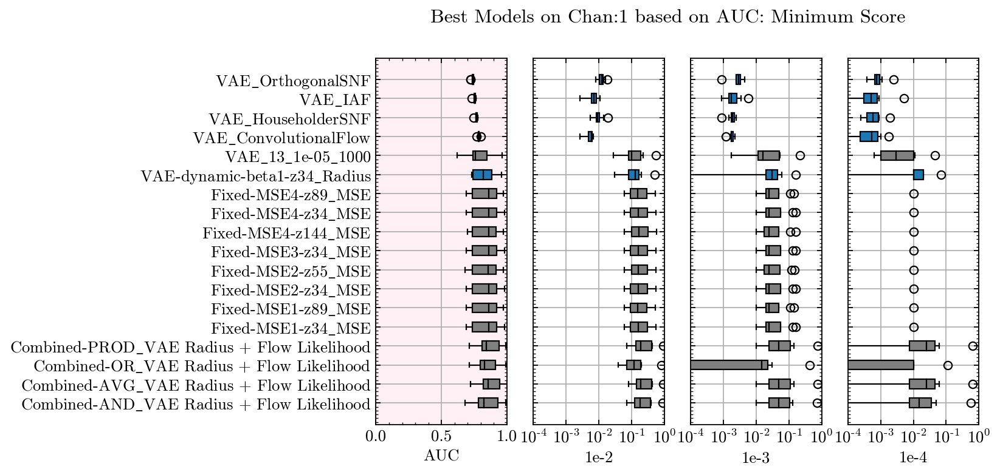

In [19]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='AUC',
        MetricNumberDict = {'top1': 4,
                            'top5': 6,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

****************************************
Models from chan=1 ranked by metric=1e-2 sorted by top1
                                          Model  top1
477   Combined-AVG_VAE Radius + Flow Likelihood     3
303                                    PCA_D=10     2
494                         Fixed-MSE0-z144_MSE     1
521                         Fixed-MSE3-z144_MSE     1
476  Combined-PROD_VAE Radius + Flow Likelihood     1
****************************************

****************************************
Models from chan=1 ranked by metric=1e-2 sorted by top5
                                          Model  top5
474   Combined-AND_VAE Radius + Flow Likelihood     4
477   Combined-AVG_VAE Radius + Flow Likelihood     4
476  Combined-PROD_VAE Radius + Flow Likelihood     4
302                                     PCA_D=9     3
494                         Fixed-MSE0-z144_MSE     3
****************************************

****************************************
Models from chan=1 ranked by metr

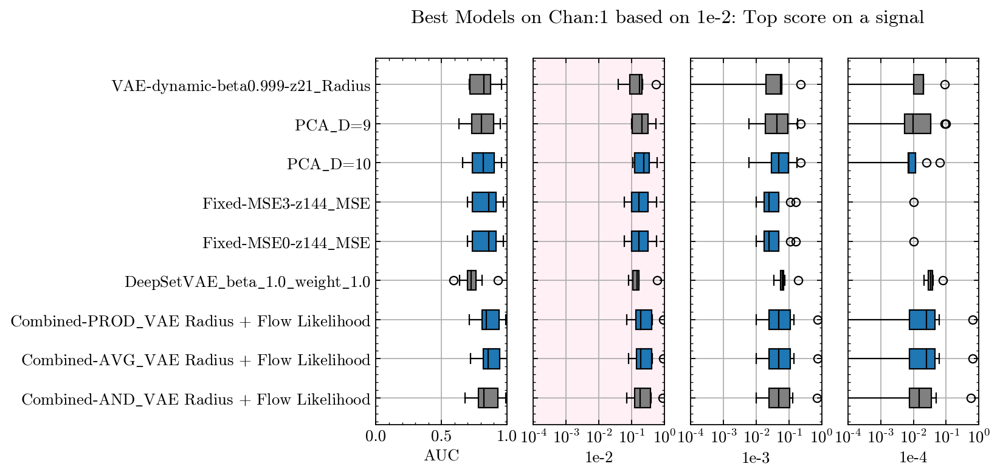

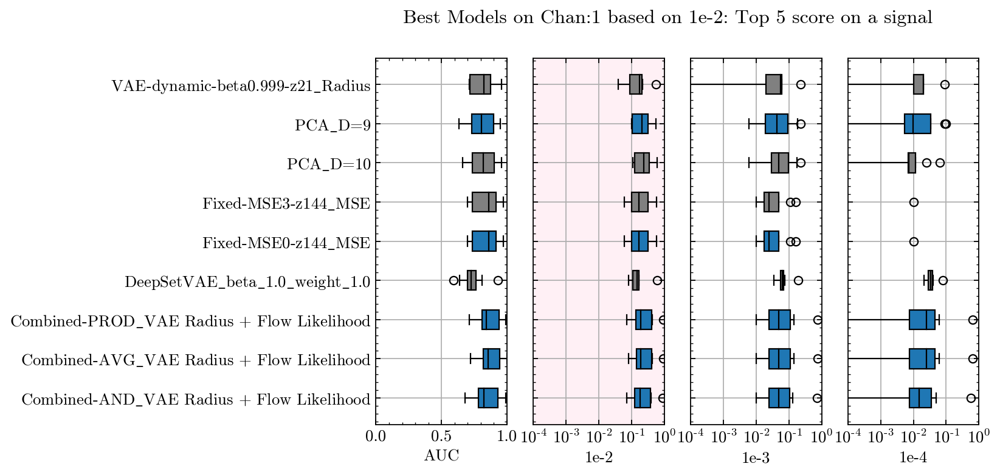

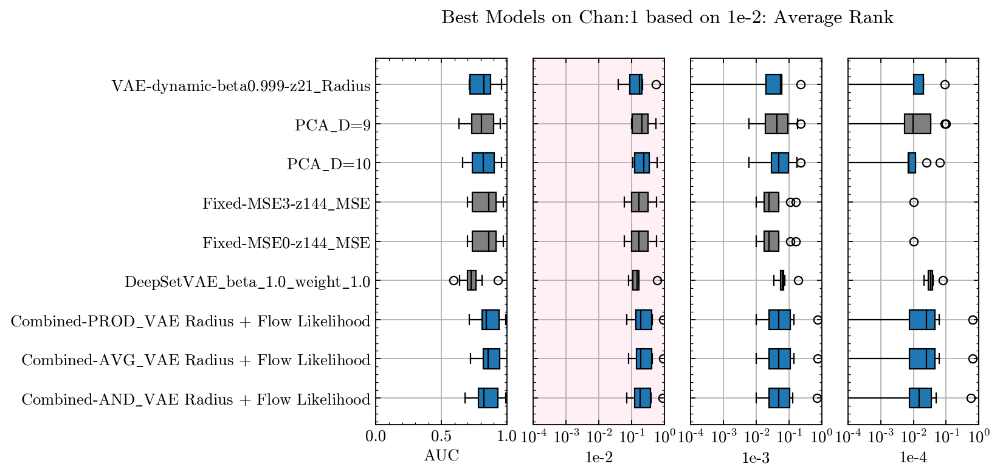

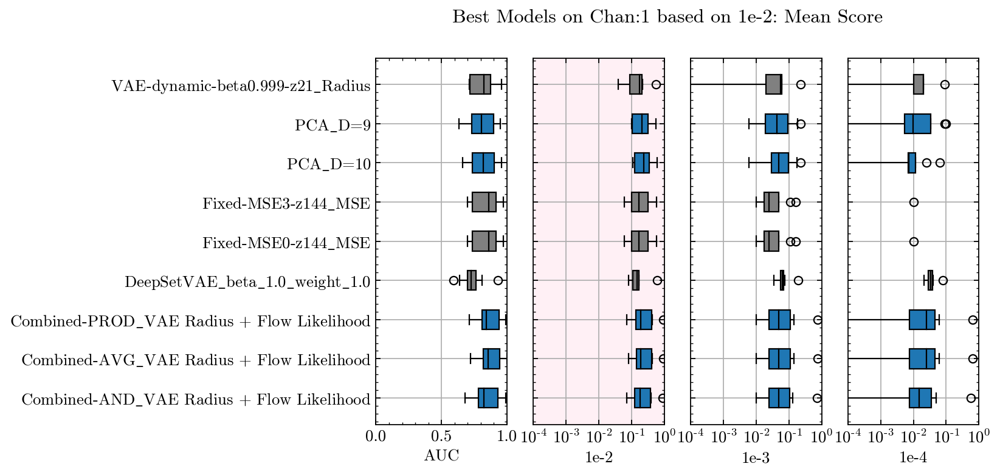

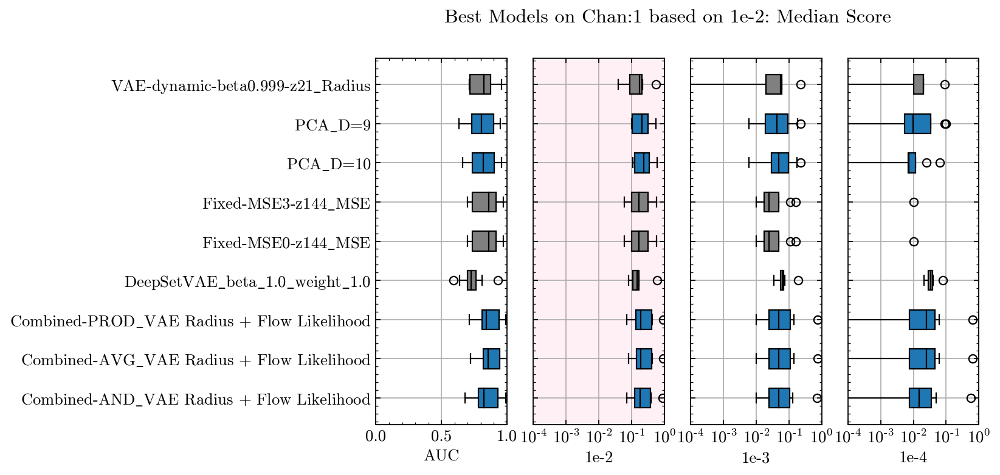

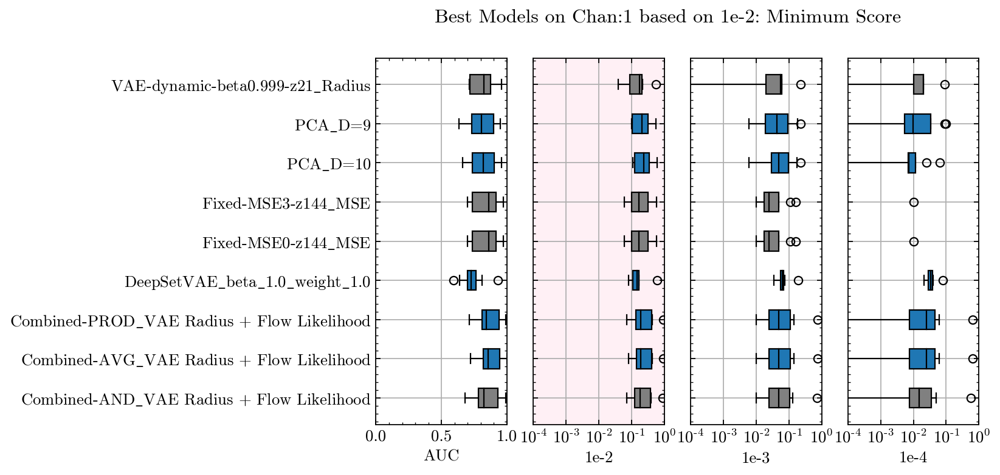

In [20]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 5,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

****************************************
Models from chan=1 ranked by metric=1e-3 sorted by top1
                                          Model  top1
550              DeepSetVAE_beta_1.0_weight_1.0     3
302                                     PCA_D=9     2
446            VAE-dynamic-beta0.999-z21_Radius     1
477   Combined-AVG_VAE Radius + Flow Likelihood     1
476  Combined-PROD_VAE Radius + Flow Likelihood     1
0                              IF_13_0.001_1000     0
****************************************

****************************************
Models from chan=1 ranked by metric=1e-3 sorted by top5
                                          Model  top5
550              DeepSetVAE_beta_1.0_weight_1.0     6
303                                    PCA_D=10     5
477   Combined-AVG_VAE Radius + Flow Likelihood     4
474   Combined-AND_VAE Radius + Flow Likelihood     4
476  Combined-PROD_VAE Radius + Flow Likelihood     4
302                                     PCA_D=9     3
450     

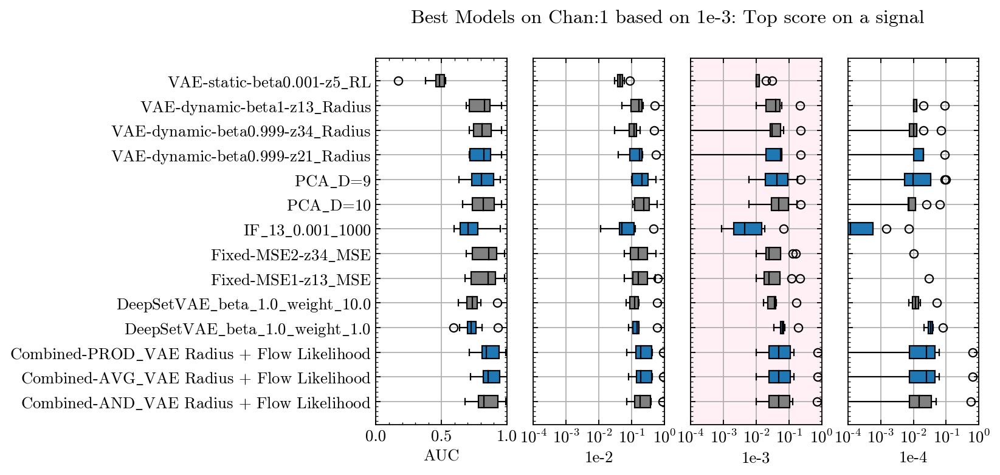

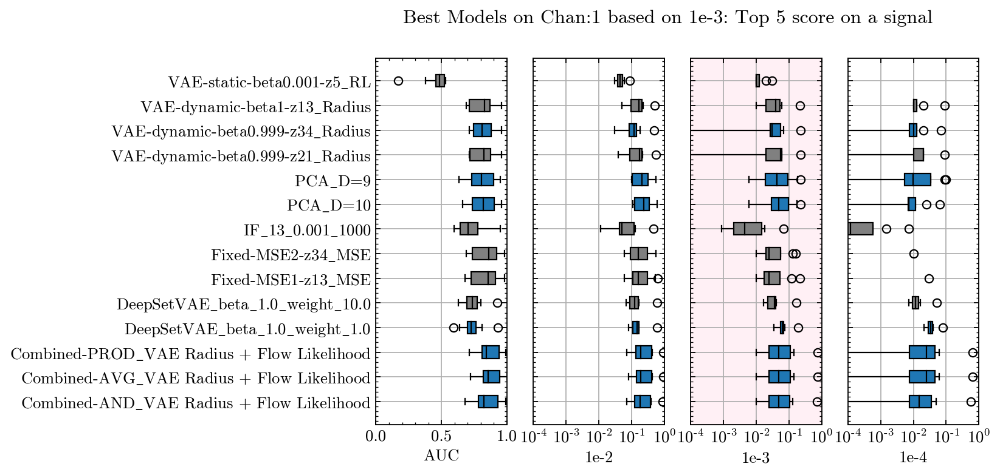

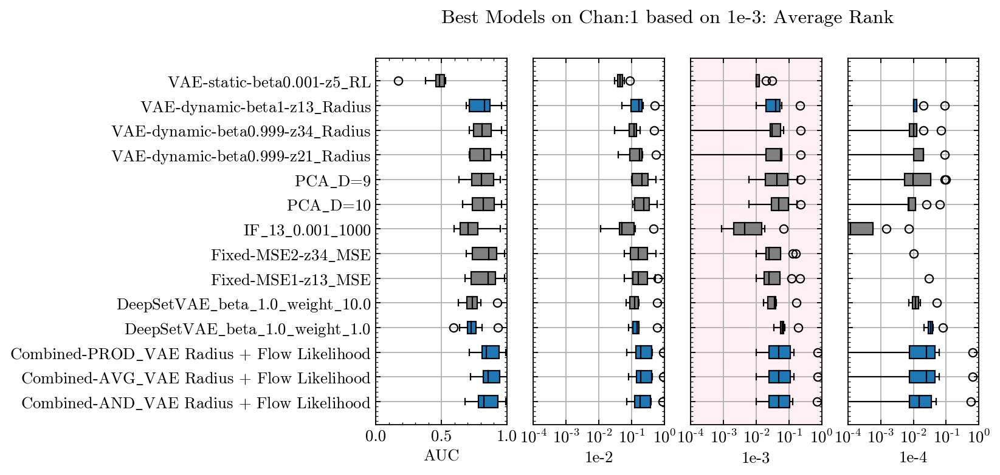

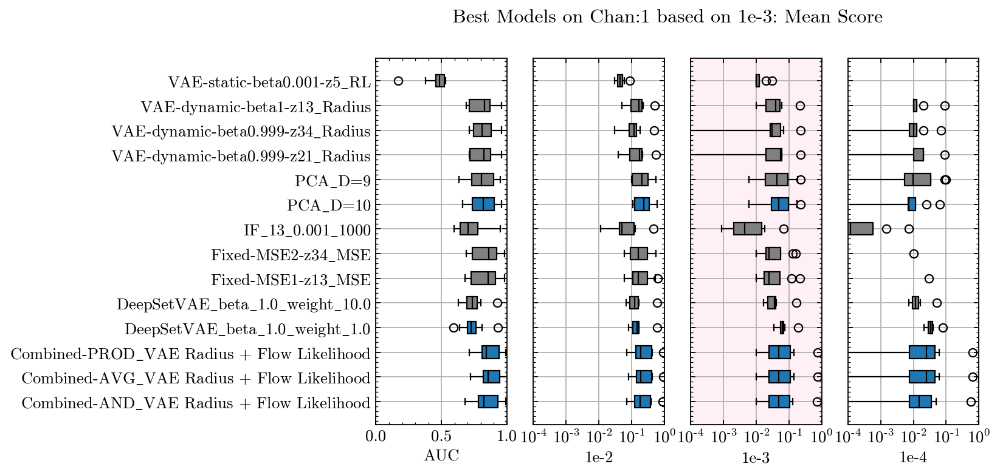

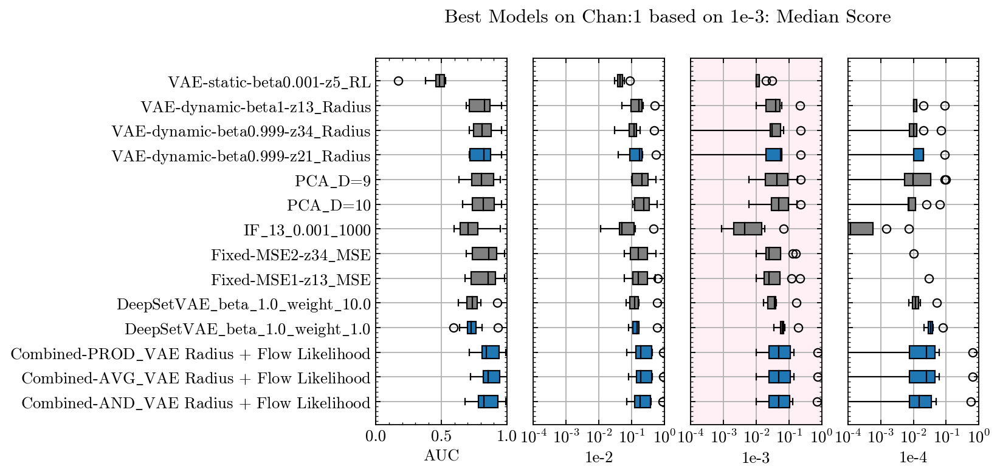

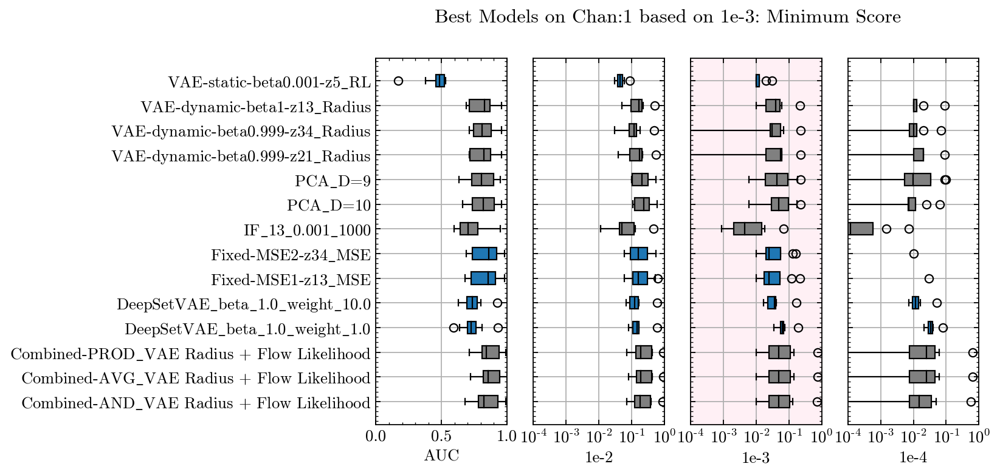

In [21]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 6,
                            'top5': 7,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-4

****************************************
Models from chan=1 ranked by metric=1e-4 sorted by top1
                                          Model  top1
550              DeepSetVAE_beta_1.0_weight_1.0     5
477   Combined-AVG_VAE Radius + Flow Likelihood     1
476  Combined-PROD_VAE Radius + Flow Likelihood     1
302                                     PCA_D=9     1
****************************************

****************************************
Models from chan=1 ranked by metric=1e-4 sorted by top5
                                          Model  top5
550              DeepSetVAE_beta_1.0_weight_1.0     6
477   Combined-AVG_VAE Radius + Flow Likelihood     5
476  Combined-PROD_VAE Radius + Flow Likelihood     5
300                                     PCA_D=7     3
474   Combined-AND_VAE Radius + Flow Likelihood     2
****************************************

****************************************
Models from chan=1 ranked by metric=1e-4 sorted by AverageRank
                        

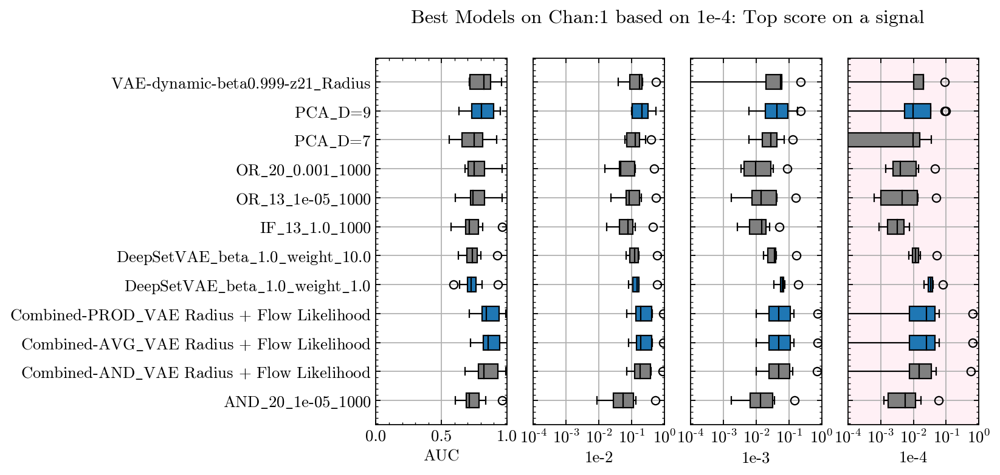

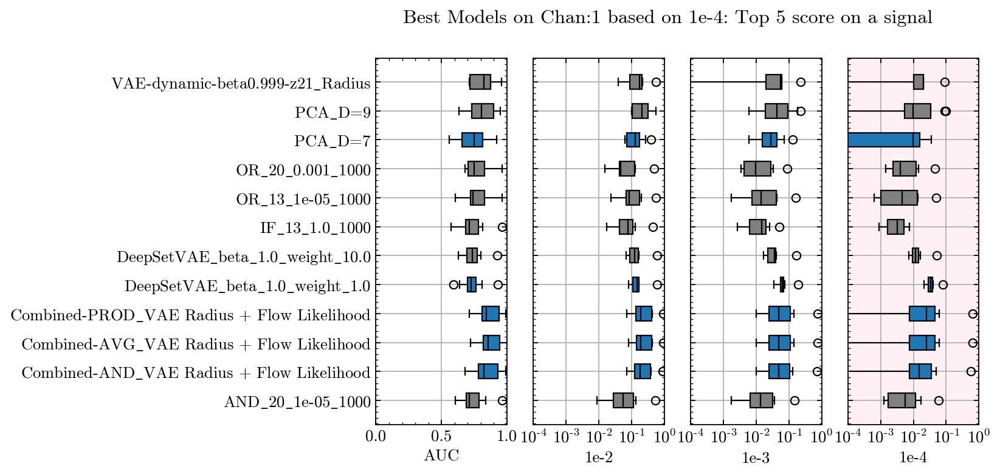

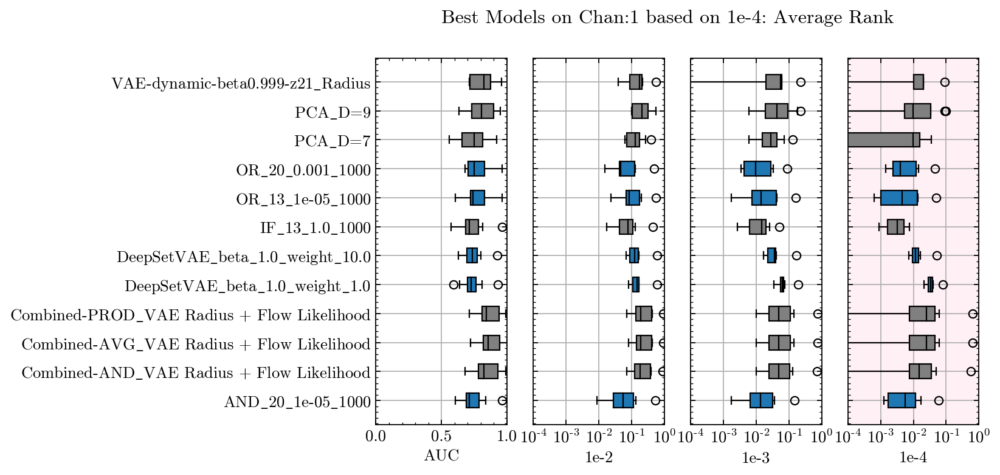

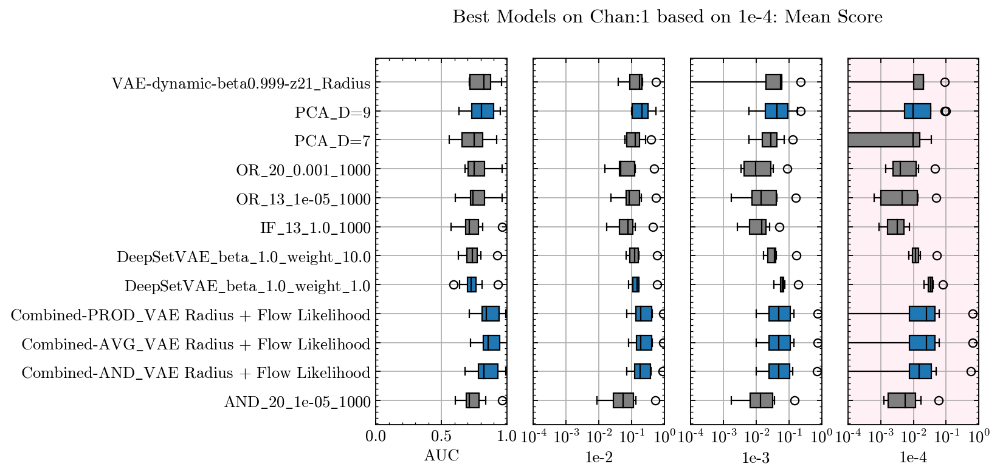

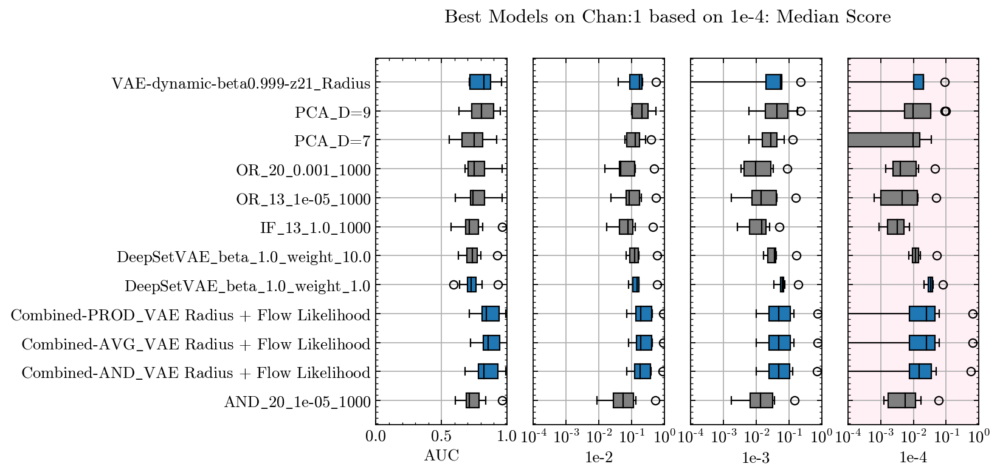

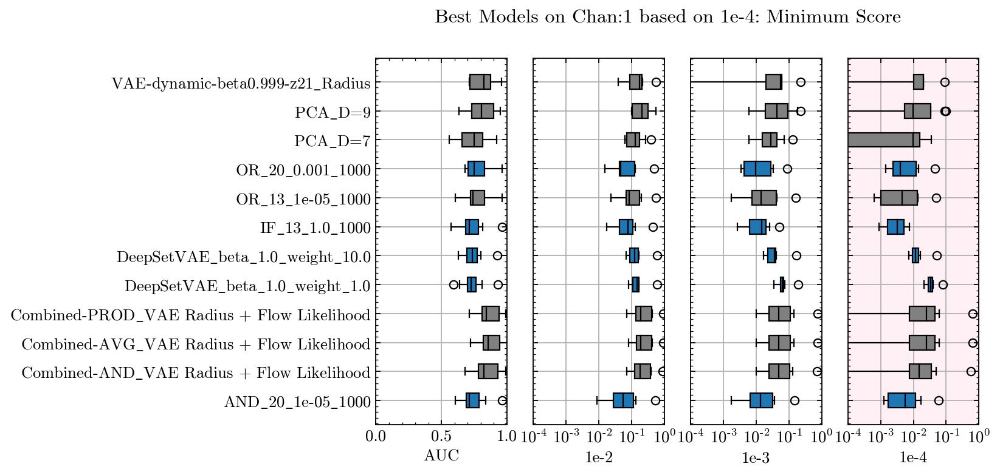

In [22]:
Analyze(AllCombined, 
        Chan='1', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 4,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

## Chan 2a
### AUC

****************************************
Models from chan=2a ranked by metric=AUC sorted by top1
                                         Model  top1
391                   VAE-static-beta0.5-z5_RL     2
291                          VAE_OrthogonalSNF     2
312                            VAE_b=1e-5_D=10     1
395                   VAE-static-beta0.5-z8_RL     1
474  Combined-AND_VAE Radius + Flow Likelihood     1
****************************************

****************************************
Models from chan=2a ranked by metric=AUC sorted by top5
                 Model  top5
291  VAE_OrthogonalSNF     5
293            VAE_IAF     4
292  VAE_TriangularSNF     4
****************************************

****************************************
Models from chan=2a ranked by metric=AUC sorted by AverageRank
                 Model  AverageRank
210    AND_30_0.1_1000    68.428571
216   AND_4_0.001_1000    73.285714
291  VAE_OrthogonalSNF    74.000000
293            VAE_IAF    76.285714
292 

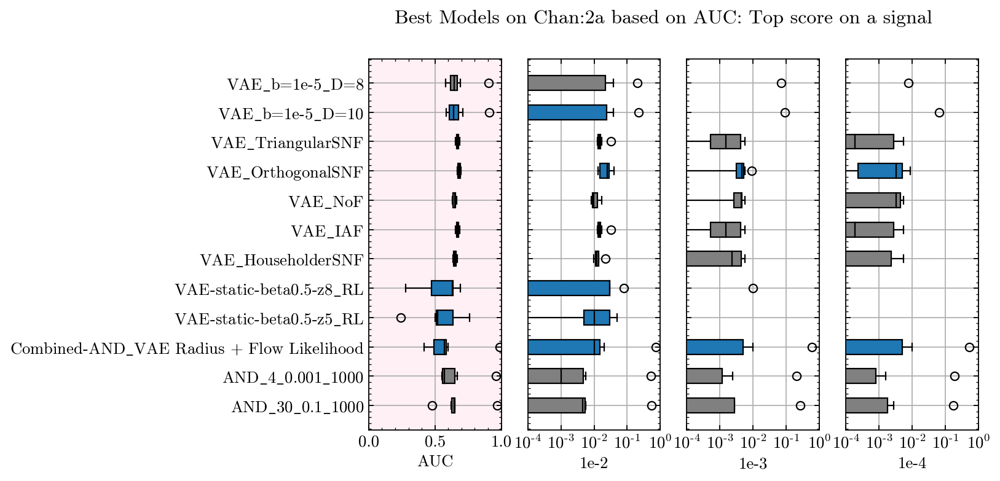

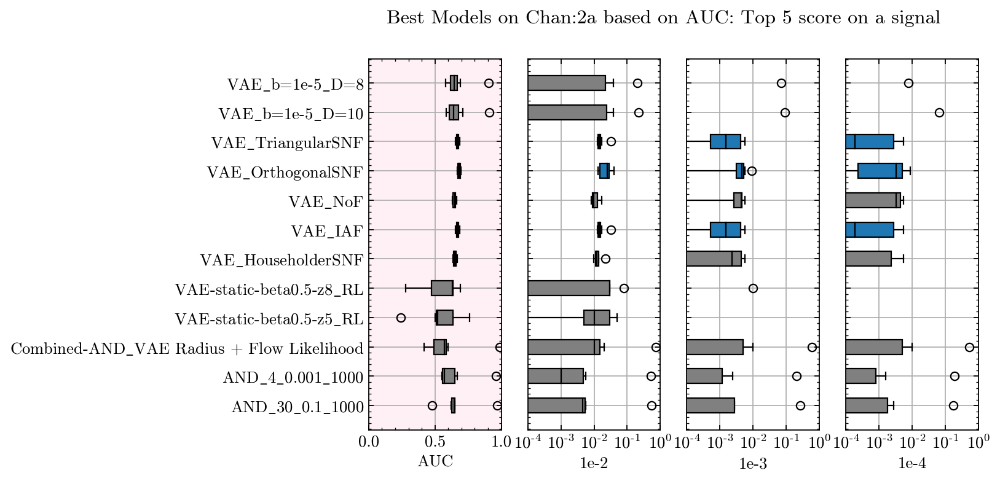

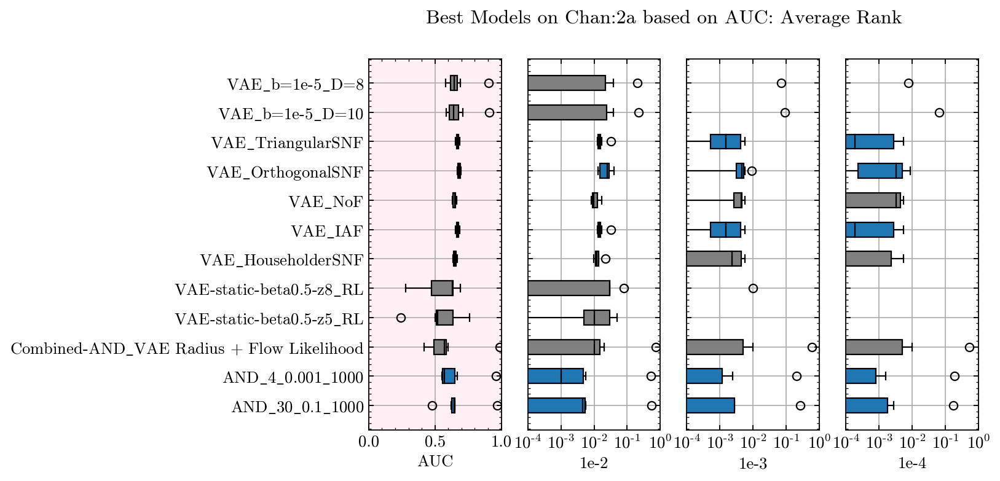

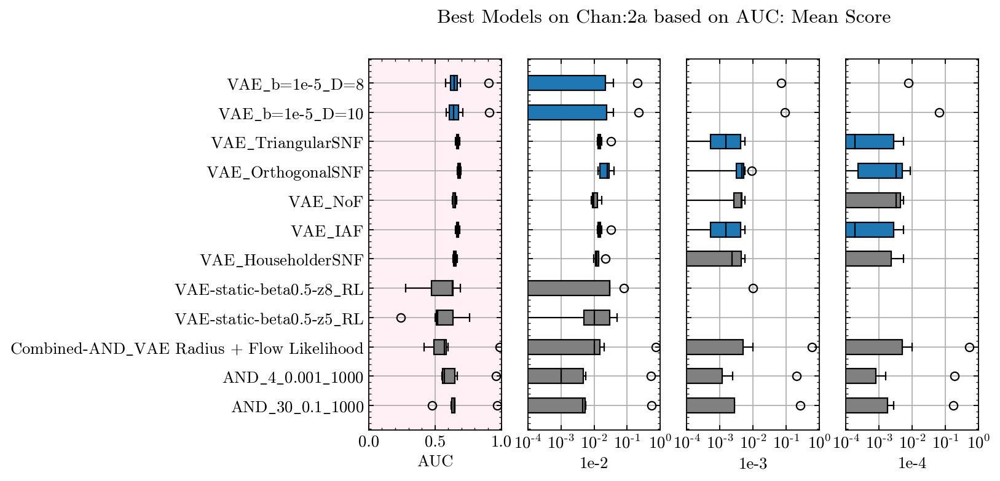

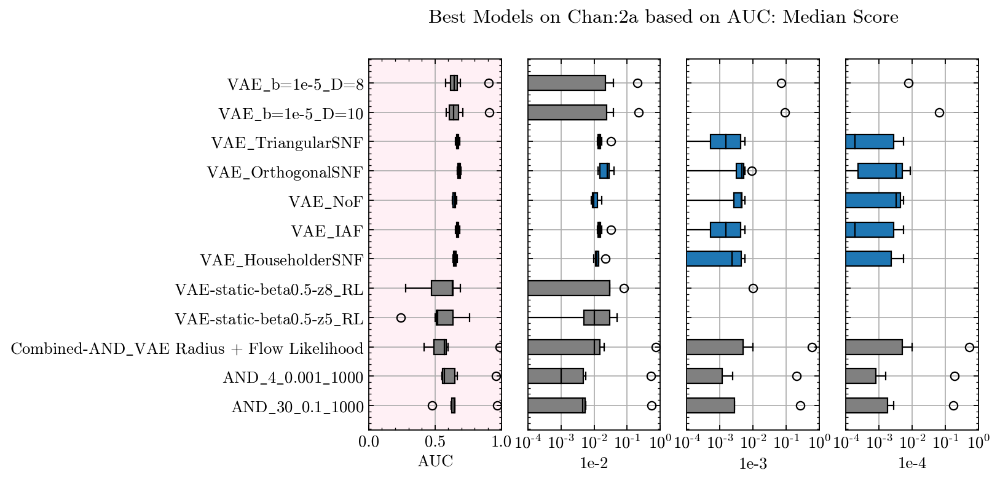

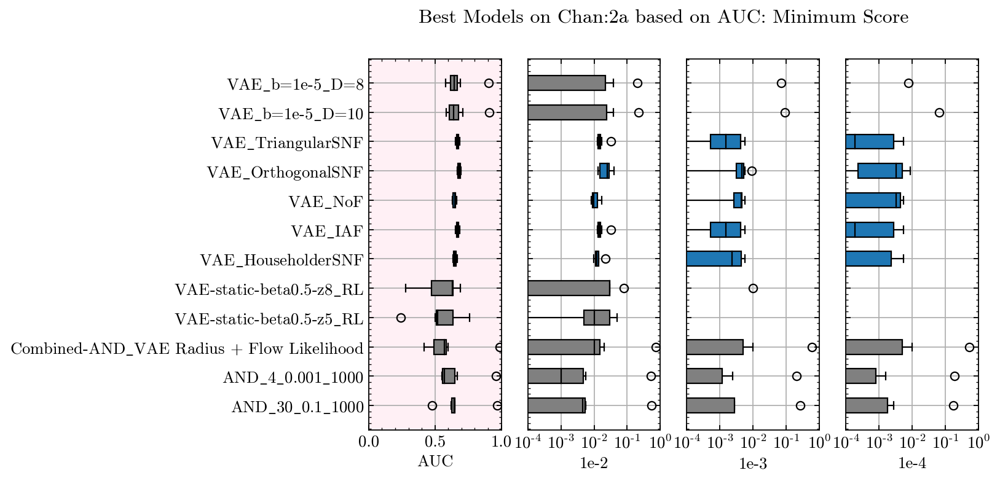

In [23]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='AUC',
        MetricNumberDict = {'top1': 5,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

****************************************
Models from chan=2a ranked by metric=1e-2 sorted by top1
                            Model  top1
484        Fixed-combined-z89_MSE     1
341  VAE-dynamic-beta1e-06-z13_RL     1
391      VAE-static-beta0.5-z5_RL     1
495           Fixed-MSE0-z233_MSE     1
28                  IF_4_1.0_1000     1
407     VAE-static-beta0.5-z34_RL     1
395      VAE-static-beta0.5-z8_RL     1
****************************************

****************************************
Models from chan=2a ranked by metric=1e-2 sorted by top5
                         Model  top5
531        Fixed-MSE4-z233_MSE     2
407  VAE-static-beta0.5-z34_RL     2
28               IF_4_1.0_1000     2
****************************************

****************************************
Models from chan=2a ranked by metric=1e-2 sorted by AverageRank
                     Model  AverageRank
487      Fixed-MSE0-z5_MSE    64.285714
478  Fixed-combined-z5_MSE    67.714286
496      Fixed-MSE1-z5_MSE 

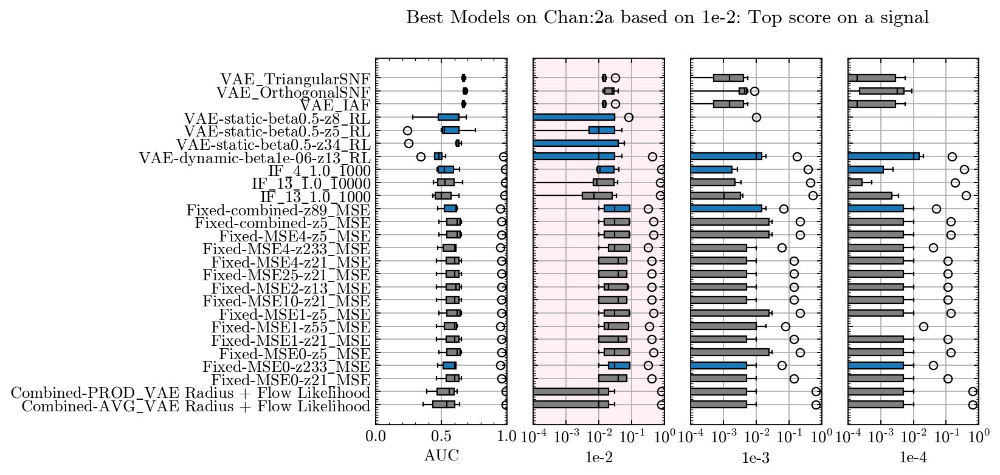

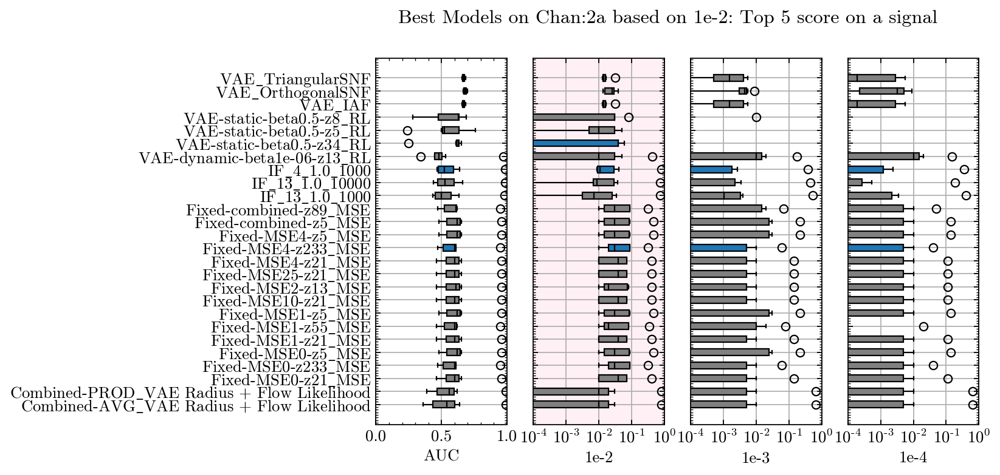

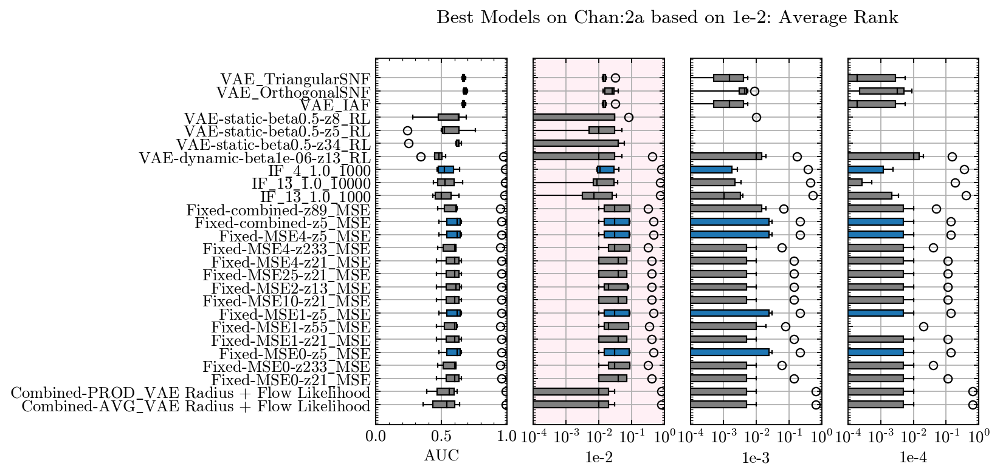

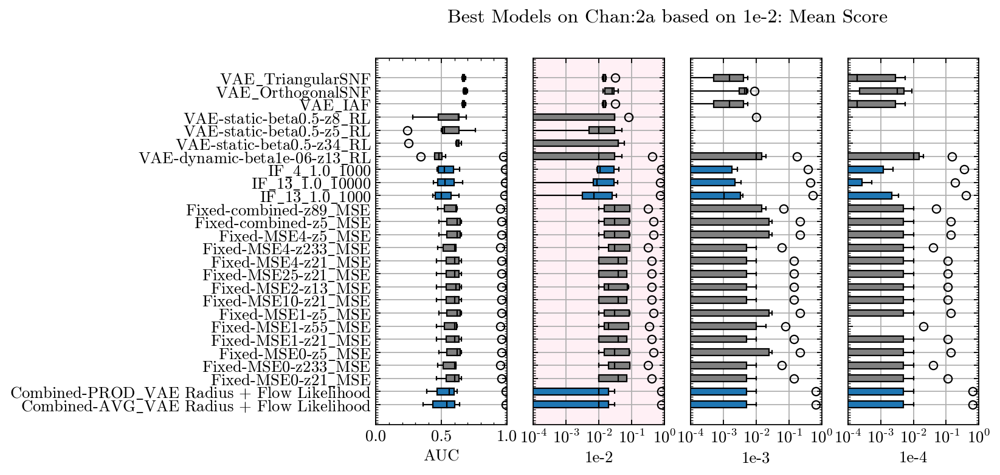

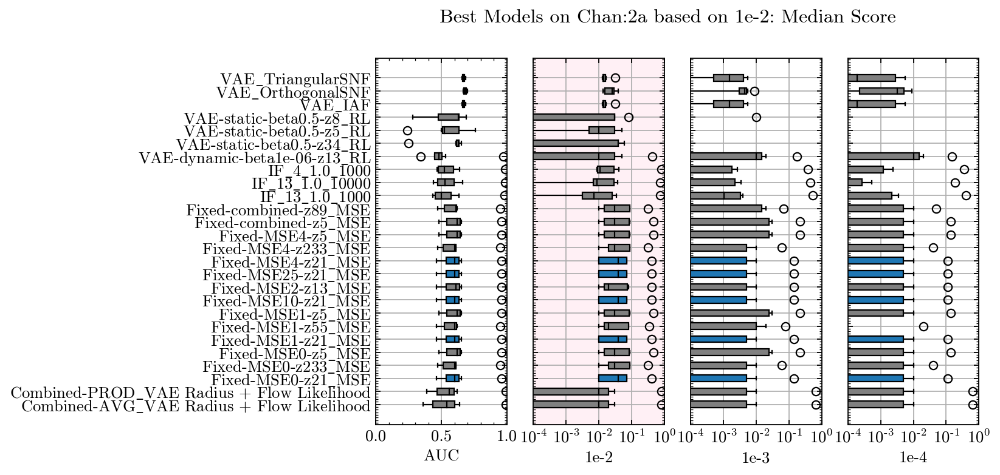

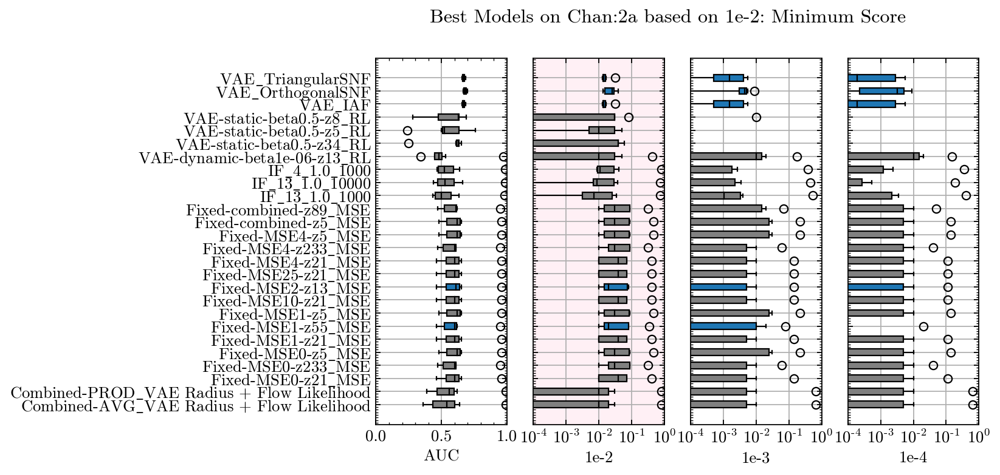

In [24]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 7,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

****************************************
Models from chan=2a ranked by metric=1e-3 sorted by top1
                                         Model  top1
345               VAE-dynamic-beta1e-06-z21_RL     1
324                             VAE_b=1e-1_D=4     1
298                                    PCA_D=5     1
505                          Fixed-MSE2-z5_MSE     1
427                  VAE-static-beta0.8-z34_RL     1
500                         Fixed-MSE1-z34_MSE     1
477  Combined-AVG_VAE Radius + Flow Likelihood     1
****************************************

****************************************
Models from chan=2a ranked by metric=1e-3 sorted by top5
                            Model  top5
291             VAE_OrthogonalSNF     2
298                       PCA_D=5     2
478         Fixed-combined-z5_MSE     2
345  VAE-dynamic-beta1e-06-z21_RL     2
341  VAE-dynamic-beta1e-06-z13_RL     2
289                VAE_PlanarFlow     2
514             Fixed-MSE3-z5_MSE     1
387     VAE-static

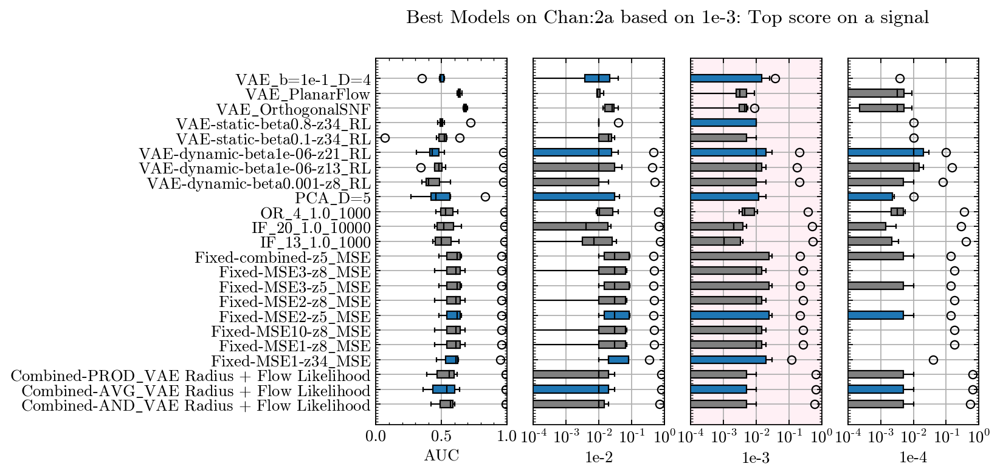

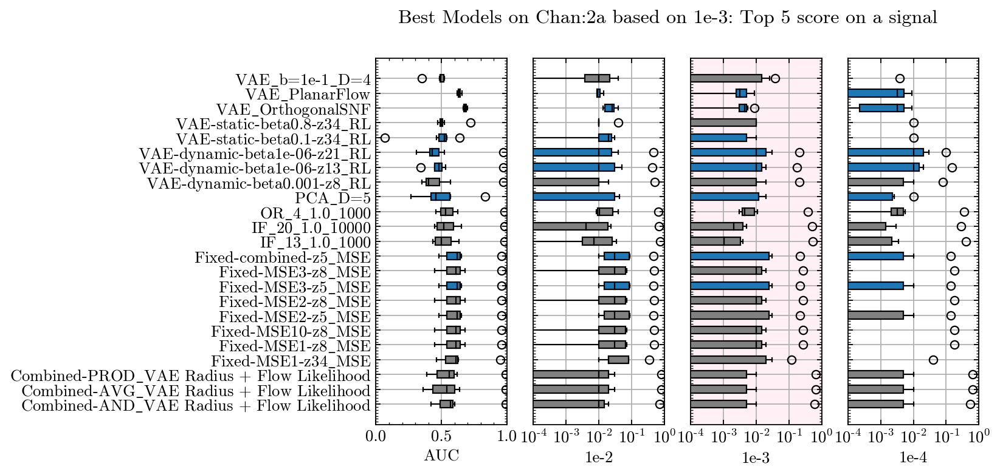

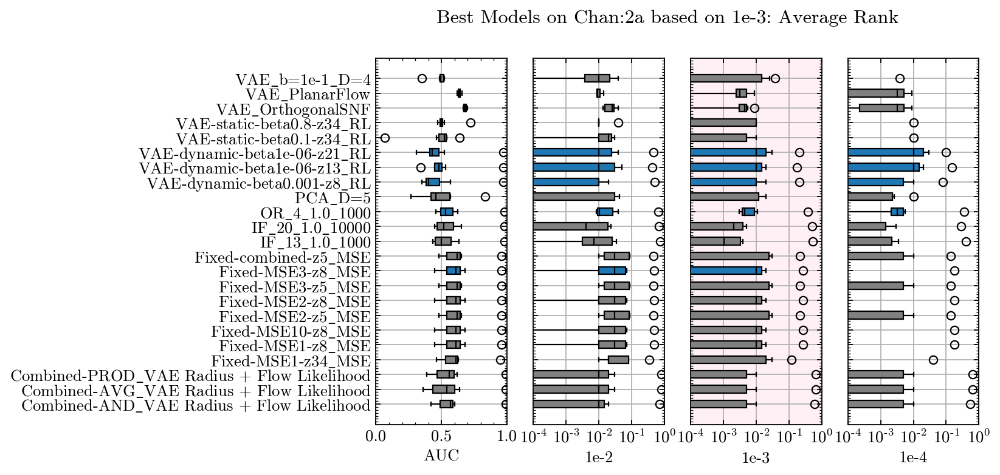

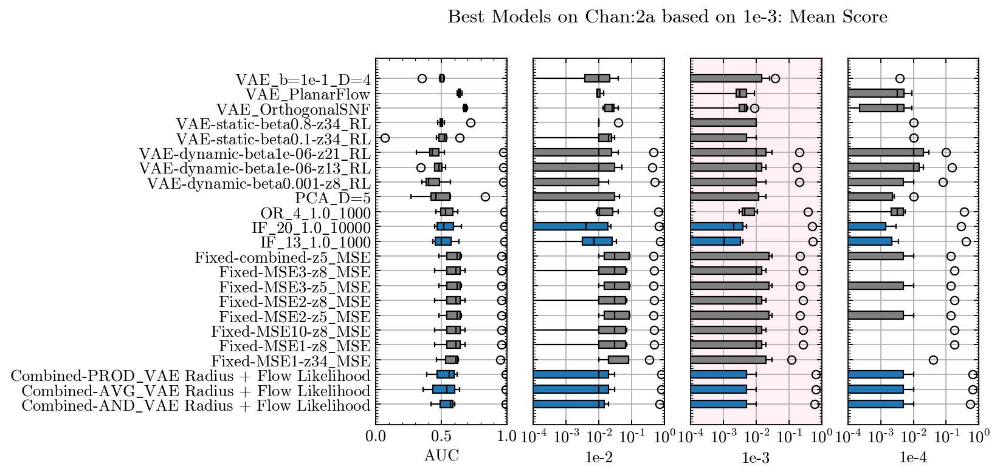

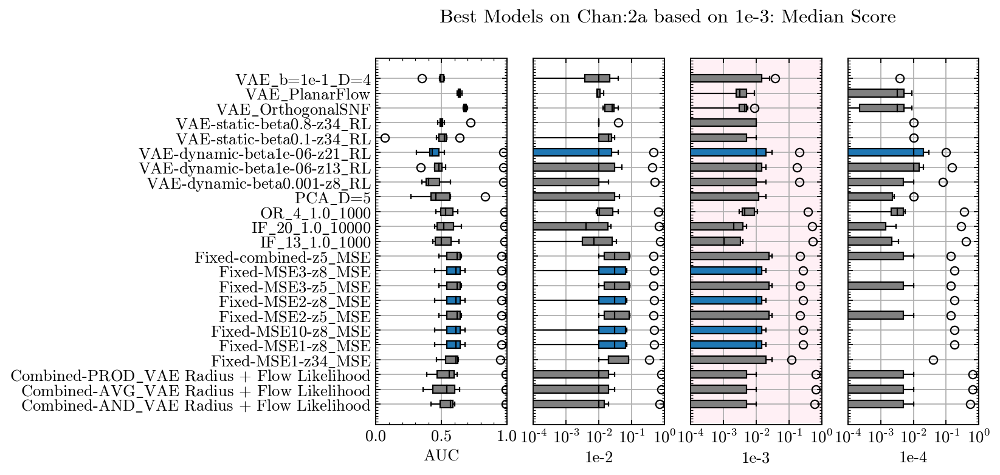

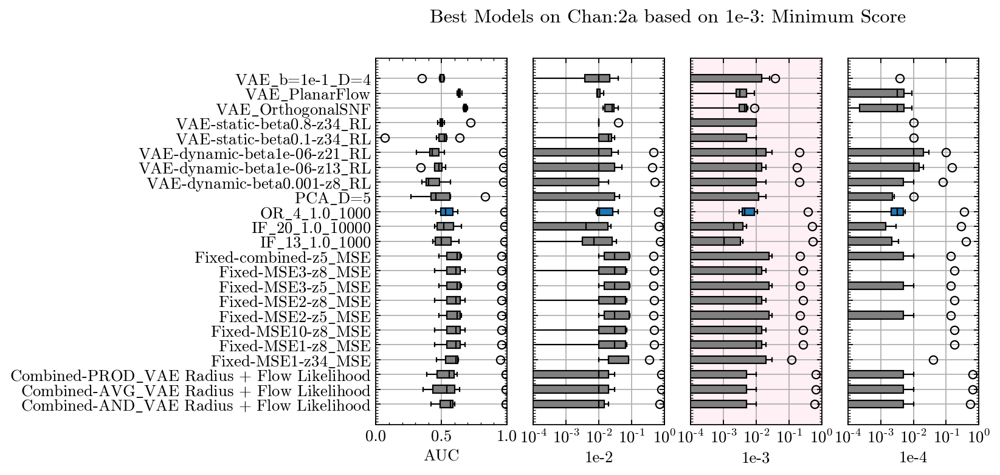

In [25]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 7,
                            'top5': 8,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 1},
        Plot=True
       )

### 1e-4

****************************************
Models from chan=2a ranked by metric=1e-4 sorted by top1
                                          Model  top1
387                   VAE-static-beta0.1-z34_RL     1
300                                     PCA_D=7     1
345                VAE-dynamic-beta1e-06-z21_RL     1
293                                     VAE_IAF     1
476  Combined-PROD_VAE Radius + Flow Likelihood     1
496                           Fixed-MSE1-z5_MSE     1
439                 VAE-static-beta0.999-z13_RL     1
****************************************

****************************************
Models from chan=2a ranked by metric=1e-4 sorted by top5
                                          Model  top5
345                VAE-dynamic-beta1e-06-z21_RL     3
291                           VAE_OrthogonalSNF     3
289                              VAE_PlanarFlow     3
476  Combined-PROD_VAE Radius + Flow Likelihood     2
477   Combined-AVG_VAE Radius + Flow Likelihood     2
341   

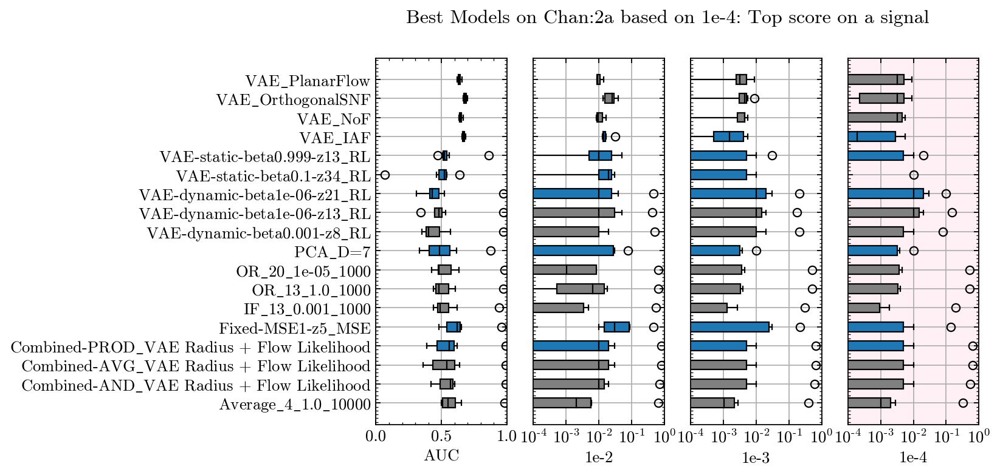

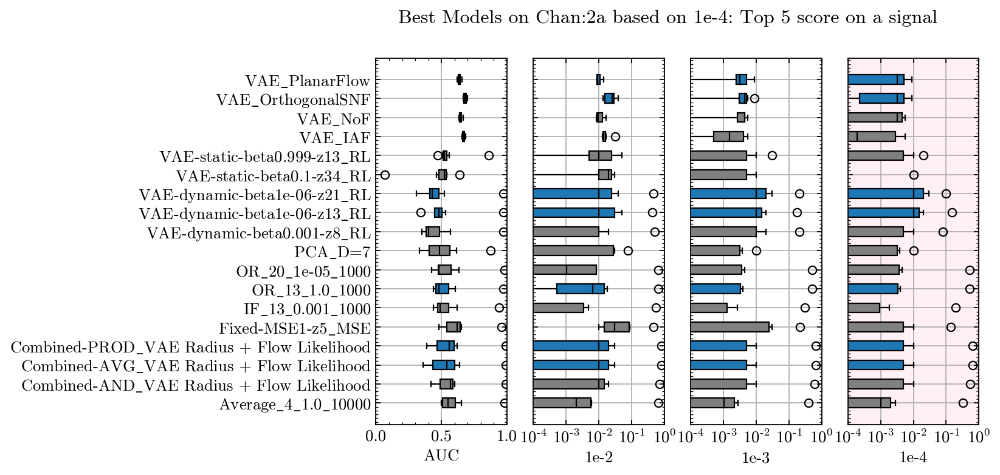

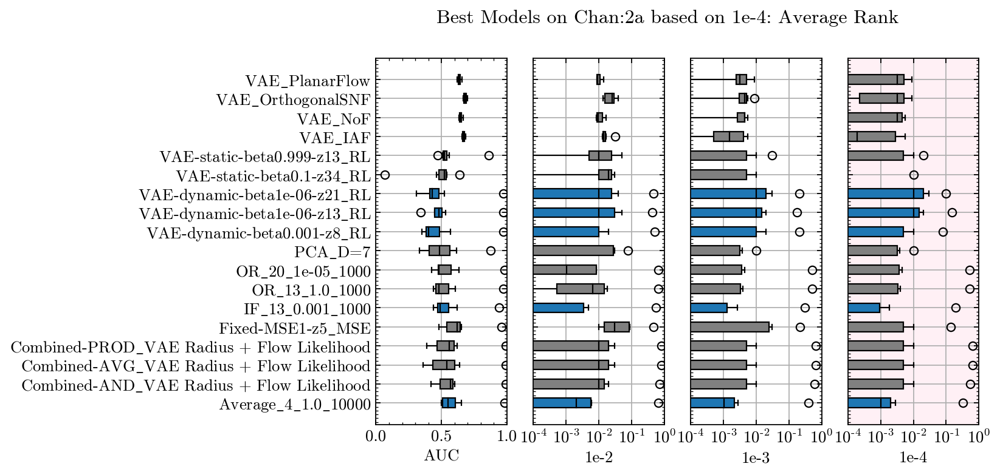

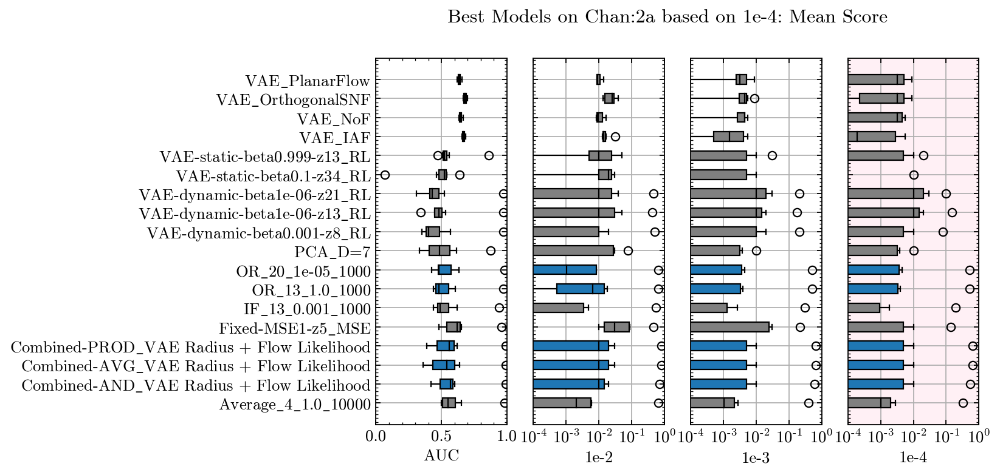

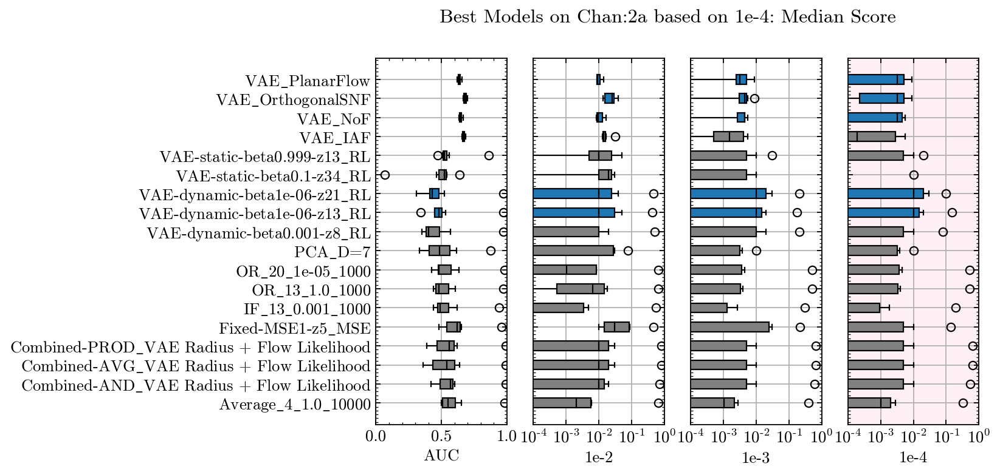

In [26]:
Analyze(AllCombined, 
        Chan='2a', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 7,
                            'top5': 7,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 0},
        Plot=True
       )

## Chan 2b
### AUC

****************************************
Models from chan=2b ranked by metric=AUC sorted by top1
                                          Model  top1
291                           VAE_OrthogonalSNF     3
477   Combined-AVG_VAE Radius + Flow Likelihood     2
476  Combined-PROD_VAE Radius + Flow Likelihood     2
511                          Fixed-MSE2-z89_MSE     1
475    Combined-OR_VAE Radius + Flow Likelihood     1
****************************************

****************************************
Models from chan=2b ranked by metric=AUC sorted by top5
                                          Model  top5
291                           VAE_OrthogonalSNF     5
475    Combined-OR_VAE Radius + Flow Likelihood     5
476  Combined-PROD_VAE Radius + Flow Likelihood     4
477   Combined-AVG_VAE Radius + Flow Likelihood     4
293                                     VAE_IAF     4
292                           VAE_TriangularSNF     4
474   Combined-AND_VAE Radius + Flow Likelihood     4
472     

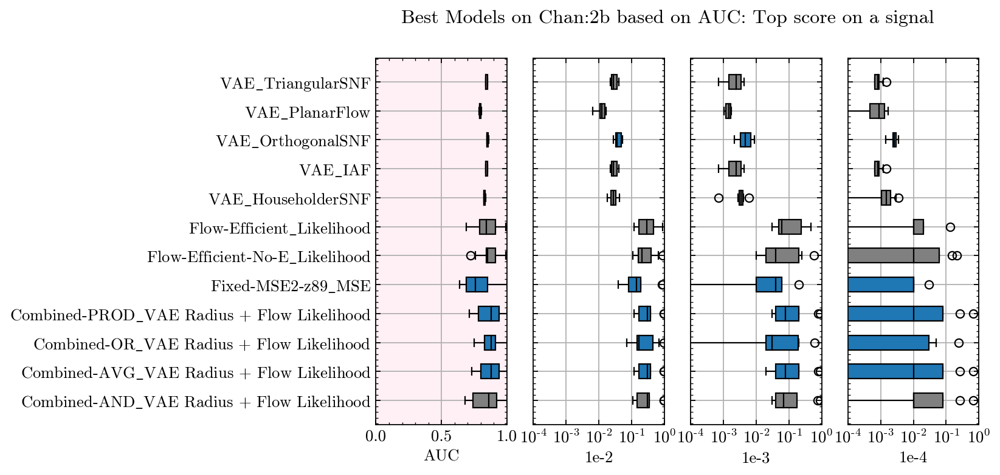

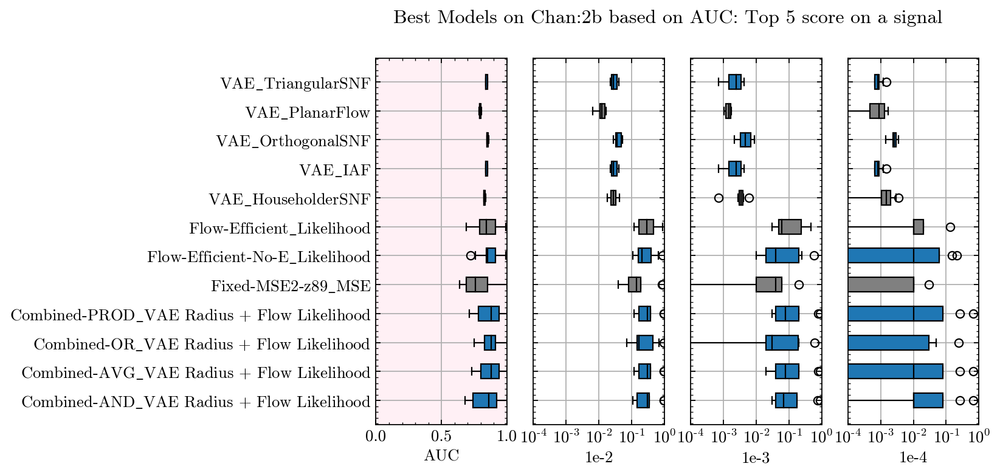

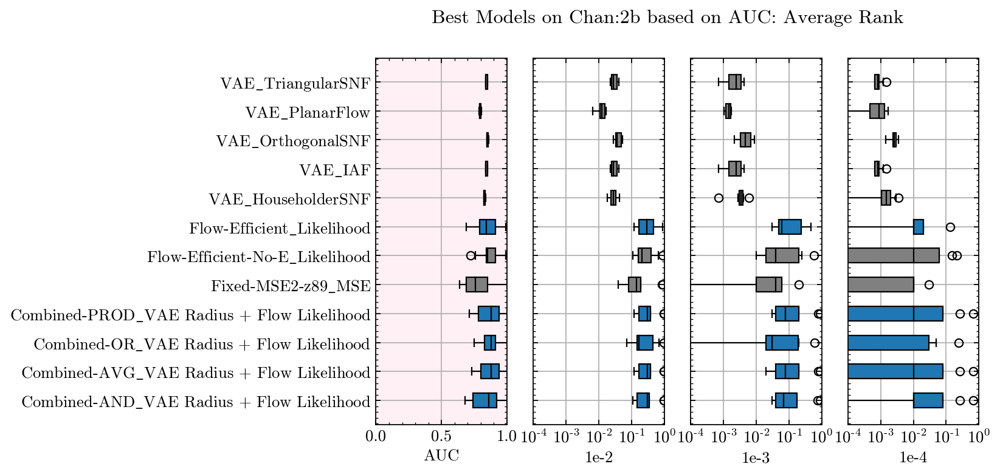

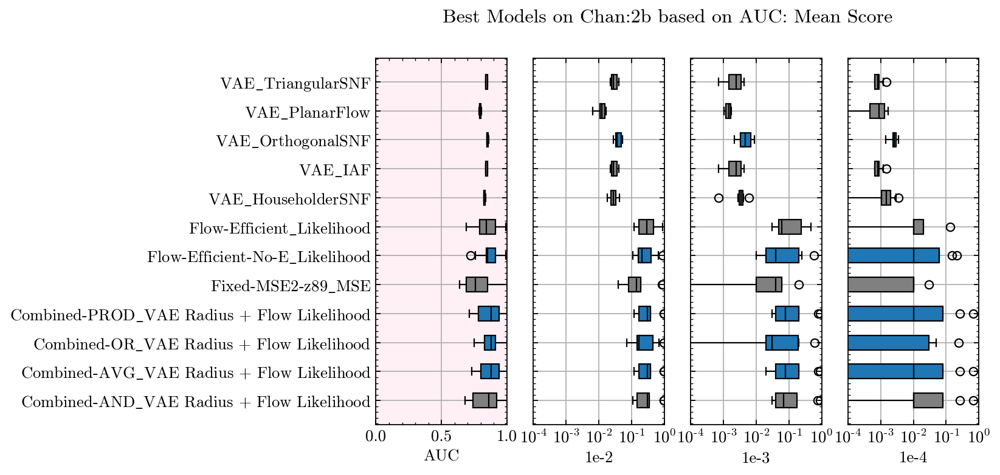

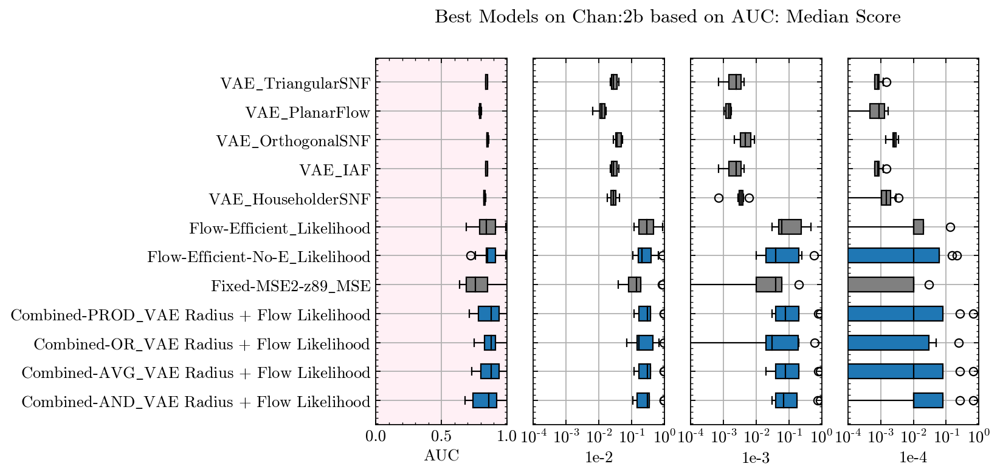

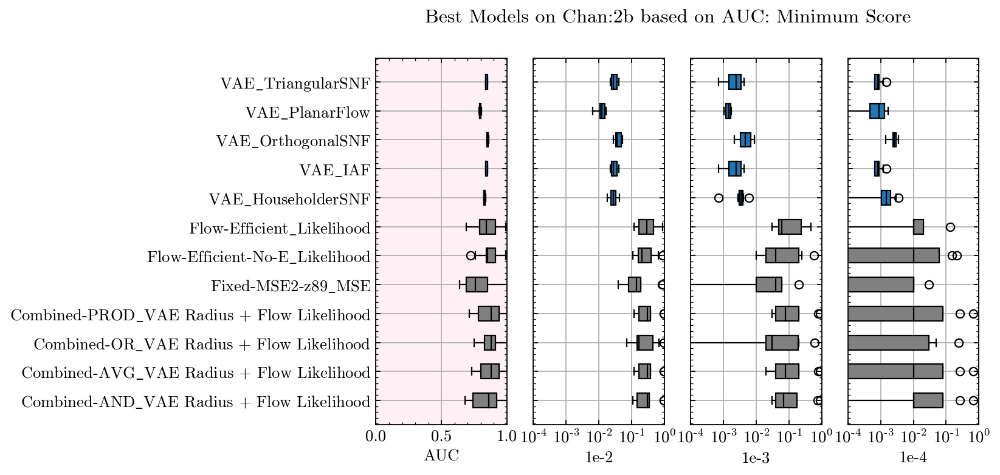

In [27]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='AUC',
        MetricNumberDict = {'top1': 5,
                            'top5': 8,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

****************************************
Models from chan=2b ranked by metric=1e-2 sorted by top1
                                          Model  top1
476  Combined-PROD_VAE Radius + Flow Likelihood     4
177                           OR_30_0.001_10000     2
477   Combined-AVG_VAE Radius + Flow Likelihood     1
471                   Flow-Efficient_Likelihood     1
10                               IF_20_0.1_1000     1
****************************************

****************************************
Models from chan=2b ranked by metric=1e-2 sorted by top5
                                          Model  top5
477   Combined-AVG_VAE Radius + Flow Likelihood     5
476  Combined-PROD_VAE Radius + Flow Likelihood     5
474   Combined-AND_VAE Radius + Flow Likelihood     5
471                   Flow-Efficient_Likelihood     5
472              Flow-Efficient-No-E_Likelihood     4
104                        KMeans_20_0.001_1000     3
****************************************

******************

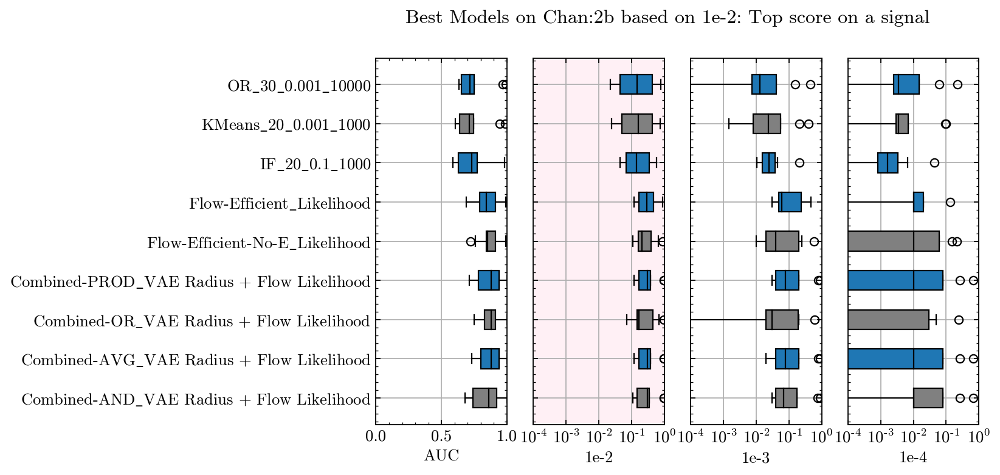

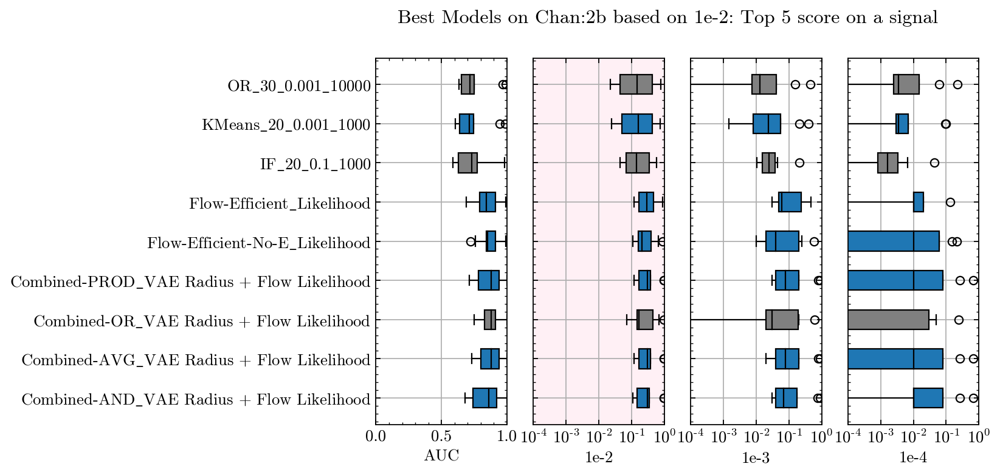

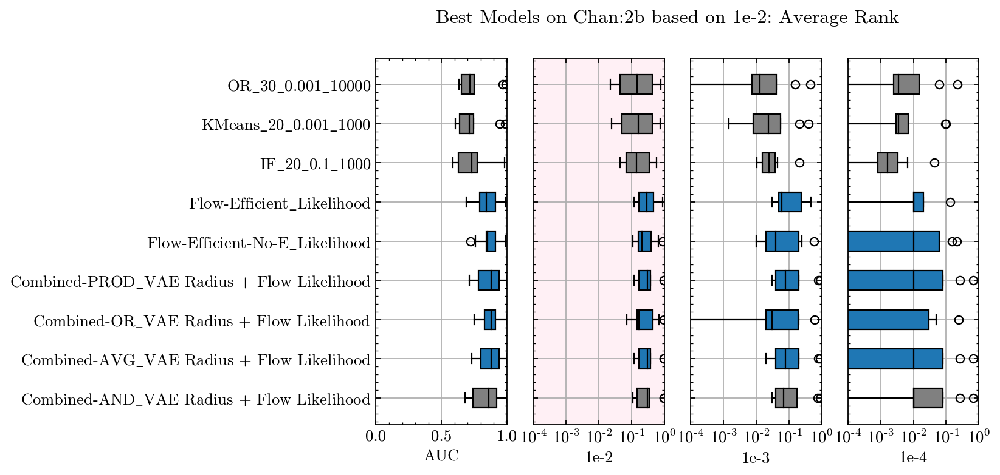

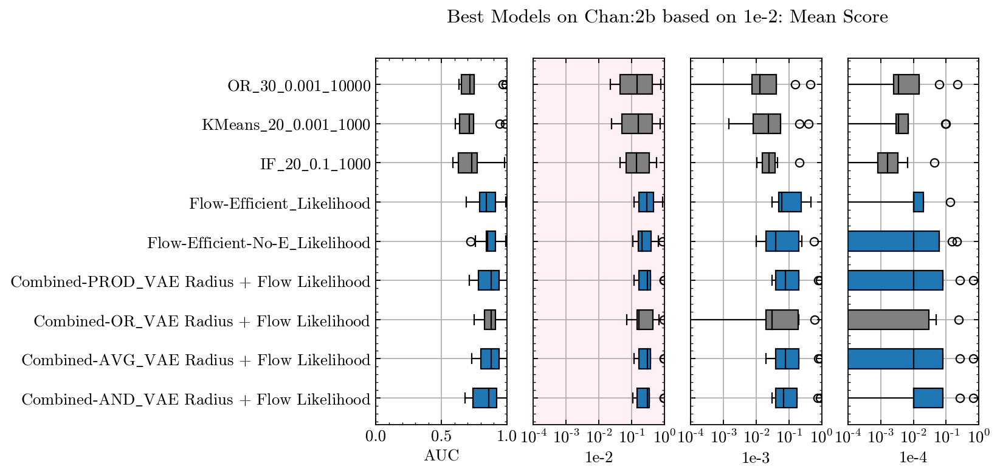

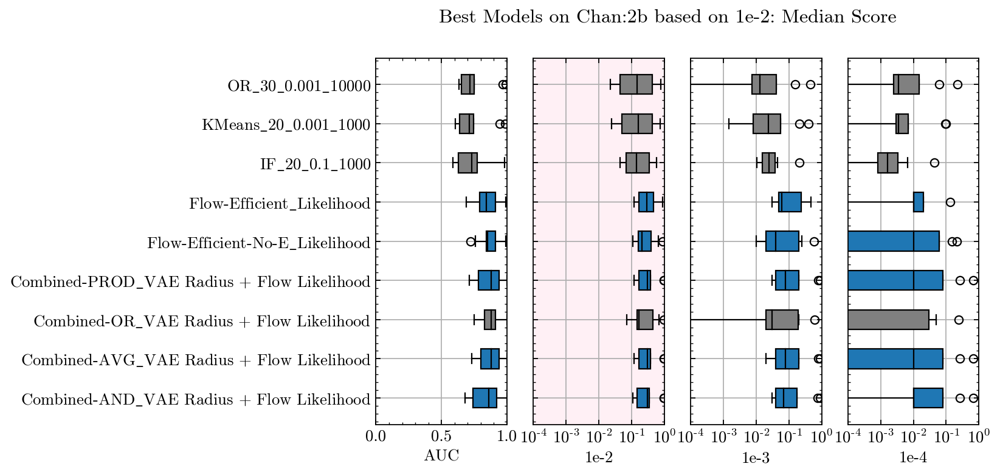

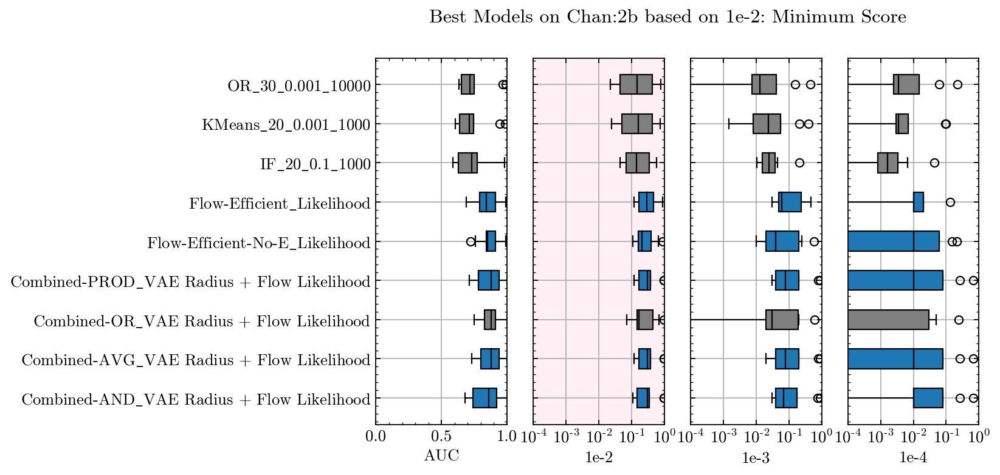

In [28]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 5,
                            'top5': 6,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

****************************************
Models from chan=2b ranked by metric=1e-3 sorted by top1
                                          Model  top1
551             DeepSetVAE_beta_1.0_weight_10.0     2
341                VAE-dynamic-beta1e-06-z13_RL     2
476  Combined-PROD_VAE Radius + Flow Likelihood     2
353                 VAE-dynamic-beta0.001-z5_RL     1
477   Combined-AVG_VAE Radius + Flow Likelihood     1
****************************************

****************************************
Models from chan=2b ranked by metric=1e-3 sorted by top5
                                          Model  top5
474   Combined-AND_VAE Radius + Flow Likelihood     5
476  Combined-PROD_VAE Radius + Flow Likelihood     5
477   Combined-AVG_VAE Radius + Flow Likelihood     4
551             DeepSetVAE_beta_1.0_weight_10.0     4
341                VAE-dynamic-beta1e-06-z13_RL     3
****************************************

****************************************
Models from chan=2b ranked by m

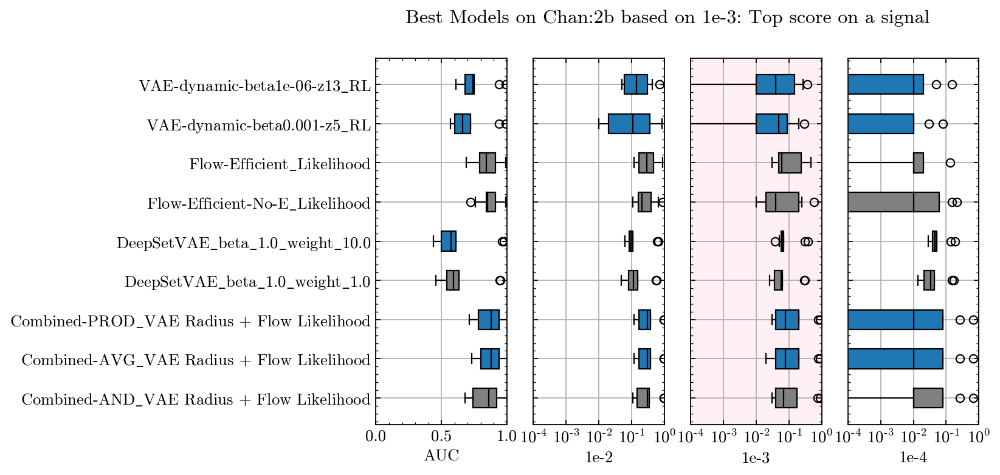

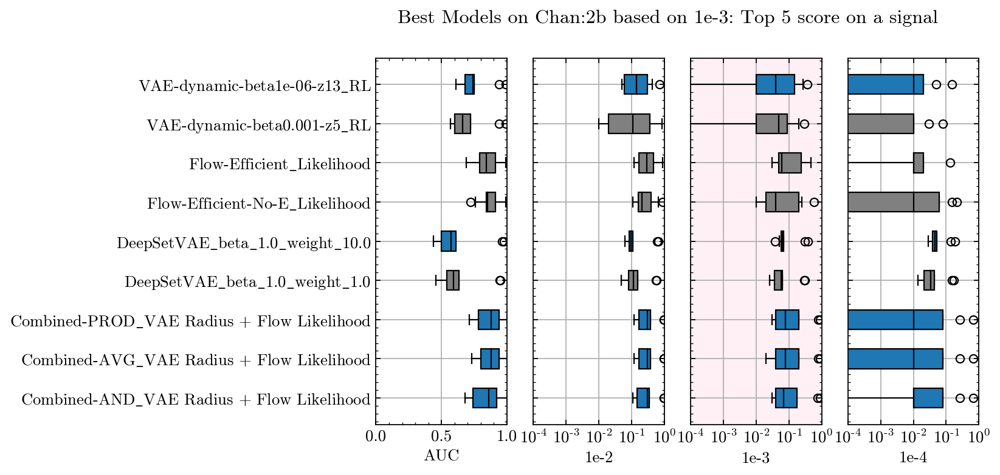

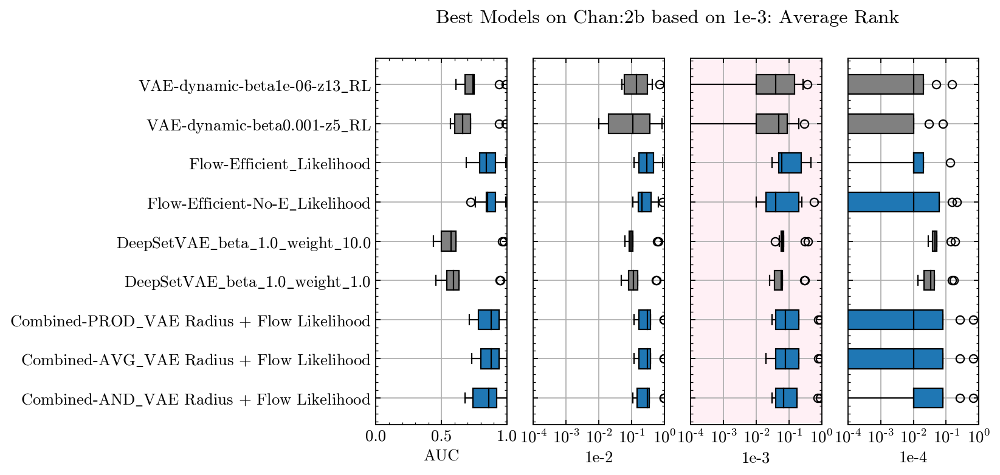

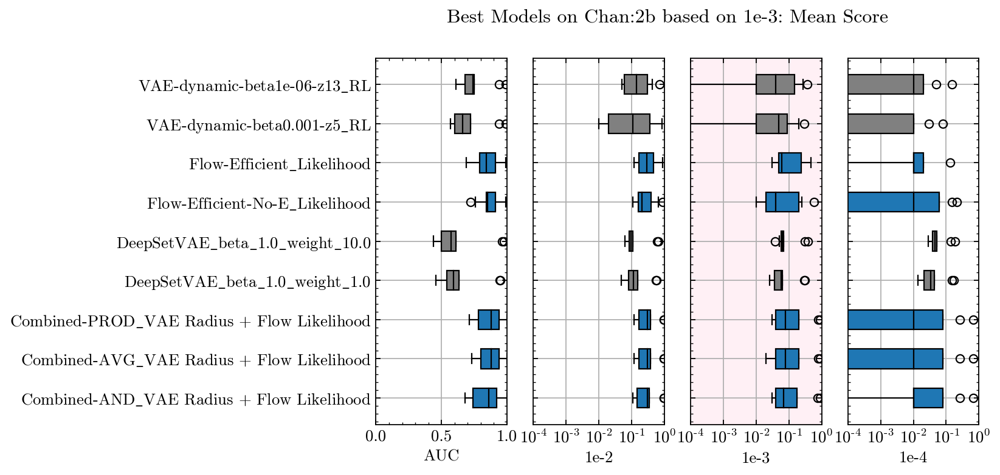

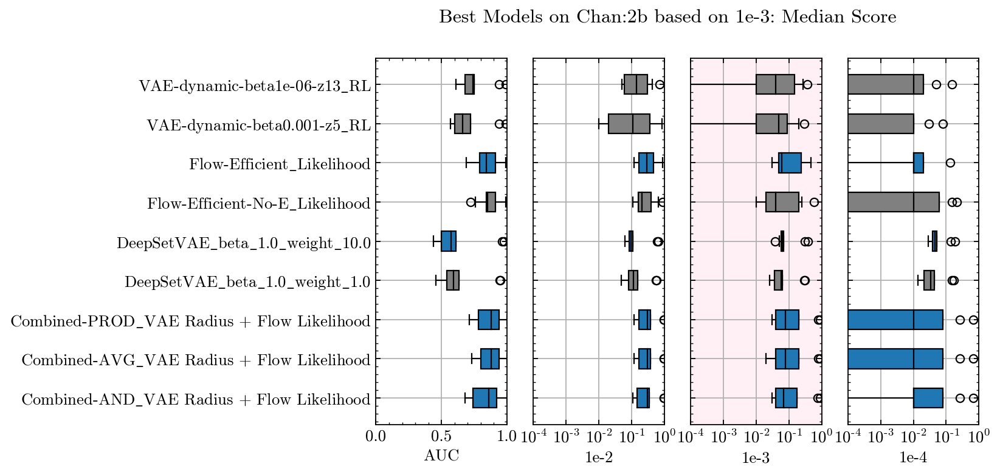

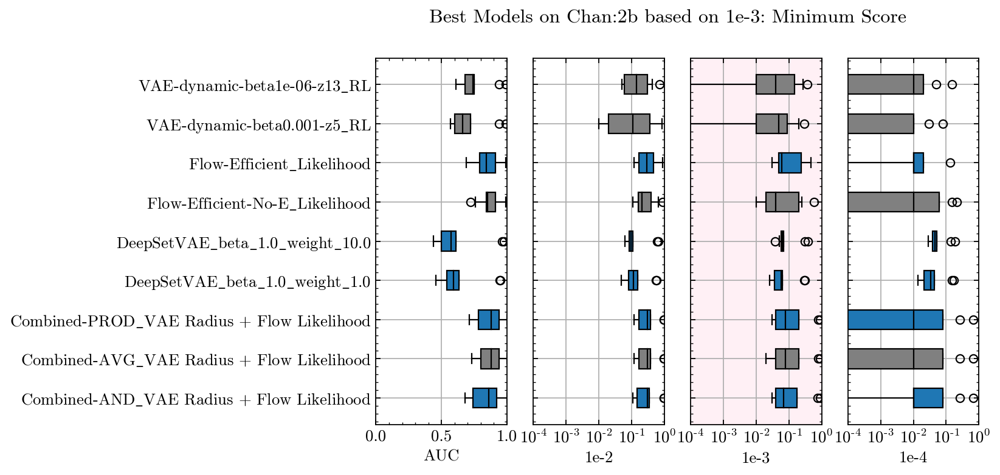

In [29]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 5,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-4

****************************************
Models from chan=2b ranked by metric=1e-4 sorted by top1
                                         Model  top1
551            DeepSetVAE_beta_1.0_weight_10.0     6
380              VAE-static-beta0.1-z13_Radius     1
299                                    PCA_D=6     1
477  Combined-AVG_VAE Radius + Flow Likelihood     1
****************************************

****************************************
Models from chan=2b ranked by metric=1e-4 sorted by top5
                               Model  top5
551  DeepSetVAE_beta_1.0_weight_10.0     6
550   DeepSetVAE_beta_1.0_weight_1.0     5
****************************************

****************************************
Models from chan=2b ranked by metric=1e-4 sorted by AverageRank
                               Model  AverageRank
158                 VAE_4_1e-05_1000    13.555556
190                  OR_4_1e-05_1000    16.111111
551  DeepSetVAE_beta_1.0_weight_10.0    29.777778
174                 O

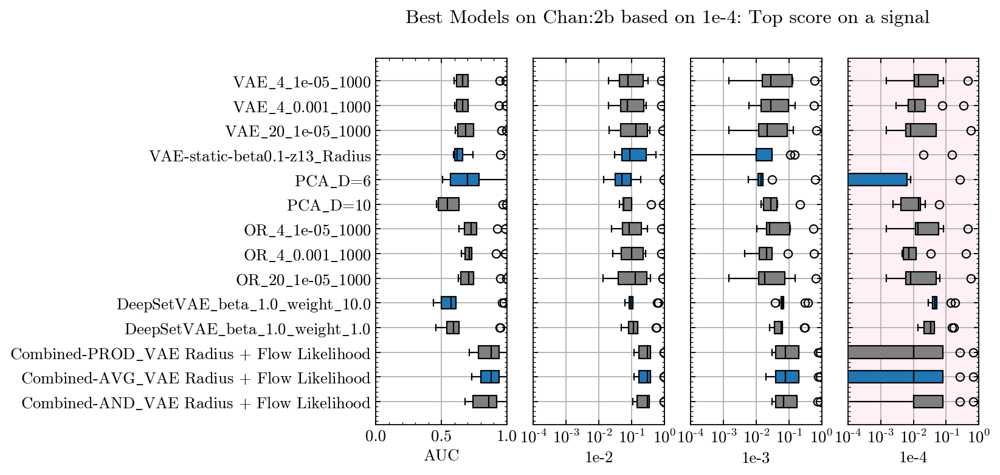

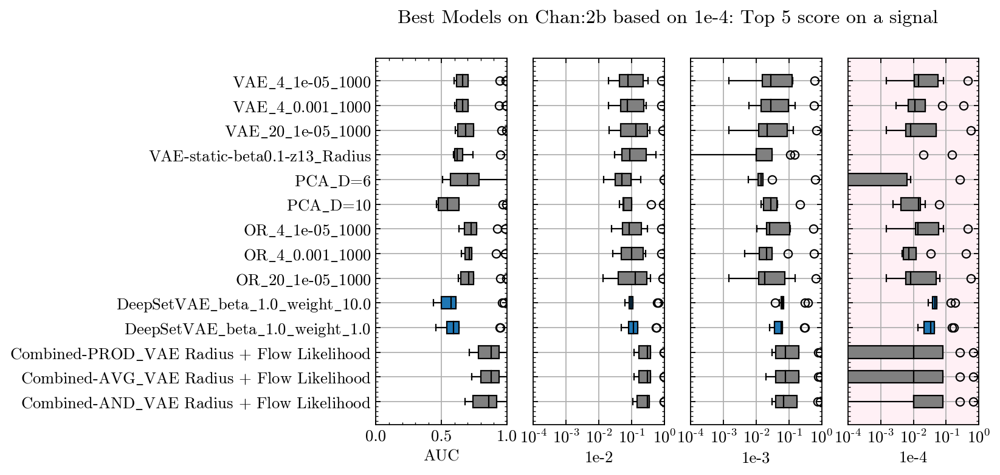

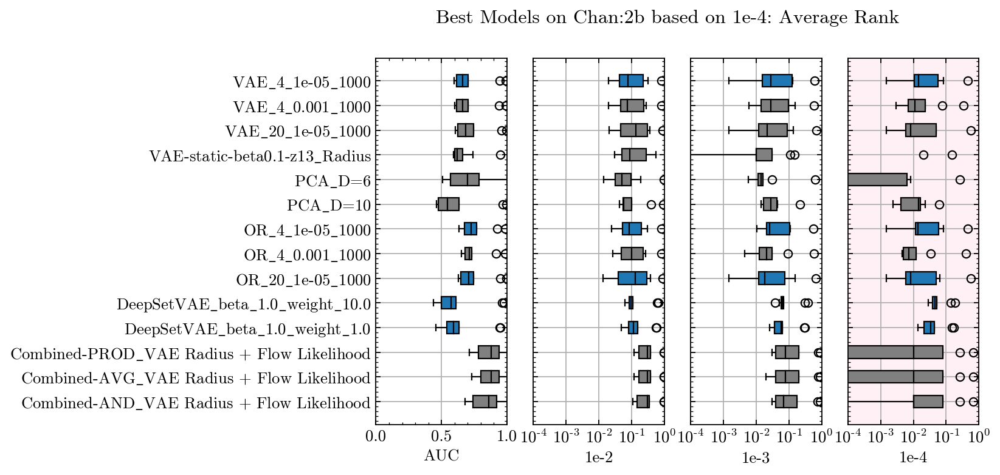

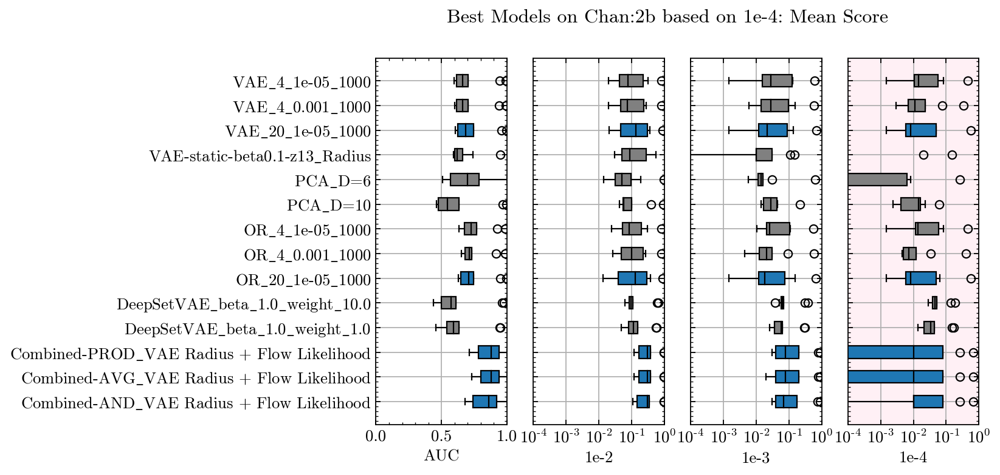

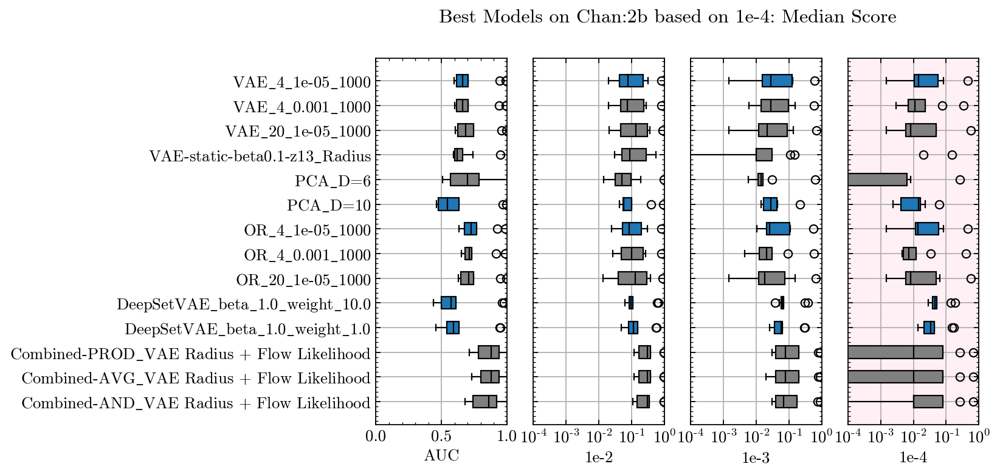

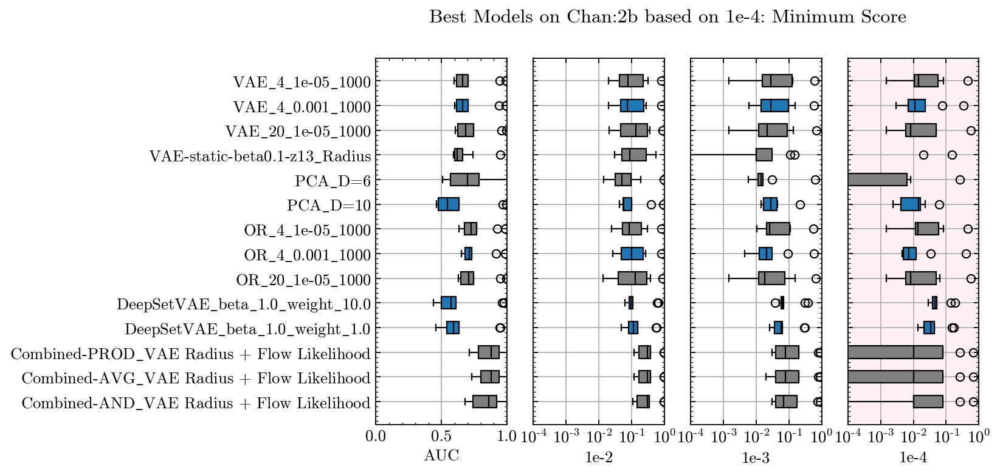

In [30]:
Analyze(AllCombined, 
        Chan='2b', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 4,
                            'top5': 2,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

## Chan 3
### AUC

****************************************
Models from chan=3 ranked by metric=AUC sorted by top1
                  Model  top1
290  VAE_HouseholderSNF     6
****************************************

****************************************
Models from chan=3 ranked by metric=AUC sorted by top5
                                          Model  top5
290                          VAE_HouseholderSNF     8
289                              VAE_PlanarFlow     7
292                           VAE_TriangularSNF     6
477   Combined-AVG_VAE Radius + Flow Likelihood     5
291                           VAE_OrthogonalSNF     4
476  Combined-PROD_VAE Radius + Flow Likelihood     3
473             Flow-Only-Aggregates_Likelihood     3
****************************************

****************************************
Models from chan=3 ranked by metric=AUC sorted by AverageRank
                                          Model  AverageRank
477   Combined-AVG_VAE Radius + Flow Likelihood         10.7
476  Co

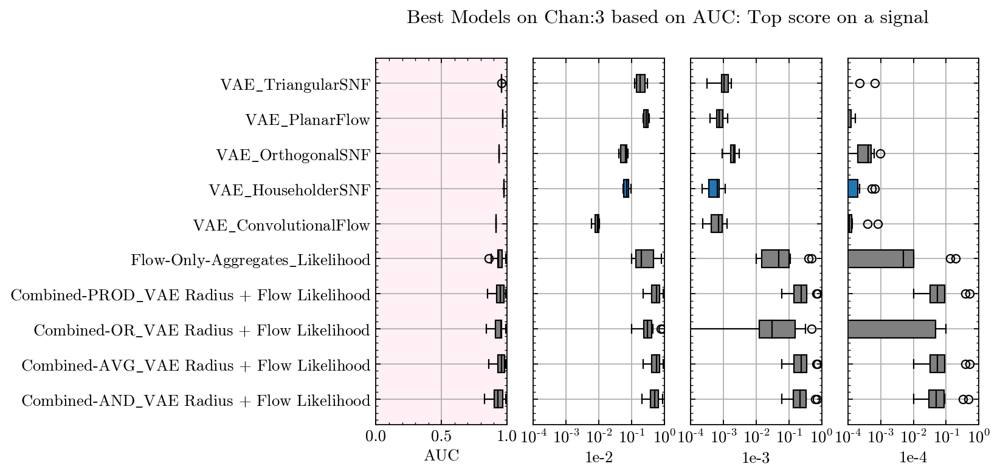

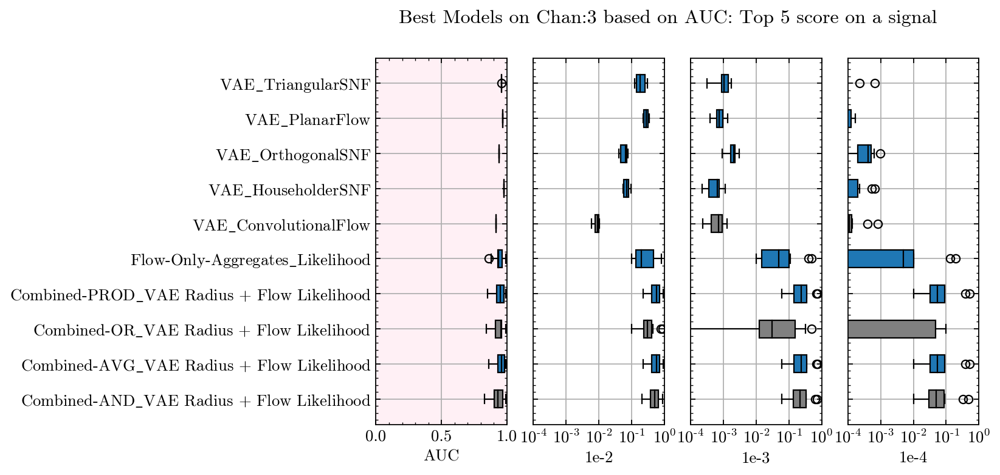

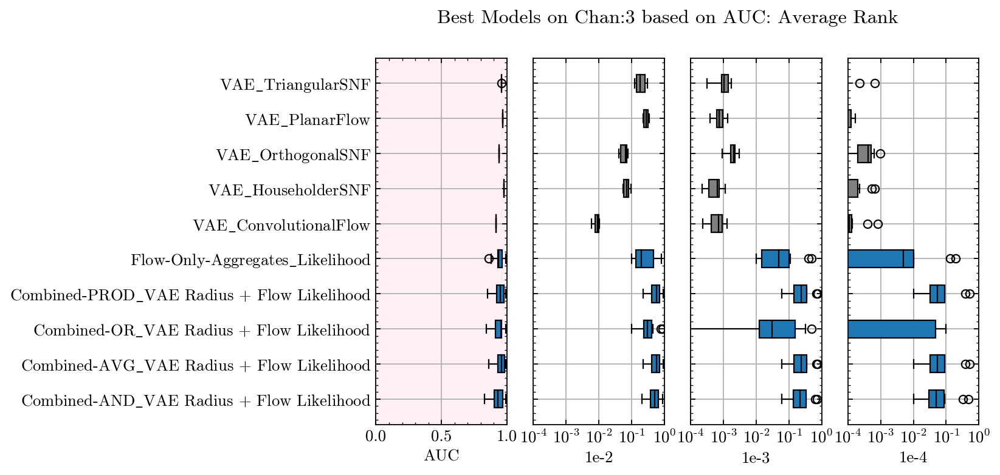

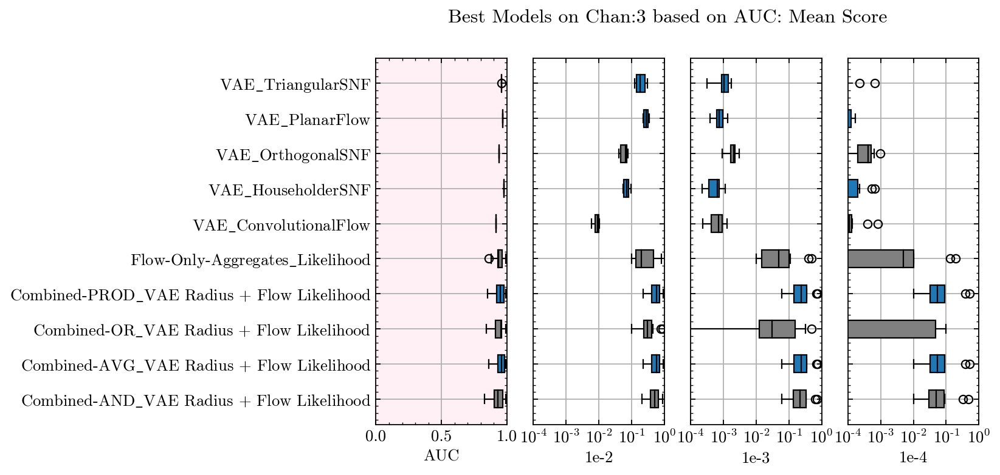

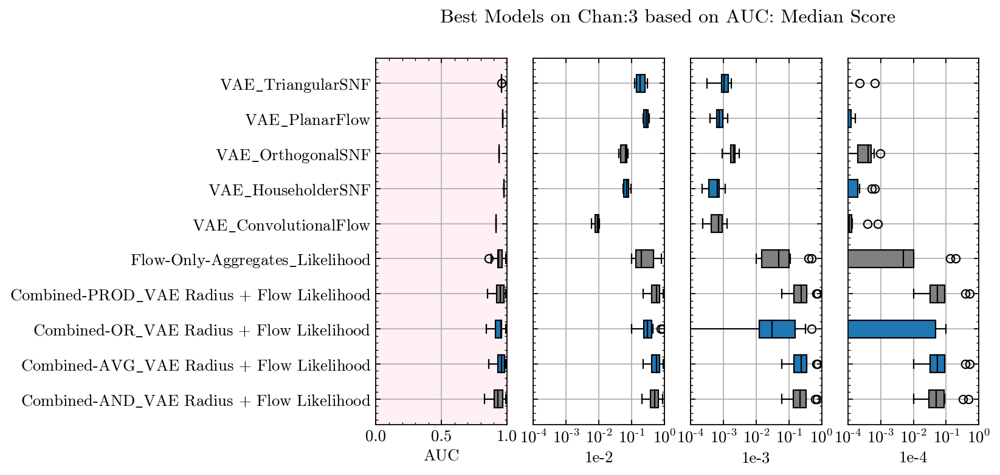

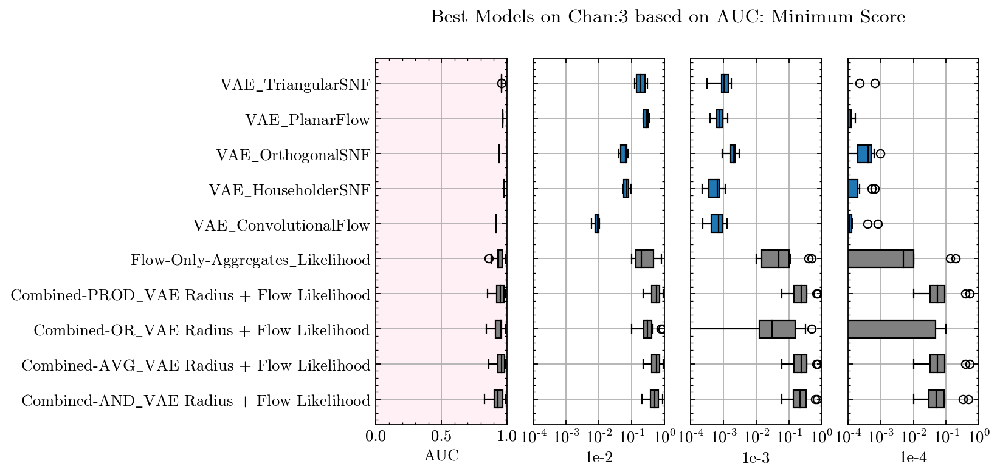

In [31]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='AUC',
        MetricNumberDict = {'top1': 1,
                            'top5': 7,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

****************************************
Models from chan=3 ranked by metric=1e-2 sorted by top1
                                          Model  top1
477   Combined-AVG_VAE Radius + Flow Likelihood     5
476  Combined-PROD_VAE Radius + Flow Likelihood     4
289                              VAE_PlanarFlow     1
****************************************

****************************************
Models from chan=3 ranked by metric=1e-2 sorted by top5
                                          Model  top5
474   Combined-AND_VAE Radius + Flow Likelihood    10
477   Combined-AVG_VAE Radius + Flow Likelihood    10
476  Combined-PROD_VAE Radius + Flow Likelihood    10
****************************************

****************************************
Models from chan=3 ranked by metric=1e-2 sorted by AverageRank
                                          Model  AverageRank
477   Combined-AVG_VAE Radius + Flow Likelihood          0.6
476  Combined-PROD_VAE Radius + Flow Likelihood          0.6
474

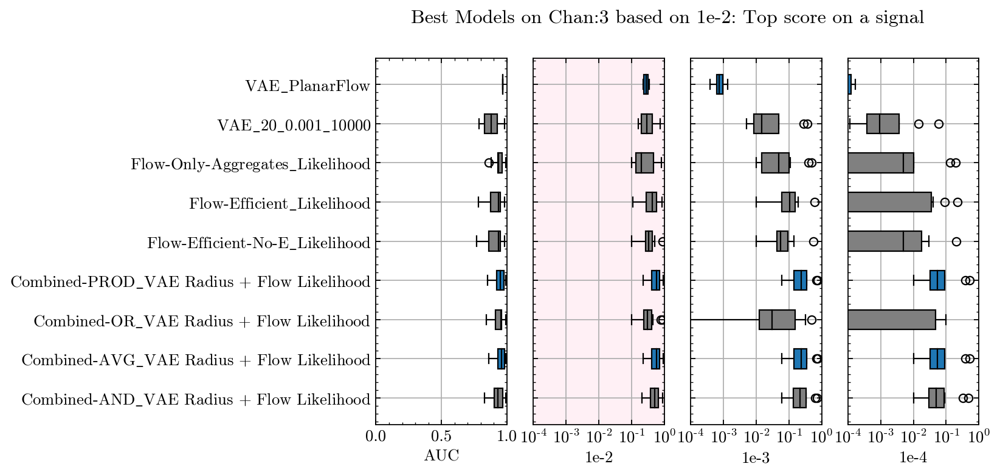

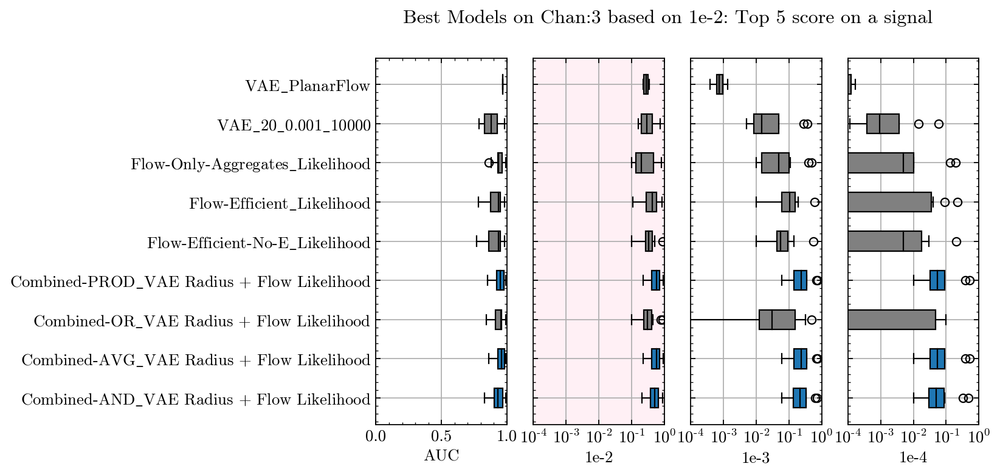

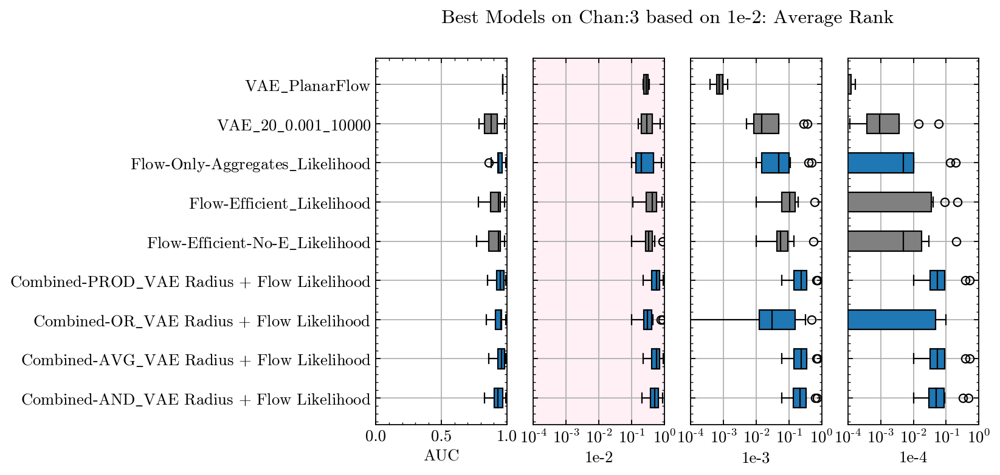

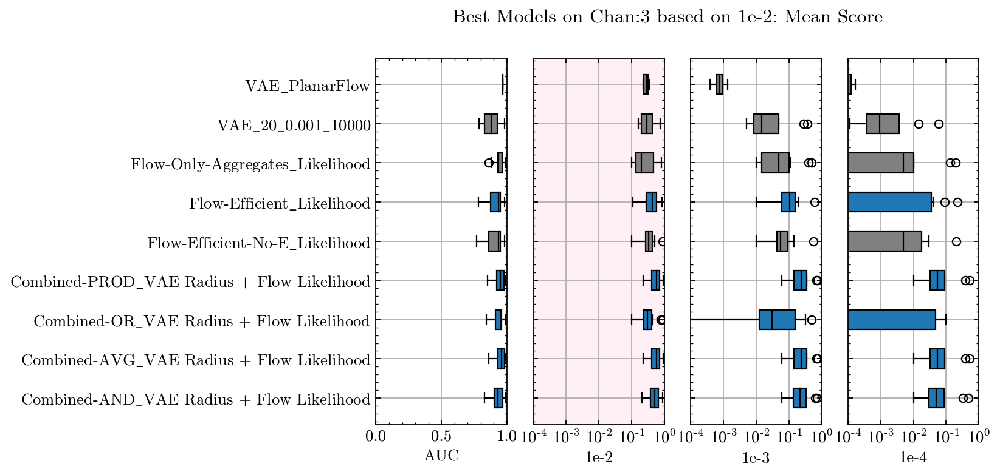

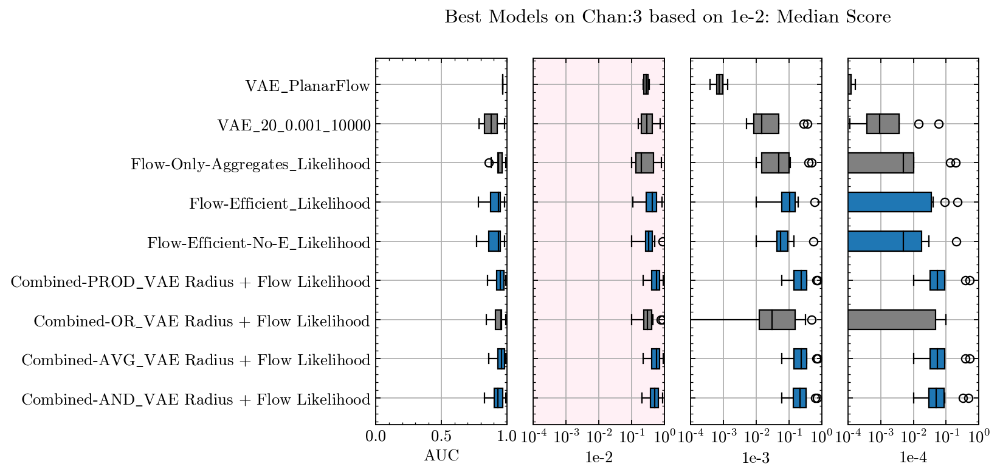

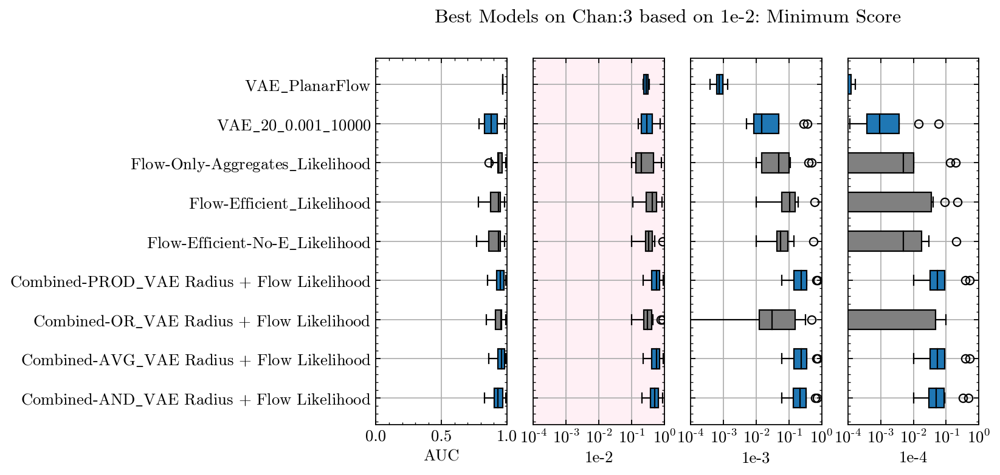

In [32]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 3,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

****************************************
Models from chan=3 ranked by metric=1e-3 sorted by top1
                                          Model  top1
477   Combined-AVG_VAE Radius + Flow Likelihood     6
476  Combined-PROD_VAE Radius + Flow Likelihood     4
****************************************

****************************************
Models from chan=3 ranked by metric=1e-3 sorted by top5
                                          Model  top5
477   Combined-AVG_VAE Radius + Flow Likelihood    10
476  Combined-PROD_VAE Radius + Flow Likelihood    10
474   Combined-AND_VAE Radius + Flow Likelihood    10
****************************************

****************************************
Models from chan=3 ranked by metric=1e-3 sorted by AverageRank
                                          Model  AverageRank
477   Combined-AVG_VAE Radius + Flow Likelihood          0.4
476  Combined-PROD_VAE Radius + Flow Likelihood          0.6
474   Combined-AND_VAE Radius + Flow Likelihood          

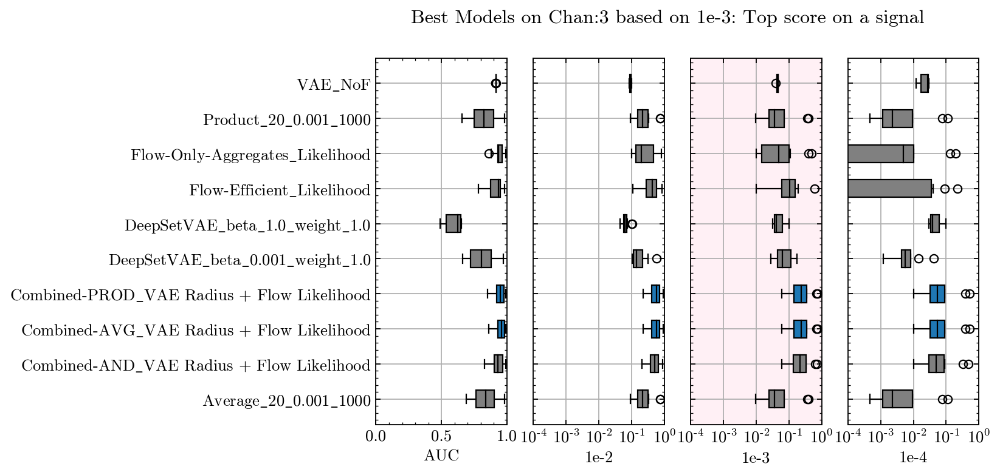

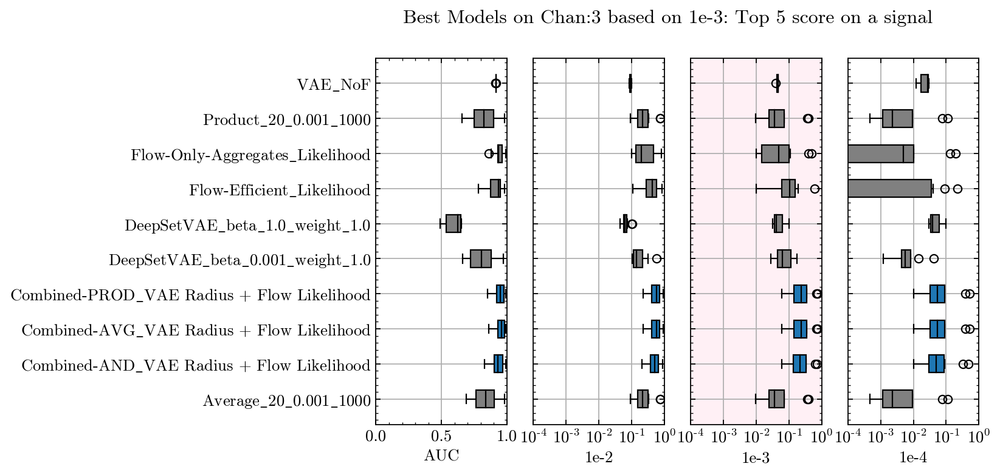

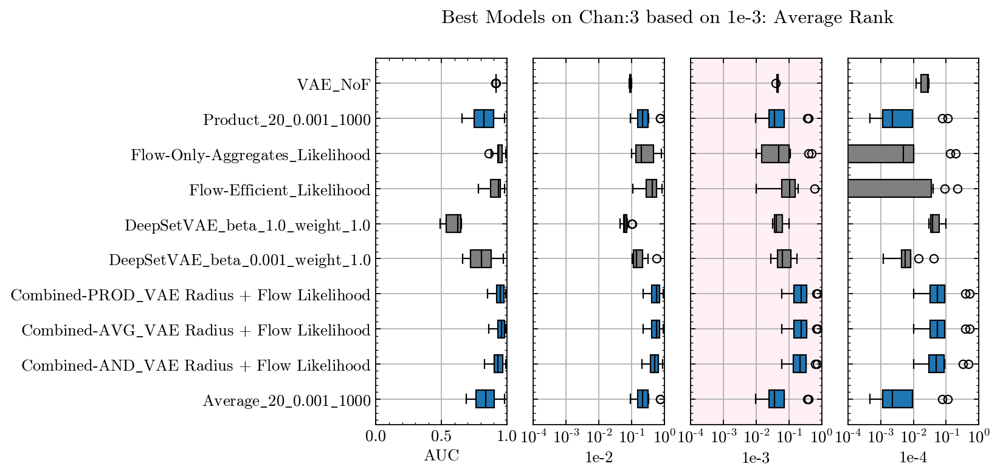

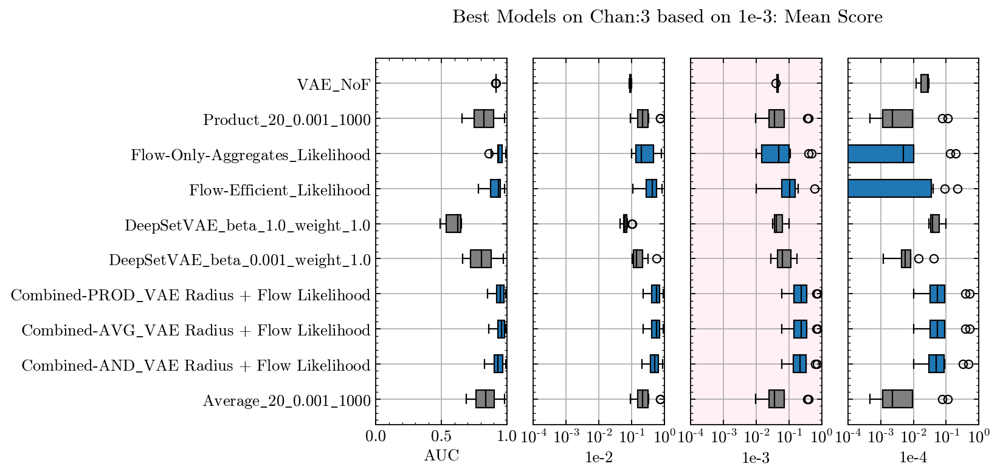

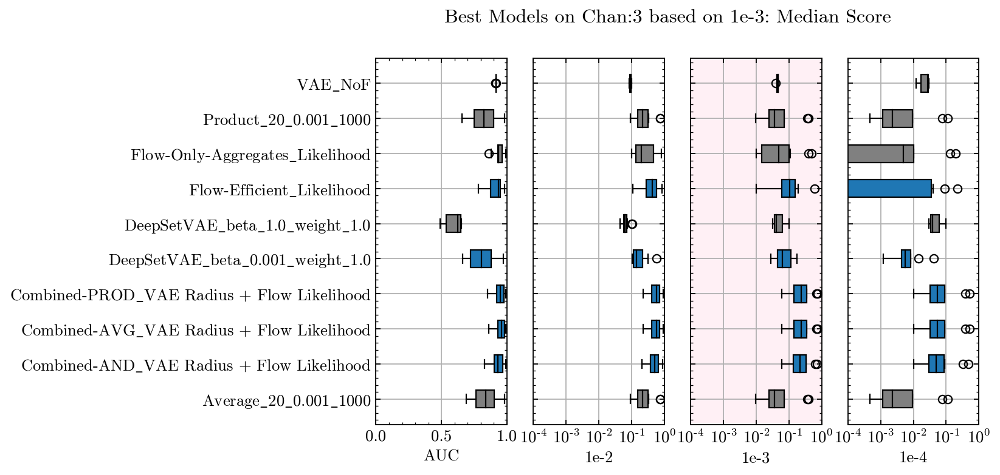

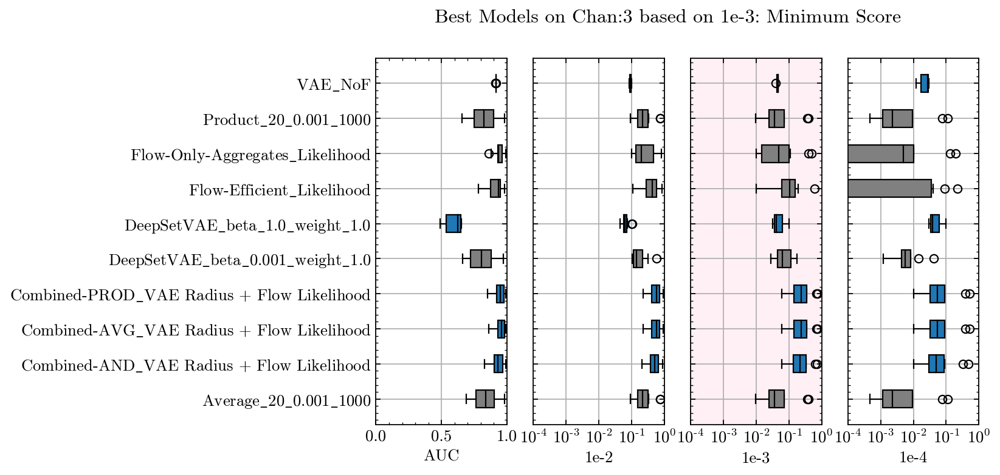

In [33]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 2,
                            'top5': 3,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-4

****************************************
Models from chan=3 ranked by metric=1e-4 sorted by top1
                                          Model  top1
550              DeepSetVAE_beta_1.0_weight_1.0     5
476  Combined-PROD_VAE Radius + Flow Likelihood     3
301                                     PCA_D=8     1
477   Combined-AVG_VAE Radius + Flow Likelihood     1
****************************************

****************************************
Models from chan=3 ranked by metric=1e-4 sorted by top5
                                          Model  top5
476  Combined-PROD_VAE Radius + Flow Likelihood     8
477   Combined-AVG_VAE Radius + Flow Likelihood     7
550              DeepSetVAE_beta_1.0_weight_1.0     7
474   Combined-AND_VAE Radius + Flow Likelihood     6
288                                     VAE_NoF     5
****************************************

****************************************
Models from chan=3 ranked by metric=1e-4 sorted by AverageRank
                        

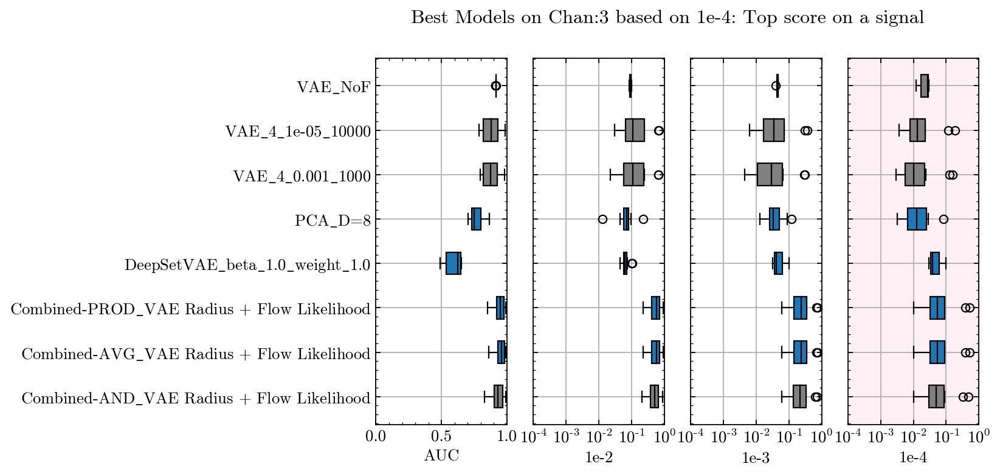

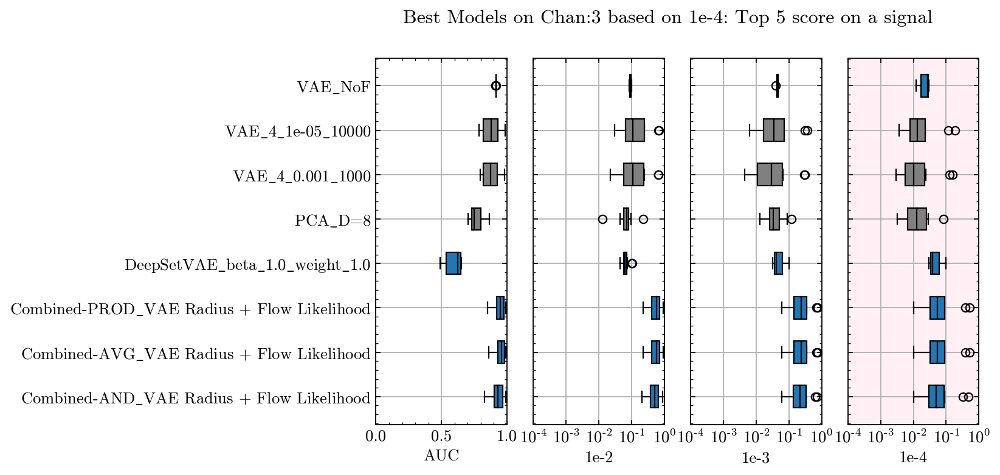

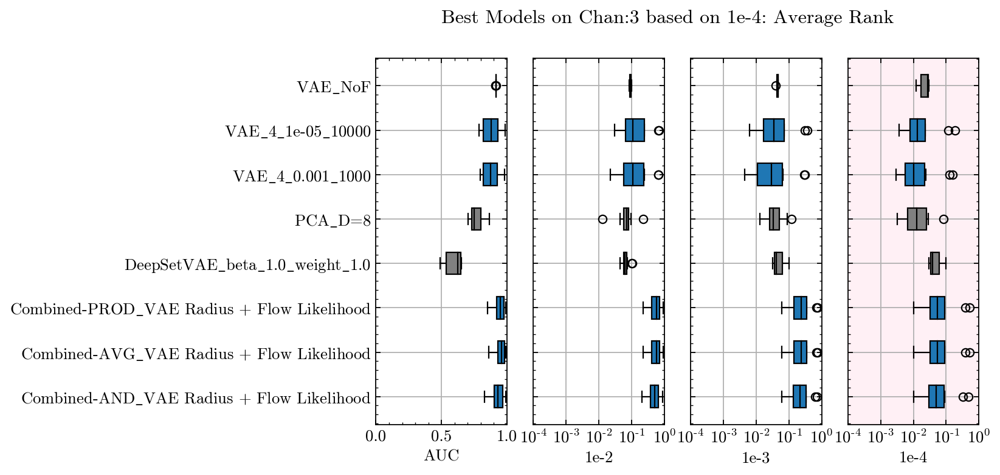

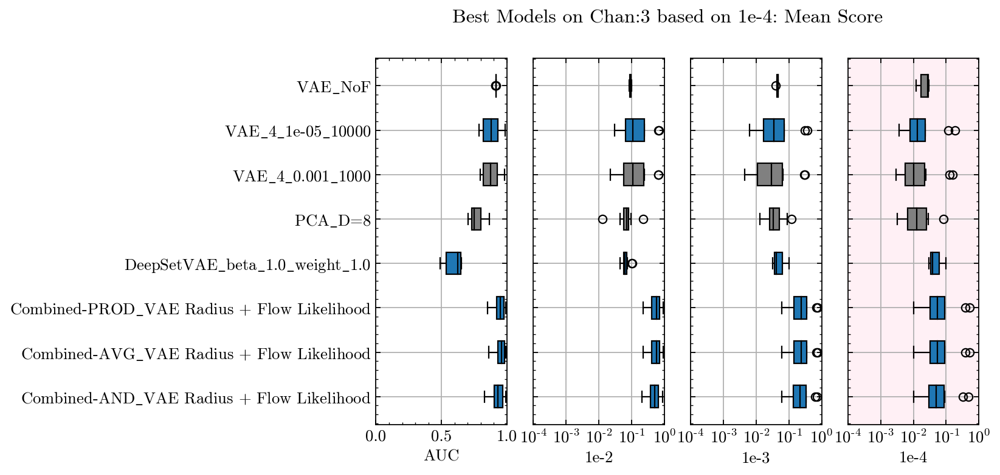

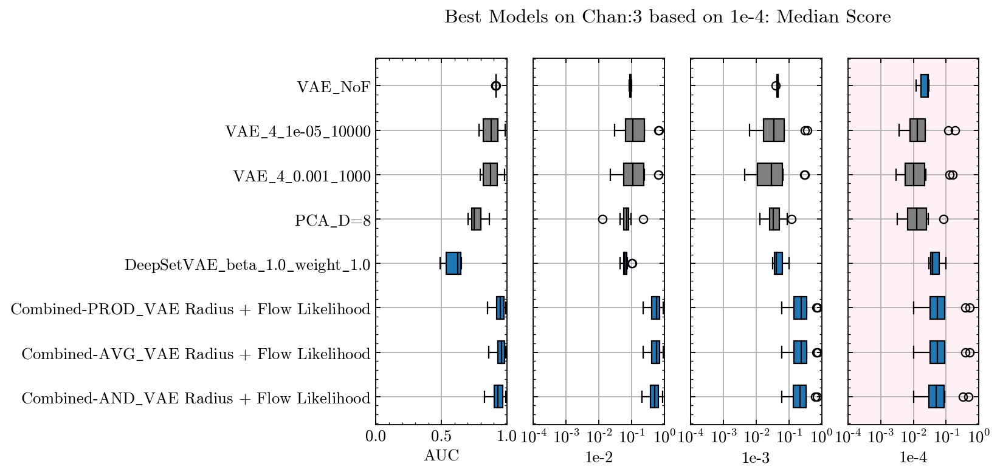

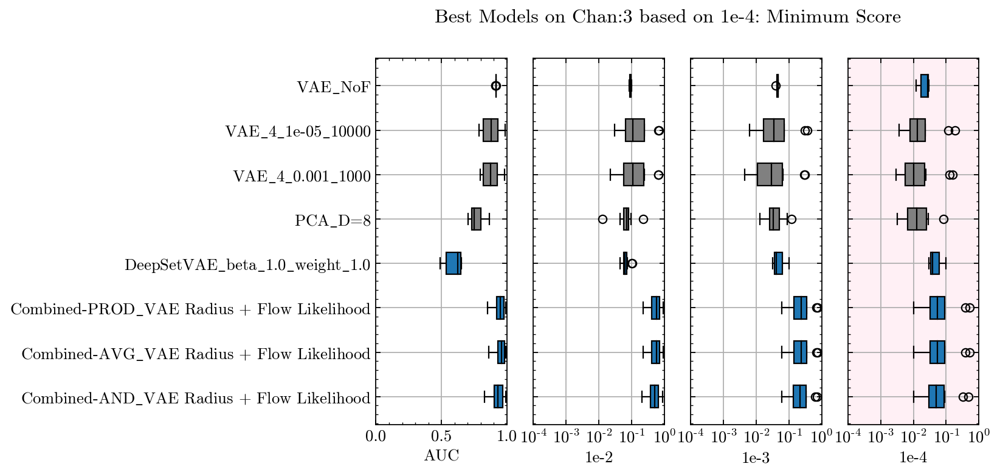

In [34]:
Analyze(AllCombined, 
        Chan='3', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 4,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

## All Channels combined
### AUC

****************************************
Models from chan=All ranked by metric=AUC sorted by top1
                                          Model  top1
290                          VAE_HouseholderSNF     6
291                           VAE_OrthogonalSNF     4
476  Combined-PROD_VAE Radius + Flow Likelihood     3
477   Combined-AVG_VAE Radius + Flow Likelihood     2
****************************************

****************************************
Models from chan=All ranked by metric=AUC sorted by top5
                                          Model  top5
292                           VAE_TriangularSNF    11
291                           VAE_OrthogonalSNF    10
290                          VAE_HouseholderSNF    10
289                              VAE_PlanarFlow     9
477   Combined-AVG_VAE Radius + Flow Likelihood     8
476  Combined-PROD_VAE Radius + Flow Likelihood     6
475    Combined-OR_VAE Radius + Flow Likelihood     5
293                                     VAE_IAF     5
******

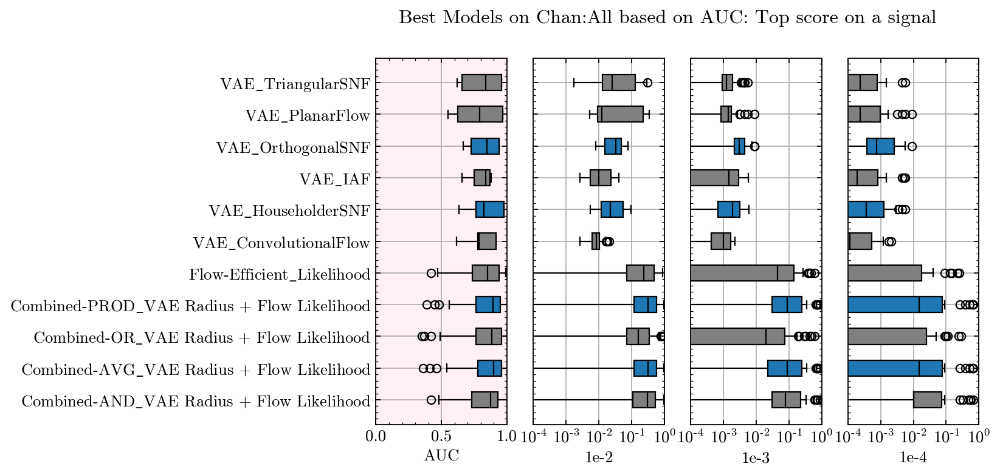

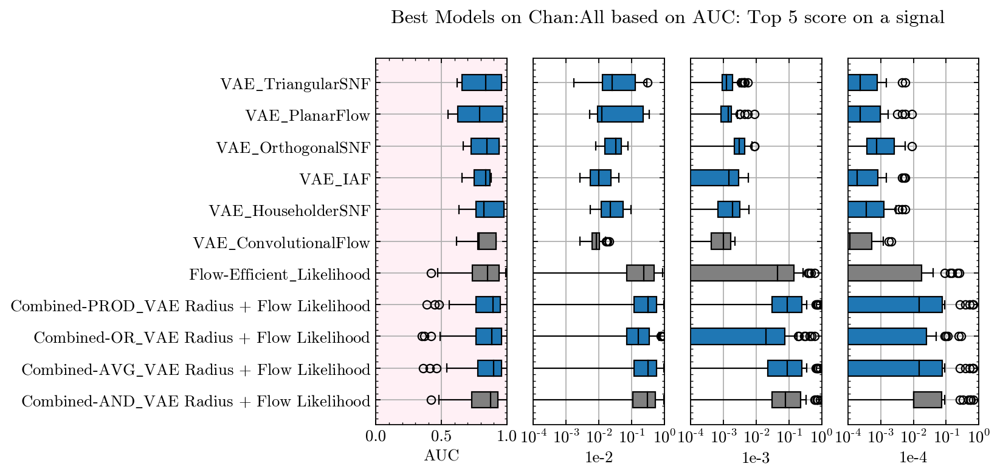

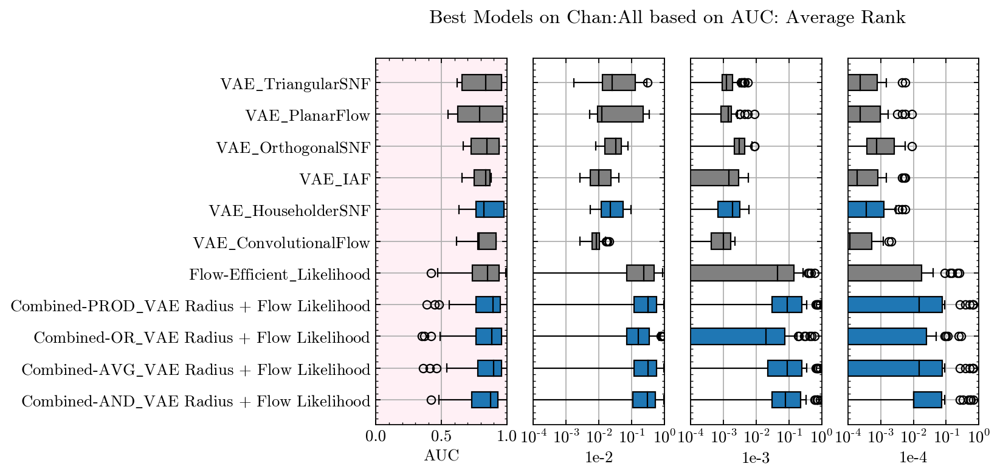

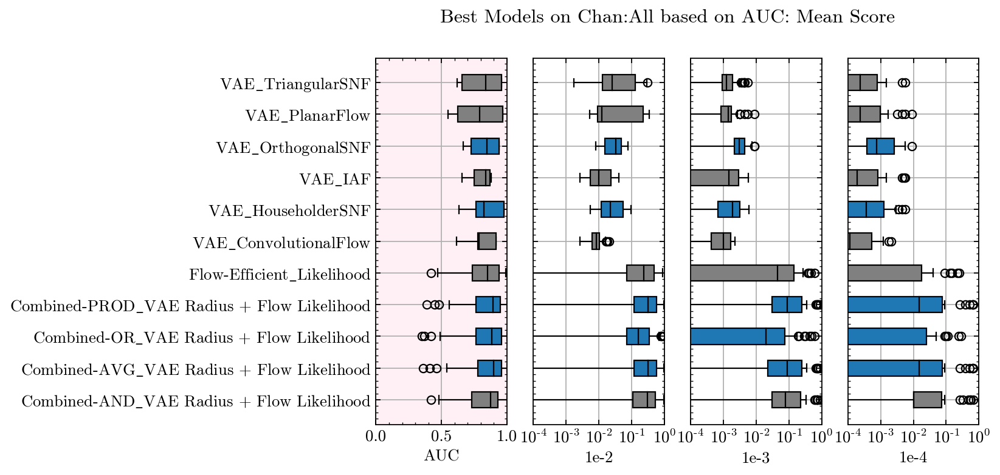

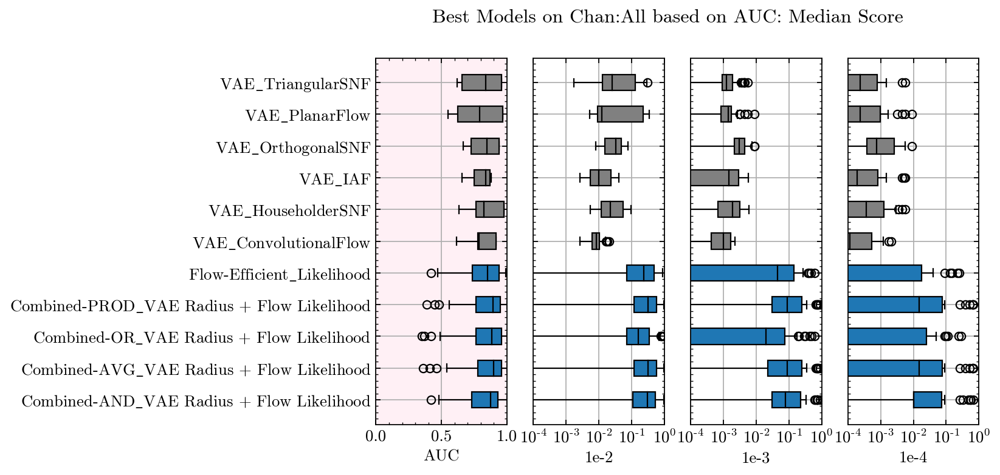

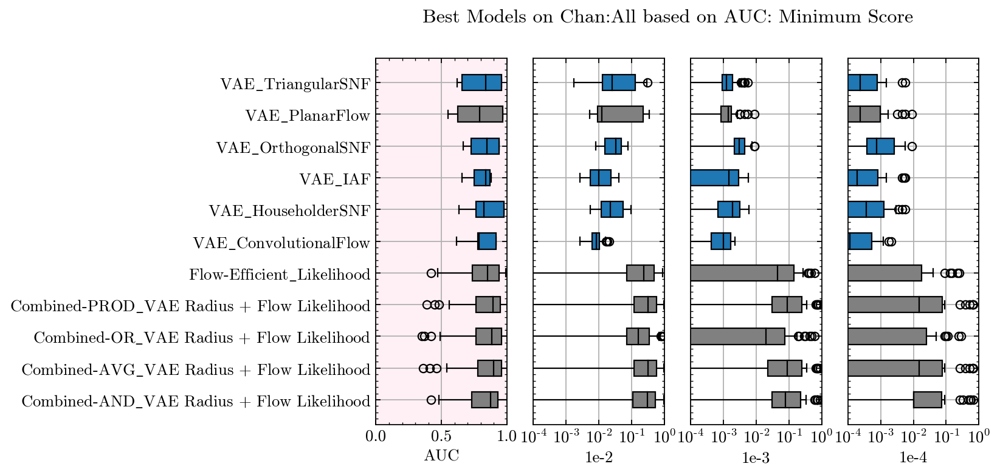

In [35]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='AUC',
        MetricNumberDict = {'top1': 4,
                            'top5': 8,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-2

****************************************
Models from chan=All ranked by metric=1e-2 sorted by top1
                                          Model  top1
476  Combined-PROD_VAE Radius + Flow Likelihood     7
477   Combined-AVG_VAE Radius + Flow Likelihood     5
177                           OR_30_0.001_10000     2
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by top5
                                          Model  top5
477   Combined-AVG_VAE Radius + Flow Likelihood    13
474   Combined-AND_VAE Radius + Flow Likelihood    13
476  Combined-PROD_VAE Radius + Flow Likelihood    13
471                   Flow-Efficient_Likelihood     9
472              Flow-Efficient-No-E_Likelihood     9
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by AverageRank
                                          Model  AverageRank
477   Combi

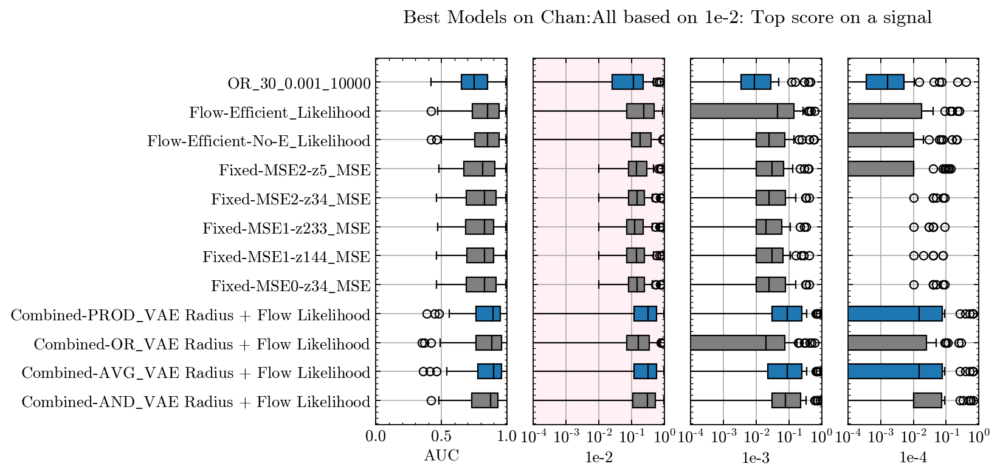

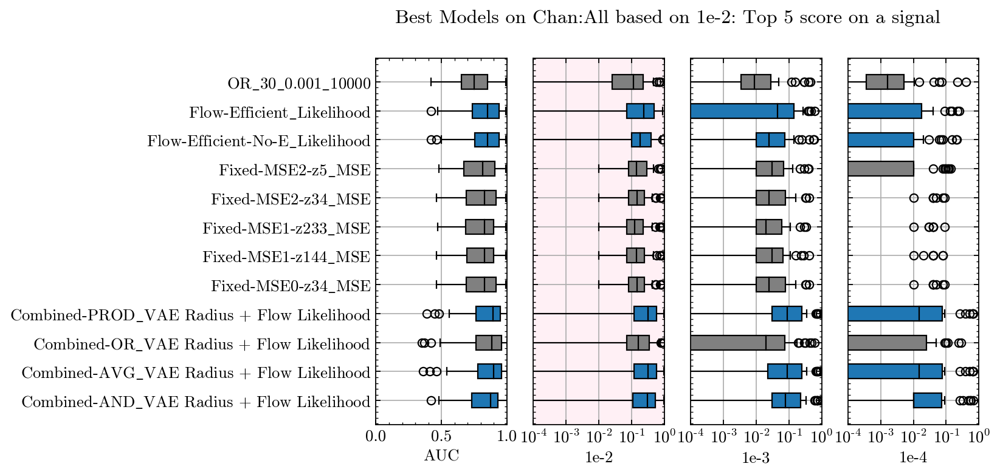

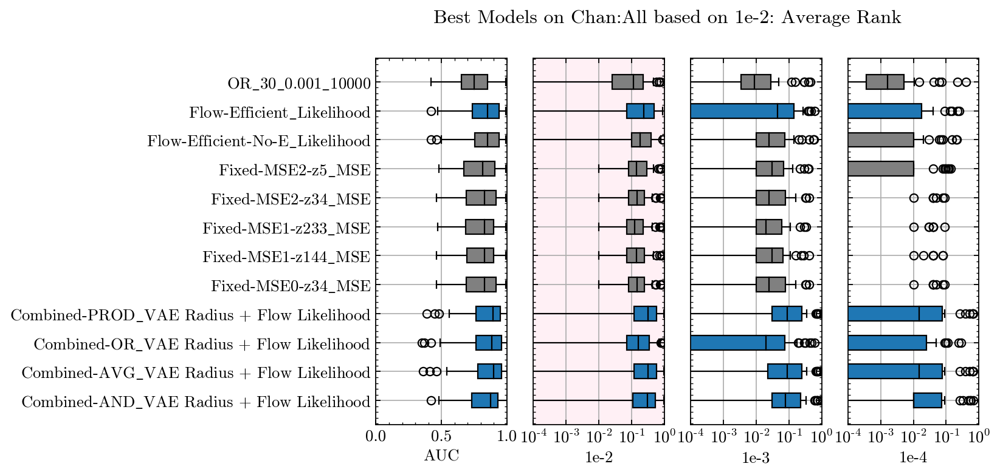

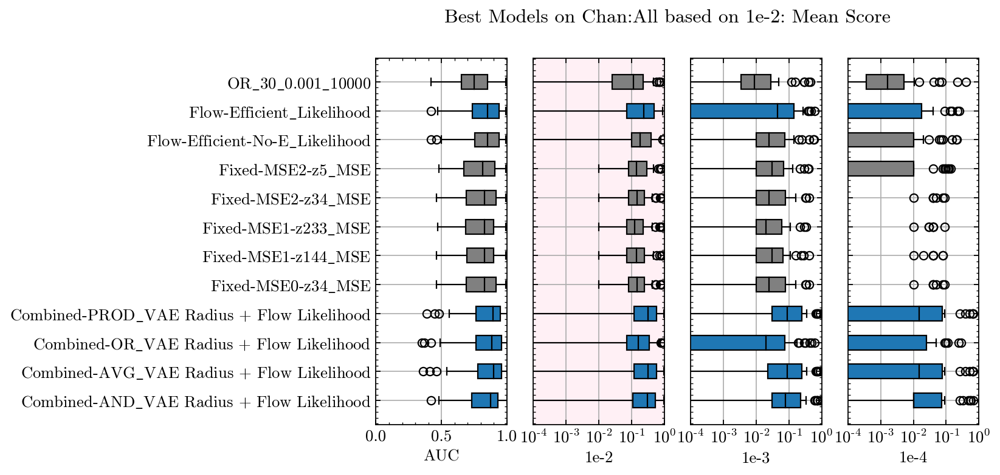

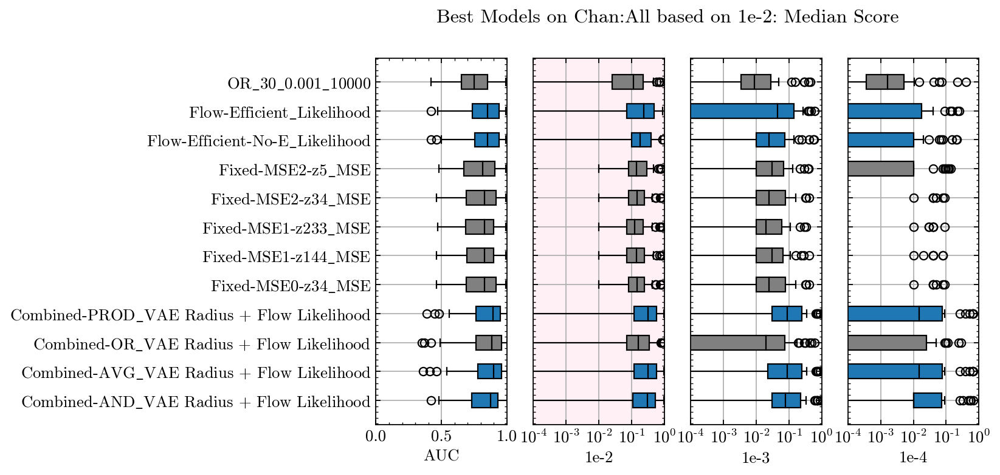

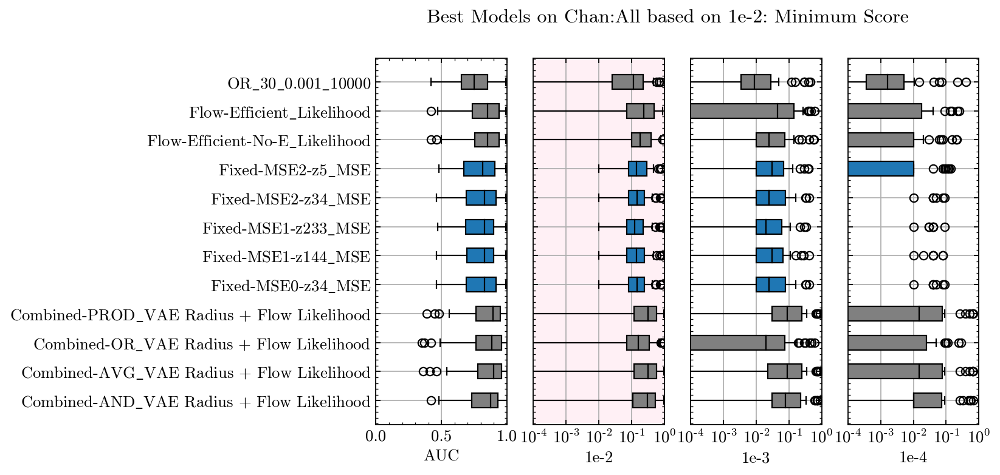

In [36]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='1e-2',
        MetricNumberDict = {'top1': 3,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 5},
        Plot=True
       )

### 1e-3

****************************************
Models from chan=All ranked by metric=1e-3 sorted by top1
                                          Model  top1
477   Combined-AVG_VAE Radius + Flow Likelihood     6
476  Combined-PROD_VAE Radius + Flow Likelihood     5
551             DeepSetVAE_beta_1.0_weight_10.0     2
341                VAE-dynamic-beta1e-06-z13_RL     2
****************************************

****************************************
Models from chan=All ranked by metric=1e-3 sorted by top5
                                          Model  top5
476  Combined-PROD_VAE Radius + Flow Likelihood    13
474   Combined-AND_VAE Radius + Flow Likelihood    13
477   Combined-AVG_VAE Radius + Flow Likelihood    12
471                   Flow-Efficient_Likelihood     7
551             DeepSetVAE_beta_1.0_weight_10.0     4
****************************************

****************************************
Models from chan=All ranked by metric=1e-3 sorted by AverageRank
                  

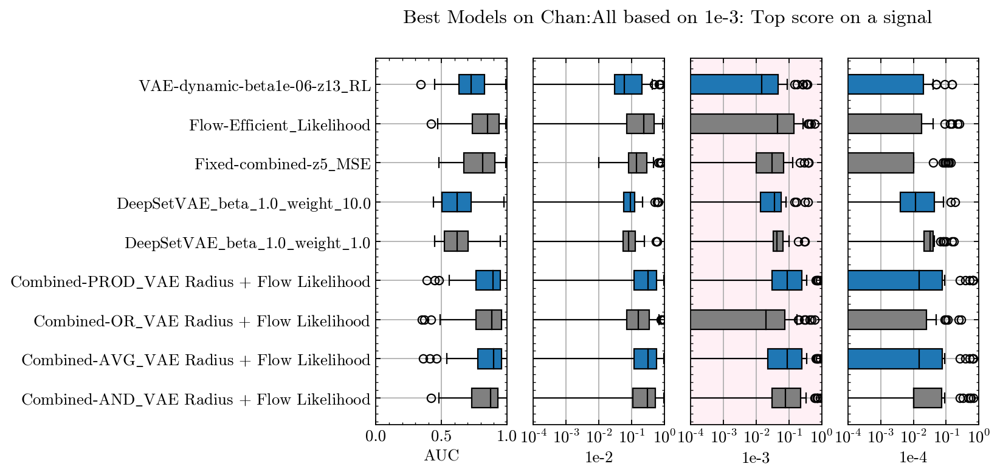

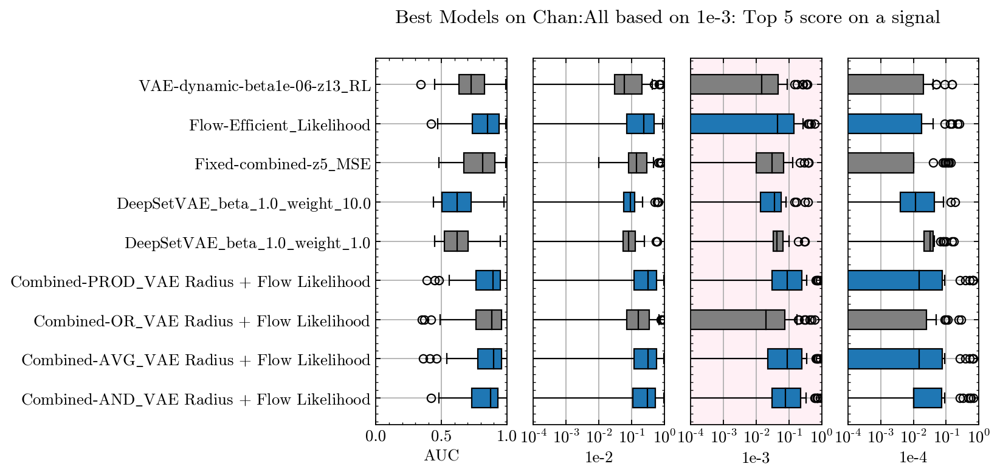

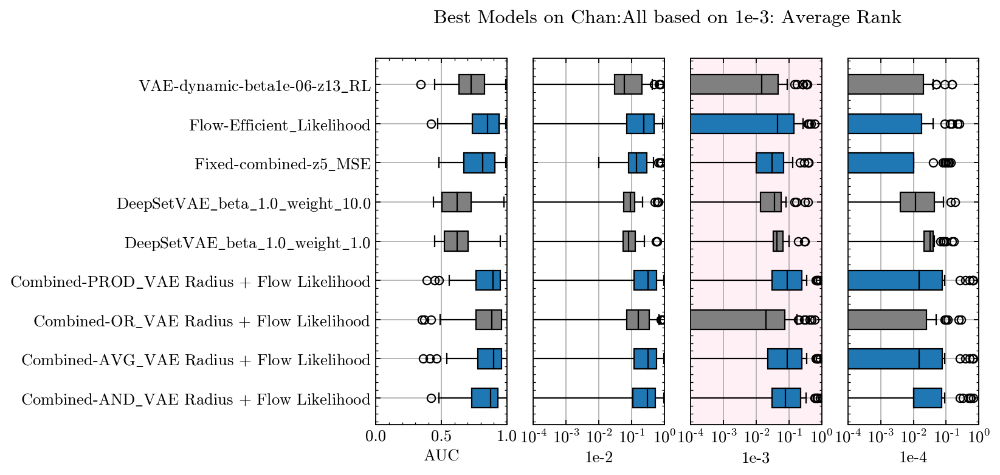

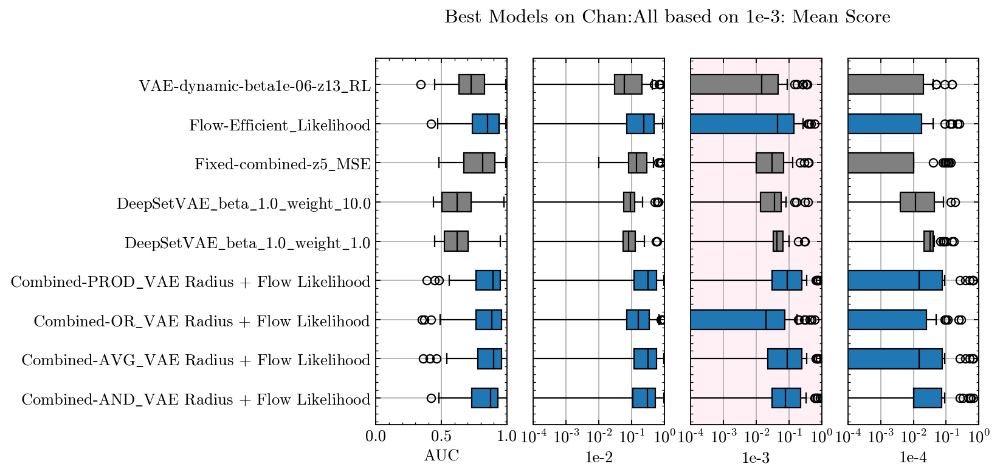

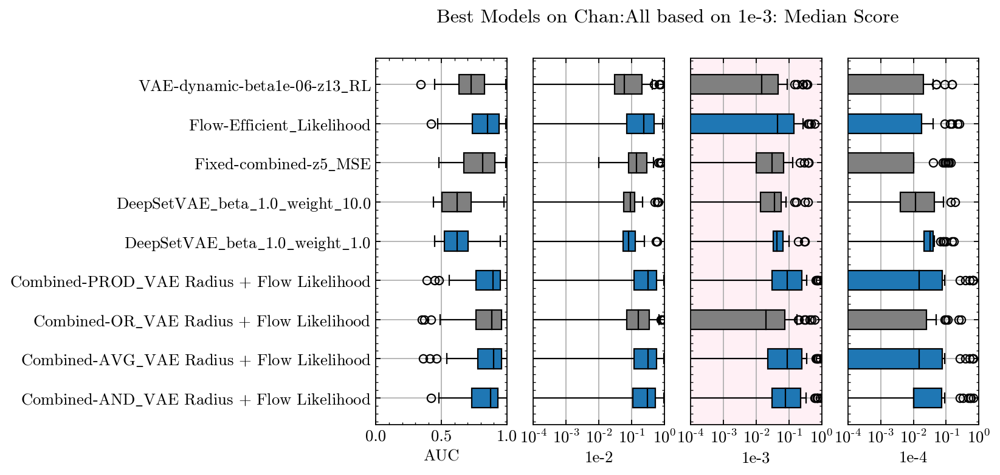

In [37]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='1e-3',
        MetricNumberDict = {'top1': 4,
                            'top5': 5,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 0},
        Plot=True
       )

### 1e-4

****************************************
Models from chan=All ranked by metric=1e-4 sorted by top1
                                          Model  top1
551             DeepSetVAE_beta_1.0_weight_10.0     6
550              DeepSetVAE_beta_1.0_weight_1.0     5
476  Combined-PROD_VAE Radius + Flow Likelihood     3
****************************************

****************************************
Models from chan=All ranked by metric=1e-4 sorted by top5
                                          Model  top5
550              DeepSetVAE_beta_1.0_weight_1.0    12
476  Combined-PROD_VAE Radius + Flow Likelihood     8
477   Combined-AVG_VAE Radius + Flow Likelihood     7
474   Combined-AND_VAE Radius + Flow Likelihood     6
551             DeepSetVAE_beta_1.0_weight_10.0     6
288                                     VAE_NoF     5
****************************************

****************************************
Models from chan=All ranked by metric=1e-4 sorted by AverageRank
                  

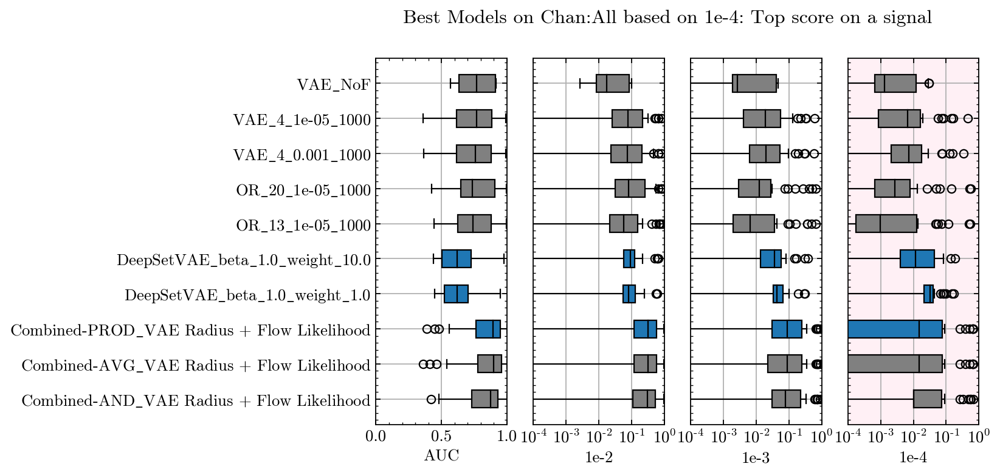

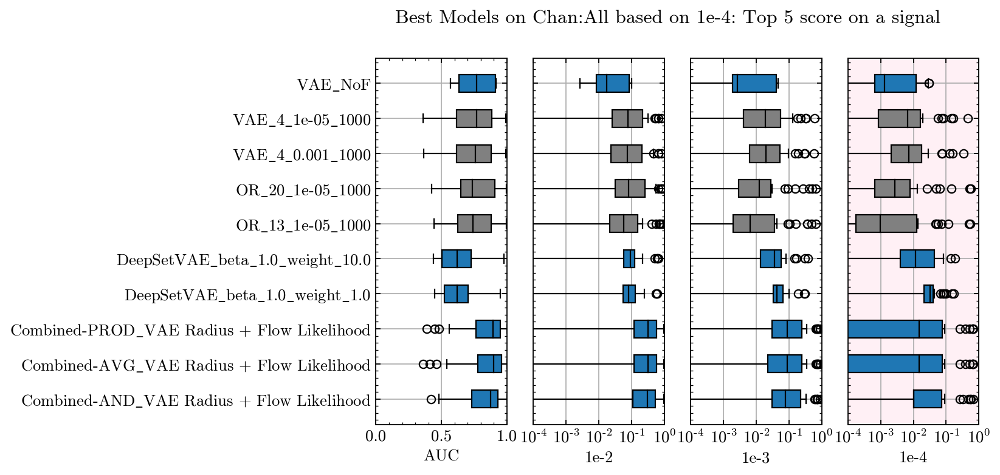

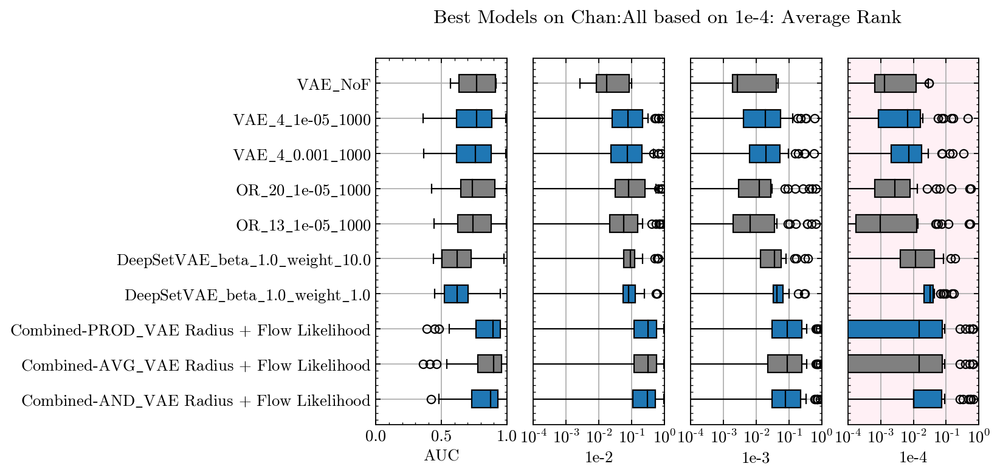

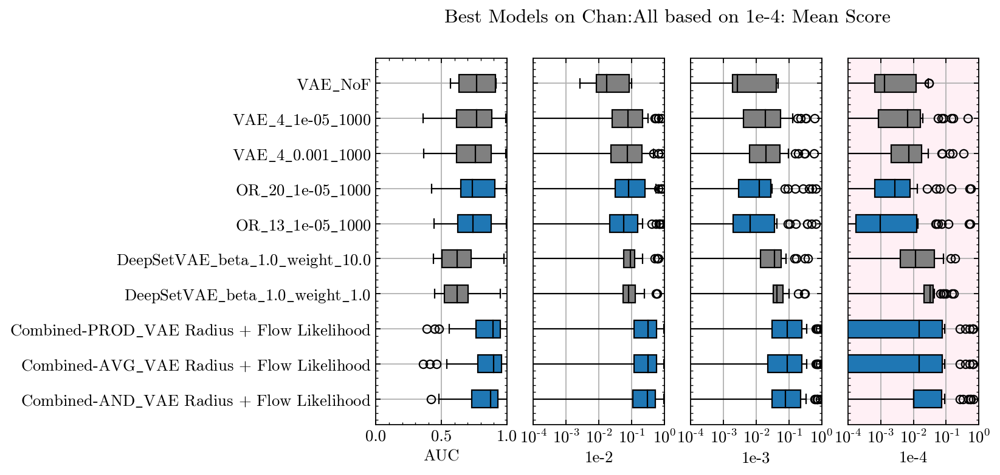

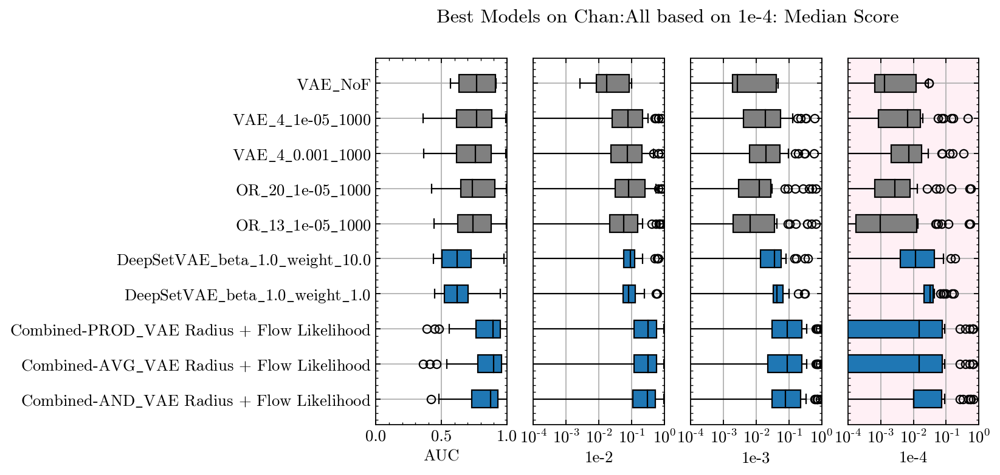

In [38]:
Analyze(AllCombined, 
        Chan='All', 
        Metric='1e-4',
        MetricNumberDict = {'top1': 3,
                            'top5': 6,
                            'AverageRank': 5,
                            'MeanScore': 5,
                            'MedianScore': 5,
                            'MinScore': 0},
        Plot=True
       )

# Second combination
In the previous analysis, the models were grouped by how they did on the same metric, i.e. AUC or 1e-2. Each plot was then looking at a different ways of determining which models are best by that metric.

In the next analysis, the rolls will be flipped. The models will be grouped by the method of determining which does best, i.e. having the highest minimum or the highest average. The models which do best by this method for each metric will be shown on the same plot.

In [39]:
def AnalyzeByMethod(CombinedDataFrame, Chan, Method, MetricNumberDict, Plot):
    """
    Inputs:
        CombineedDataFrame: Pandas dataframe with columns ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']
        Chan: String with which signal chanel is being analyzed. Must be one of ['1', '2a', '2b', '3', 'All']
        Method: String indicating the metric to use, must be one of ['top1', 'top5', 'AverageRank', 'MeanScore', 'MedianScore', 'MinScore']
        MetricNumberDict: The number of models to include for each sorting. Will usually include 5, 
            but some of the rankings need different numbers.
            example: MetricNumberDict = {'AUC': 5, 
                                         '1e-2': 5,
                                         '1e-3': 5,
                                         '1e-4': 5}
        Plot: Boolean if to make bar plots or not
        
    """
    for col in ['Model', 'Signal', 'Chan', 'AUC', '1e-2', '1e-3', '1e-4']:
        if col not in CombinedDataFrame.columns:
            print(f'CombinedDataFrame is missing column {col}')
            return 0
    if Chan not in ['1', '2a', '2b', '3', 'All']:
        print(f'Invalid "Chan" selection: {Chan}')
        return 0
    if Method not in ['top1', 'top5', 'AverageRank', 'MeanScore', 'MedianScore', 'MinScore']:
        print(f'Invalid "Method" selection: {Method}')
        return 0
    
    if Chan != 'All':
        AnalyzeFrame = CombinedDataFrame[CombinedDataFrame['Chan'] == Chan]
    else:
        AnalyzeFrame = CombinedDataFrame
    
    # This helper variable combines the channel and signal since some signals appear in multiple channels
    chansig = AnalyzeFrame['Chan'] + '/' + AnalyzeFrame['Signal']
    chansig = np.unique(chansig)
    sigs = AnalyzeFrame.Signal.unique()
    mods = AnalyzeFrame.Model.unique()
    SortedScores = pd.DataFrame()
    SortedScores['Model'] = mods
    
    SortedScores = {}
    BestC = []
    TopDict = {}
    for Metric in ['AUC', '1e-2', '1e-3', '1e-4']:
        SortedScores[Metric] = pd.DataFrame()
        SortedScores[Metric]['Model'] = mods
        
        # Go through each of the signals to find the ranking of the models for AUC

        for sig in chansig:
            chan, sig = sig.split('/')
            cs = AnalyzeFrame[(AnalyzeFrame['Signal'] == sig) & (AnalyzeFrame['Chan']==chan)]
            scorelist = cs[Metric]
            score_ranking = np.zeros_like(scorelist)
            for i, score in enumerate(np.argsort(-scorelist)):  # argsort gives the ordering to sort them, we want the orthogonal information
                score_ranking[score] = i
            SortedScores[Metric][sig] = score_ranking
        SortedScores[Metric]['AverageRank'] = SortedScores[Metric][[col for col in SortedScores[Metric].columns if 'Model' not in col]].mean(axis=1)
        SortedScores[Metric]['top1'] = (SortedScores[Metric][[col for col in SortedScores[Metric].columns if (('AverageRank' not in col)
                                                                                      and ('Model' not in col)
                                                                                     )]] < 1).sum(axis=1)
        SortedScores[Metric]['top5'] = (SortedScores[Metric][[col for col in SortedScores[Metric].columns if (('AverageRank' not in col) and 
                                                                                      ('top1' not in col) and
                                                                                      ('Model' not in col)
                                                                                     )]] < 5).sum(axis=1)

        meanscore = []
        medianscore = []
        minscore = []
        for m in mods:
            tmpdf = AnalyzeFrame[AnalyzeFrame['Model'] == m]
            tmpscores = tmpdf[Metric]
            meanscore.append(tmpscores.mean())
            medianscore.append(tmpscores.median())
            minscore.append(tmpscores.min())
        SortedScores[Metric]['MeanScore'] = meanscore
        SortedScores[Metric]['MedianScore'] = medianscore
        SortedScores[Metric]['MinScore'] = minscore
    
        num = MetricNumberDict[Metric]
        if num == 0: continue
        TopDict[Metric] = SortedScores[Metric].sort_values(by=Method,ascending=True if Method =='AverageRank' else False)[['Model']][:num].to_numpy().reshape(num)
        BestC += list(TopDict[Metric])
        print('*'*40)
        print(f'Models from chan={Chan} ranked by metric={Metric} sorted by {Method}')
        print(SortedScores[Metric].sort_values(by=Method,ascending=True if Method =='AverageRank' else False)[['Model', Method]][:num])
        print('*'*40)
        print()
        
    if Plot:
        nameddict = {'top1': 'Top score on a signal',
                     'top5': 'Top 5 score on a signal',
                     'AverageRank': 'Average Rank',
                     'MeanScore': 'Mean Score',
                     'MedianScore': 'Median Score',
                     'MinScore': 'Minimum Score'
                    }
        name = nameddict[Method]
        BestC = np.array(BestC).flatten()
        BestCU = np.unique(BestC)
        
        plt.figure(figsize=(8, 5))

        for colnum, col in enumerate(['AUC', '1e-2', '1e-3', '1e-4']):
            colors = ['grey' for m in BestCU]
            
            if col in TopDict:
                for bestnum, m in enumerate(TopDict[col]):
                    for mnum, mtop in enumerate(BestCU):
                        if m == mtop:
                            colors[mnum] = f'C{bestnum}'
            ax = plt.subplot(1, 4, colnum + 1)
            yvs=[]
            names = []
            data_all = []
            for i,m in enumerate(BestCU):
                tmp_data = []
                tmpdf = AnalyzeFrame[AnalyzeFrame['Model']==m].copy()
                for s in chansig:
                    chan, s = s.split('/')
                    tmpauc = tmpdf[(tmpdf['Signal'] == s) & (tmpdf['Chan']==chan)][col]
                    tmp_data.append(tmpauc)
                data_all.append(np.array(tmp_data).reshape(len(chansig)))
                yvs.append(i)
                names.append(m)
            databp = np.array(data_all).reshape(len(BestCU), len(chansig))
            databp[databp == 0] = 1e-10
            bbox1 = plt.boxplot(databp.T,
                        vert=False,
                        manage_ticks=False,
                        patch_artist=True,
                        medianprops={'color':'k'},
                        positions=yvs
                       )

            if colnum == 0:
                plt.yticks(yvs, [n.replace('_', r'$\_$') for n in names])
                plt.xlim(0, 1)
            else:
                plt.yticks(yvs, [])
                plt.xscale('log')
                plt.xlim(1e-4, 1)
                plt.xticks([1e-4, 1e-3, 1e-2, 1e-1, 1e0])


            for patch, color, flier in zip(bbox1['boxes'], colors, bbox1['fliers']):
                patch.set_facecolor(color)
                flier.set_markerfacecolor(color)
                flier.set_markerfacecolor(color)
                flier.set_markeredgecolor(color)
            plt.minorticks_on()
            plt.grid()
            plt.xlabel(col)
            
        legend_elements = [Patch(facecolor='C0', edgecolor='k',
                         label='Best'),
                   Patch(facecolor='C1', edgecolor='k',
                         label='2nd'),
                   Patch(facecolor='C2', edgecolor='k',
                         label='3rd'),
                   Patch(facecolor='C3', edgecolor='k',
                         label='4th'),
                   Patch(facecolor='C4', edgecolor='k',
                         label='5th')
                  ]
        plt.legend(handles=legend_elements, 
                   loc=(1.05,0.3), 
                   labelspacing=1,
#                    ncol=5,
                   facecolor='white',
                   framealpha=1,
        #            markerscale=100,
                   frameon=True)

        plt.suptitle(f'Best Models on Chan: {Chan}, based on {name}')
        plt.savefig(f'../reports/Plots/TopChan{Chan}_{name.replace(" ", "_")}_boxplot.pdf', bbox_inches='tight')   

## All Channels
### Top 1

****************************************
Models from chan=All ranked by metric=AUC sorted by top1
                                          Model  top1
290                          VAE_HouseholderSNF     6
291                           VAE_OrthogonalSNF     4
476  Combined-PROD_VAE Radius + Flow Likelihood     3
477   Combined-AVG_VAE Radius + Flow Likelihood     2
475    Combined-OR_VAE Radius + Flow Likelihood     1
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by top1
                                          Model  top1
476  Combined-PROD_VAE Radius + Flow Likelihood     7
477   Combined-AVG_VAE Radius + Flow Likelihood     5
177                           OR_30_0.001_10000     2
484                      Fixed-combined-z89_MSE     1
471                   Flow-Efficient_Likelihood     1
****************************************

****************************************
Models from chan=All ranked by

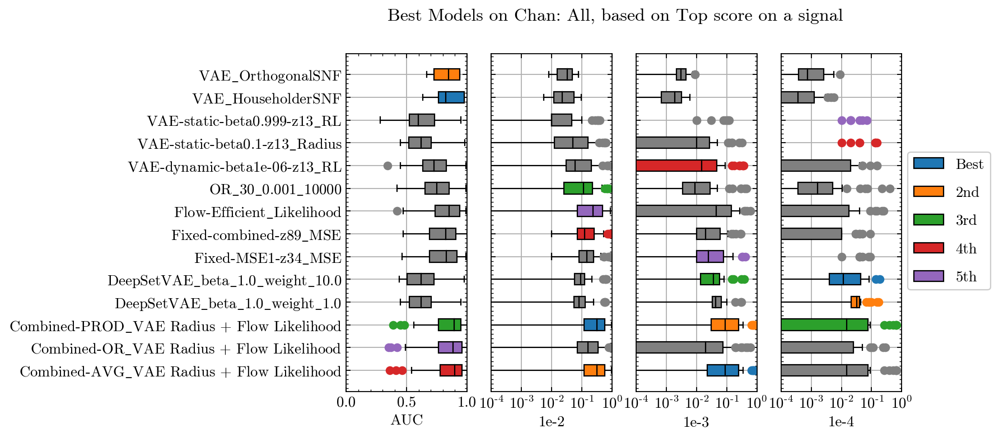

In [40]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='top1', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Top 5

****************************************
Models from chan=All ranked by metric=AUC sorted by top5
                                         Model  top5
292                          VAE_TriangularSNF    11
291                          VAE_OrthogonalSNF    10
290                         VAE_HouseholderSNF    10
289                             VAE_PlanarFlow     9
477  Combined-AVG_VAE Radius + Flow Likelihood     8
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by top5
                                          Model  top5
477   Combined-AVG_VAE Radius + Flow Likelihood    13
474   Combined-AND_VAE Radius + Flow Likelihood    13
476  Combined-PROD_VAE Radius + Flow Likelihood    13
471                   Flow-Efficient_Likelihood     9
472              Flow-Efficient-No-E_Likelihood     9
****************************************

****************************************
Models from chan=All ranked by metri

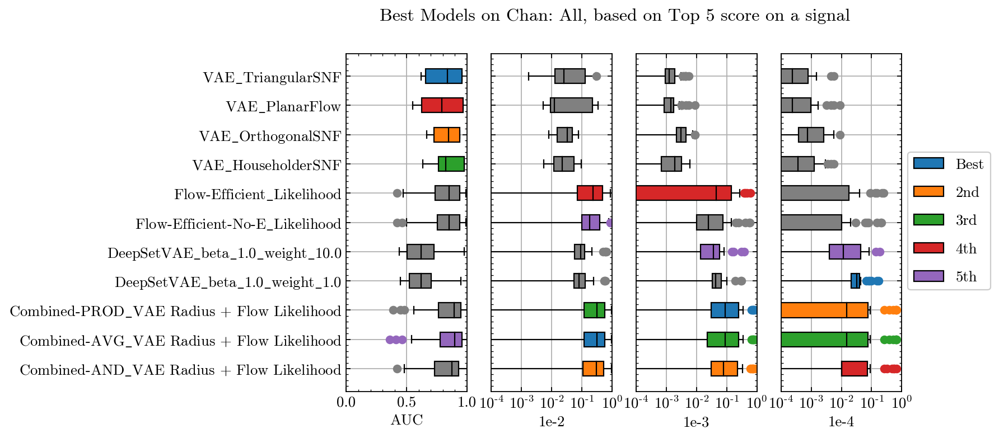

In [41]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='top5', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Average Rank

****************************************
Models from chan=All ranked by metric=AUC sorted by AverageRank
                                          Model  AverageRank
476  Combined-PROD_VAE Radius + Flow Likelihood    19.105263
477   Combined-AVG_VAE Radius + Flow Likelihood    19.473684
474   Combined-AND_VAE Radius + Flow Likelihood    24.157895
290                          VAE_HouseholderSNF    30.000000
475    Combined-OR_VAE Radius + Flow Likelihood    37.947368
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by AverageRank
                                          Model  AverageRank
477   Combined-AVG_VAE Radius + Flow Likelihood    36.000000
476  Combined-PROD_VAE Radius + Flow Likelihood    36.421053
474   Combined-AND_VAE Radius + Flow Likelihood    42.315789
471                   Flow-Efficient_Likelihood    49.684211
475    Combined-OR_VAE Radius + Flow Likelihood    62.631579
***************

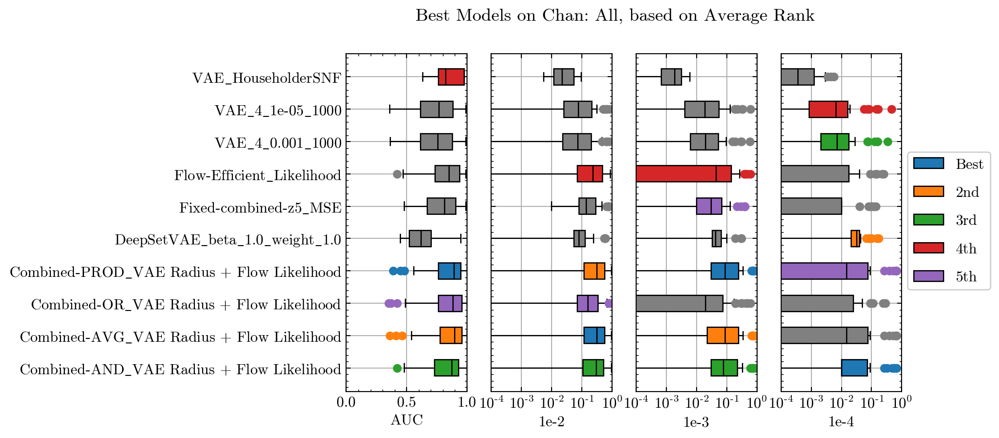

In [42]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='AverageRank', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Mean Score

****************************************
Models from chan=All ranked by metric=AUC sorted by MeanScore
                                          Model  MeanScore
477   Combined-AVG_VAE Radius + Flow Likelihood   0.831471
476  Combined-PROD_VAE Radius + Flow Likelihood   0.827941
290                          VAE_HouseholderSNF   0.820322
475    Combined-OR_VAE Radius + Flow Likelihood   0.816176
291                           VAE_OrthogonalSNF   0.815963
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by MeanScore
                                          Model  MeanScore
477   Combined-AVG_VAE Radius + Flow Likelihood   0.372941
476  Combined-PROD_VAE Radius + Flow Likelihood   0.371471
474   Combined-AND_VAE Radius + Flow Likelihood   0.350588
471                   Flow-Efficient_Likelihood   0.291471
475    Combined-OR_VAE Radius + Flow Likelihood   0.266176
****************************************

*

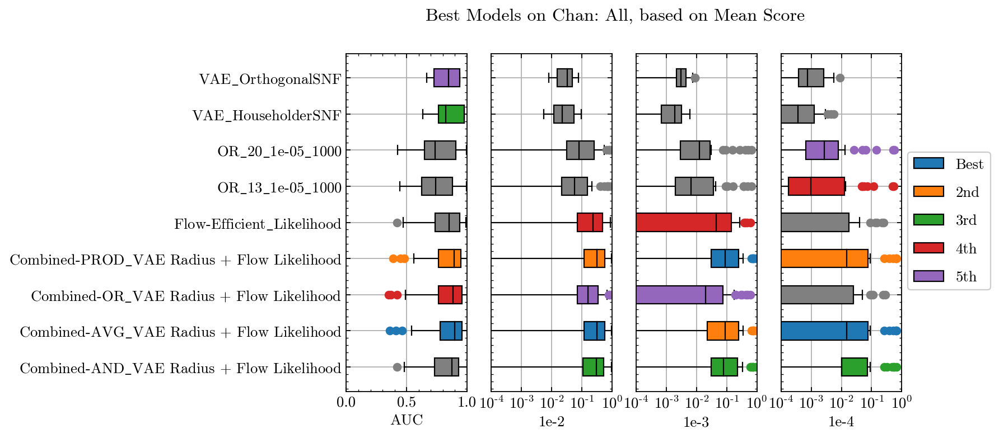

In [43]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='MeanScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Median Score

****************************************
Models from chan=All ranked by metric=AUC sorted by MedianScore
                                          Model  MedianScore
477   Combined-AVG_VAE Radius + Flow Likelihood        0.900
476  Combined-PROD_VAE Radius + Flow Likelihood        0.895
475    Combined-OR_VAE Radius + Flow Likelihood        0.885
474   Combined-AND_VAE Radius + Flow Likelihood        0.875
471                   Flow-Efficient_Likelihood        0.850
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by MedianScore
                                          Model  MedianScore
477   Combined-AVG_VAE Radius + Flow Likelihood        0.315
476  Combined-PROD_VAE Radius + Flow Likelihood        0.315
474   Combined-AND_VAE Radius + Flow Likelihood        0.300
471                   Flow-Efficient_Likelihood        0.235
472              Flow-Efficient-No-E_Likelihood        0.180
***************

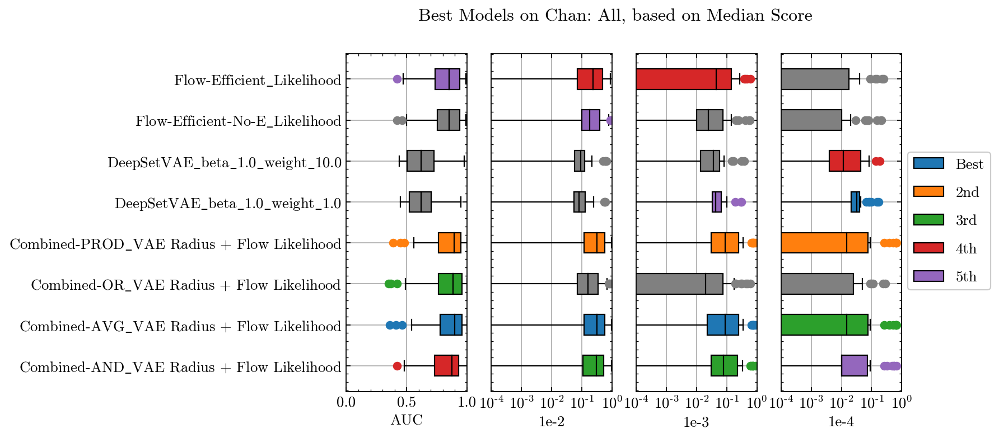

In [44]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='MedianScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Best Minimum Score

****************************************
Models from chan=All ranked by metric=AUC sorted by MinScore
                     Model  MinScore
291      VAE_OrthogonalSNF  0.666274
293                VAE_IAF  0.655265
290     VAE_HouseholderSNF  0.634438
292      VAE_TriangularSNF  0.617532
294  VAE_ConvolutionalFlow  0.615684
****************************************

****************************************
Models from chan=All ranked by metric=1e-2 sorted by MinScore
                   Model  MinScore
491   Fixed-MSE0-z34_MSE      0.01
509   Fixed-MSE2-z34_MSE      0.01
503  Fixed-MSE1-z144_MSE      0.01
504  Fixed-MSE1-z233_MSE      0.01
505    Fixed-MSE2-z5_MSE      0.01
****************************************



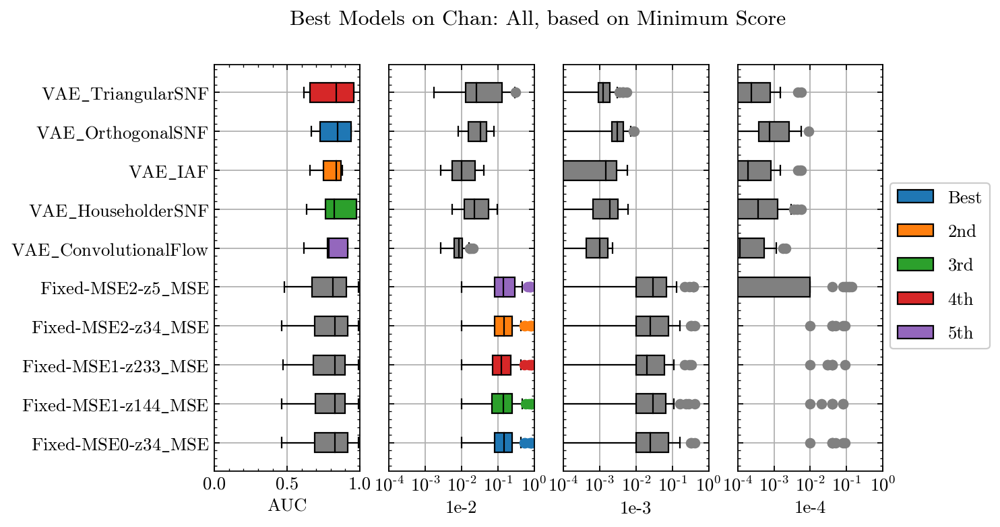

In [45]:
AnalyzeByMethod(AllCombined, 
                Chan='All', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 0,
                                  '1e-4': 0}, 
                Plot=True
               )

## Scan through individual channels
### Chan 1

****************************************
Models from chan=1 ranked by metric=AUC sorted by MinScore
                            Model  MinScore
294         VAE_ConvolutionalFlow  0.770178
290            VAE_HouseholderSNF  0.746779
293                       VAE_IAF  0.731834
470  VAE-dynamic-beta1-z34_Radius  0.730000
291             VAE_OrthogonalSNF  0.720097
****************************************

****************************************
Models from chan=1 ranked by metric=1e-2 sorted by MinScore
                                          Model  MinScore
303                                    PCA_D=10  0.111111
302                                     PCA_D=9  0.098765
550              DeepSetVAE_beta_1.0_weight_1.0  0.081416
477   Combined-AVG_VAE Radius + Flow Likelihood  0.080000
476  Combined-PROD_VAE Radius + Flow Likelihood  0.070000
****************************************

****************************************
Models from chan=1 ranked by metric=1e-3 sorted by MinScore
  

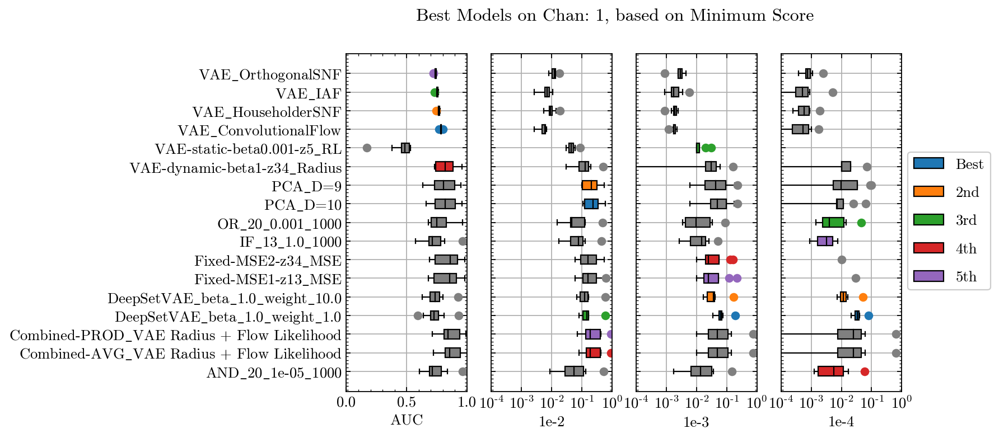

In [46]:
AnalyzeByMethod(AllCombined, 
                Chan='1', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Chan 2a

****************************************
Models from chan=2a ranked by metric=AUC sorted by MinScore
                  Model  MinScore
291   VAE_OrthogonalSNF  0.666274
292   VAE_TriangularSNF  0.655265
293             VAE_IAF  0.655265
290  VAE_HouseholderSNF  0.634438
288             VAE_NoF  0.632343
****************************************

****************************************
Models from chan=2a ranked by metric=1e-2 sorted by MinScore
                  Model  MinScore
291   VAE_OrthogonalSNF  0.013410
292   VAE_TriangularSNF  0.012903
293             VAE_IAF  0.012903
507  Fixed-MSE2-z13_MSE  0.010000
501  Fixed-MSE1-z55_MSE  0.010000
****************************************

****************************************
Models from chan=2a ranked by metric=1e-3 sorted by MinScore
             Model  MinScore
188  OR_4_1.0_1000  0.003099
****************************************



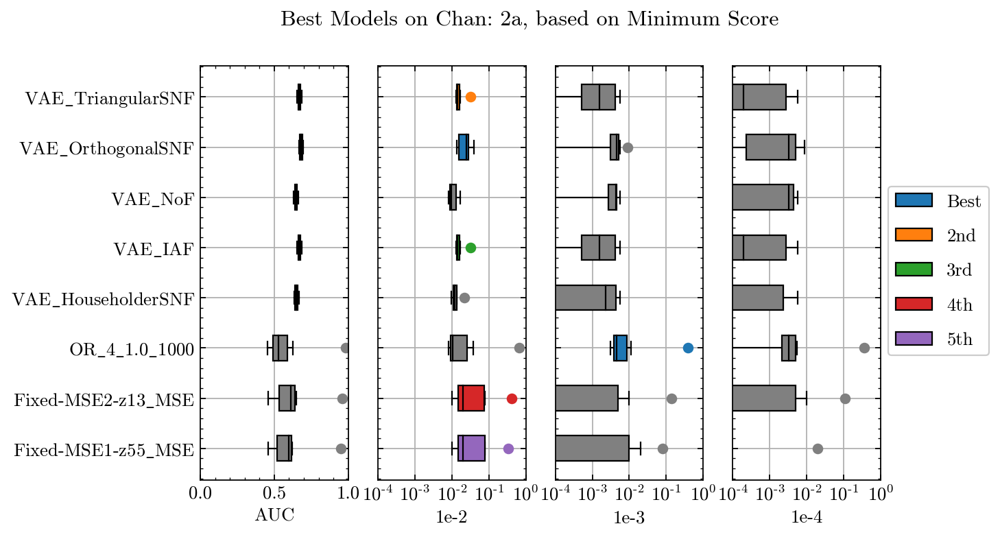

In [47]:
AnalyzeByMethod(AllCombined, 
                Chan='2a', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 1,
                                  '1e-4': 0}, 
                Plot=True
               )

### Chan 2b

****************************************
Models from chan=2b ranked by metric=AUC sorted by MinScore
                  Model  MinScore
291   VAE_OrthogonalSNF  0.845863
292   VAE_TriangularSNF  0.836889
293             VAE_IAF  0.836889
290  VAE_HouseholderSNF  0.822277
289      VAE_PlanarFlow  0.787935
****************************************

****************************************
Models from chan=2b ranked by metric=1e-2 sorted by MinScore
                                          Model  MinScore
471                   Flow-Efficient_Likelihood      0.12
476  Combined-PROD_VAE Radius + Flow Likelihood      0.12
477   Combined-AVG_VAE Radius + Flow Likelihood      0.12
474   Combined-AND_VAE Radius + Flow Likelihood      0.11
472              Flow-Efficient-No-E_Likelihood      0.11
****************************************

****************************************
Models from chan=2b ranked by metric=1e-3 sorted by MinScore
                                          Model  MinScore
5

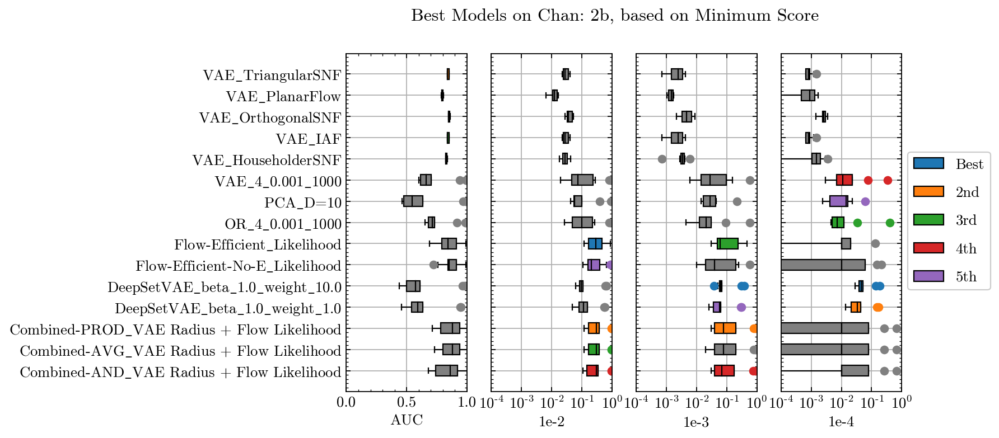

In [48]:
AnalyzeByMethod(AllCombined, 
                Chan='2b', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

### Chan 3

****************************************
Models from chan=3 ranked by metric=AUC sorted by MinScore
                     Model  MinScore
290     VAE_HouseholderSNF  0.974891
289         VAE_PlanarFlow  0.966551
292      VAE_TriangularSNF  0.956197
291      VAE_OrthogonalSNF  0.938686
294  VAE_ConvolutionalFlow  0.914184
****************************************

****************************************
Models from chan=3 ranked by metric=1e-2 sorted by MinScore
                                          Model  MinScore
476  Combined-PROD_VAE Radius + Flow Likelihood  0.230000
477   Combined-AVG_VAE Radius + Flow Likelihood  0.230000
289                              VAE_PlanarFlow  0.228353
474   Combined-AND_VAE Radius + Flow Likelihood  0.210000
137                          VAE_20_0.001_10000  0.162512
****************************************

****************************************
Models from chan=3 ranked by metric=1e-3 sorted by MinScore
                                          Mo

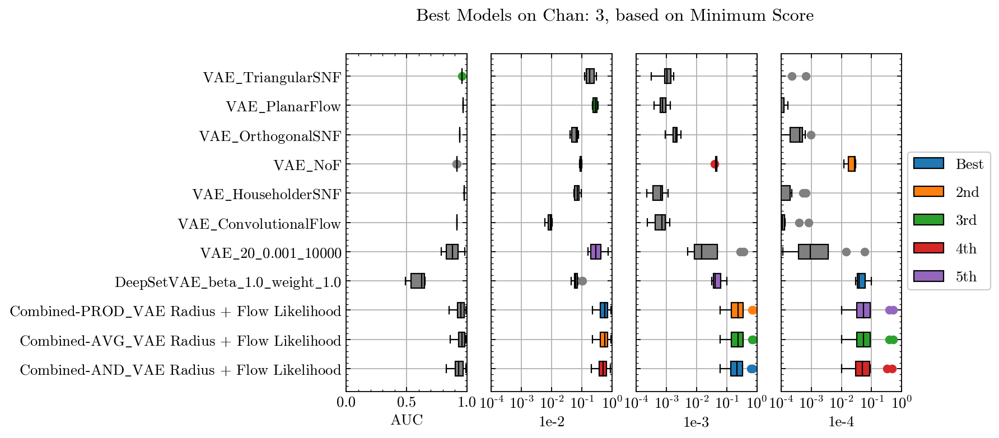

In [49]:
AnalyzeByMethod(AllCombined, 
                Chan='3', 
                Method='MinScore', 
                MetricNumberDict={'AUC': 5,
                                  '1e-2': 5,
                                  '1e-3': 5,
                                  '1e-4': 5}, 
                Plot=True
               )

# Analysis of the Physics Signals

The goal of this part of the analysis is to determine which signals are easy for _most_ models to get and which ones are the most challenging for the unsupervised methods.

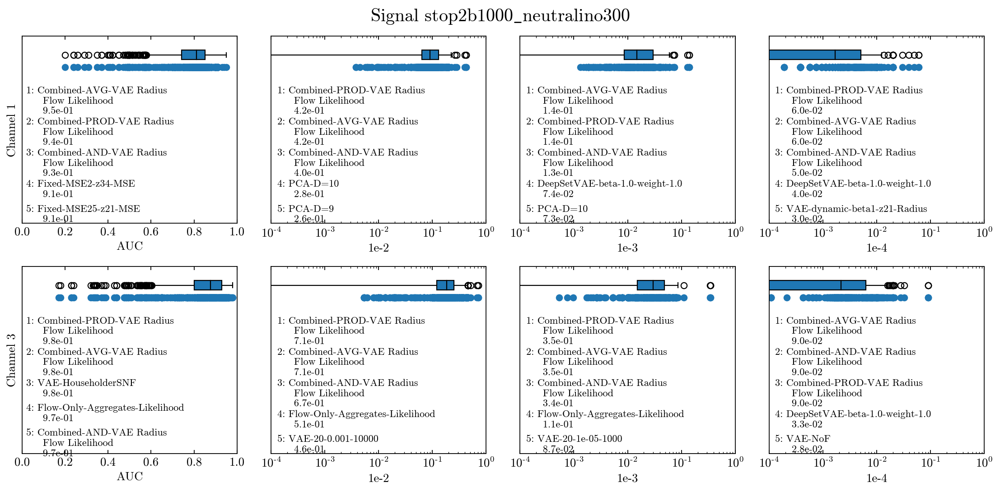

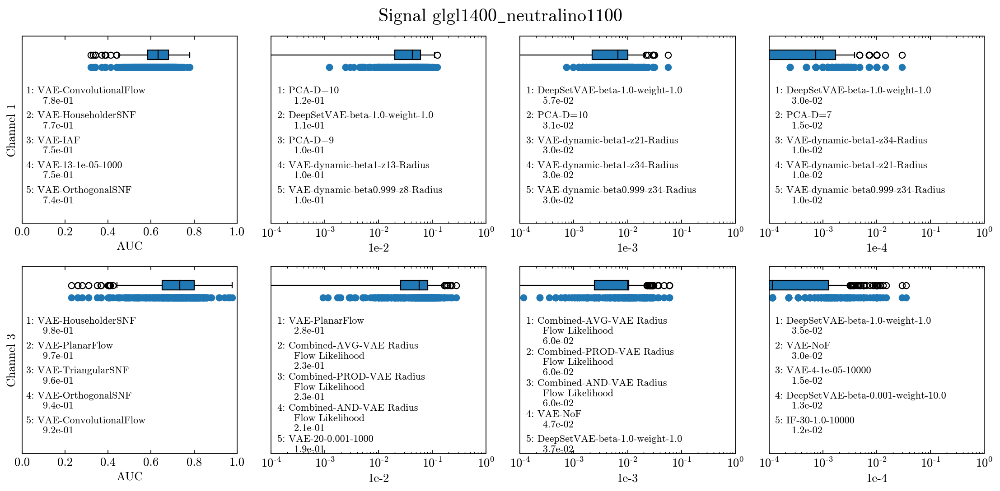

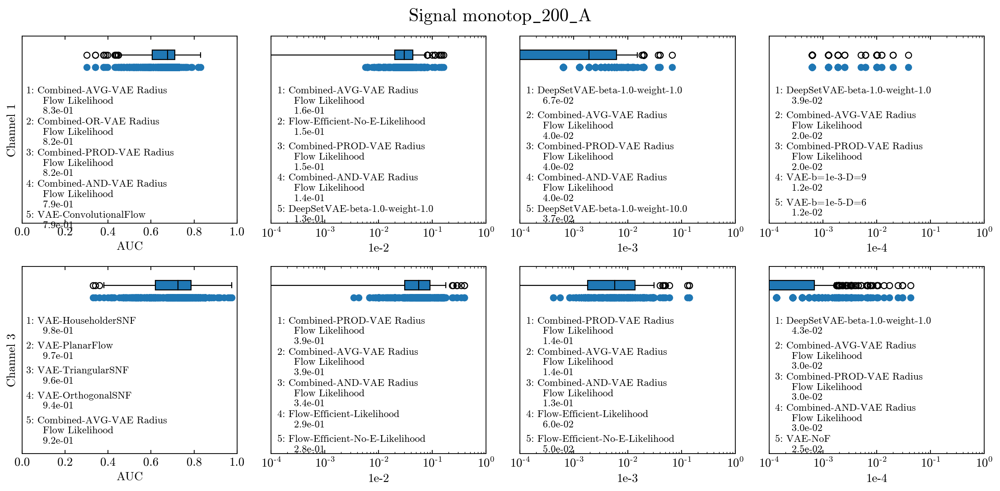

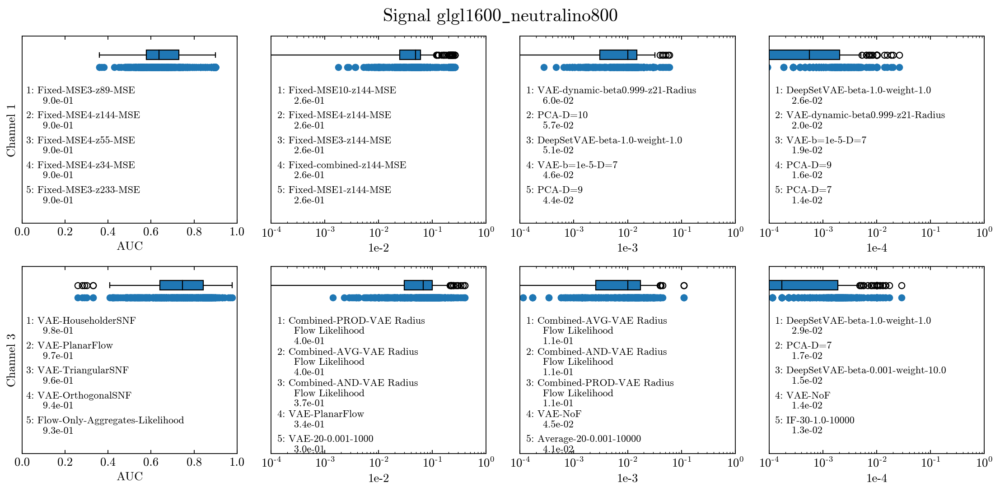

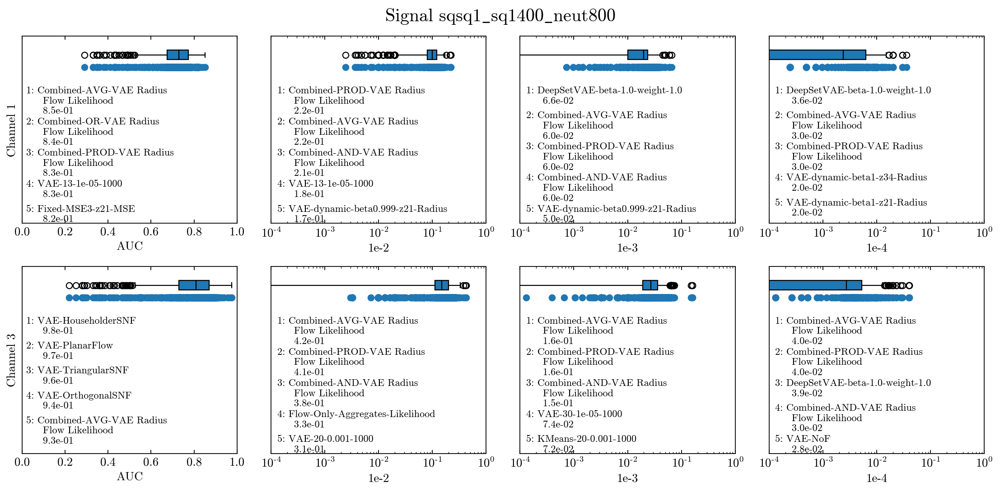

...

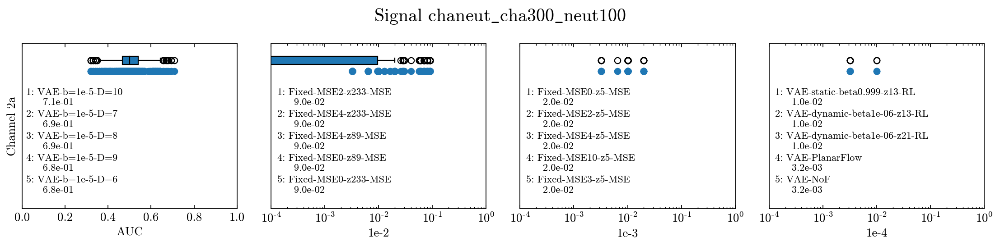

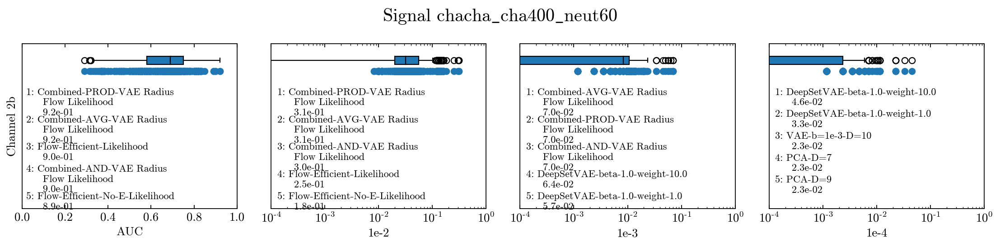

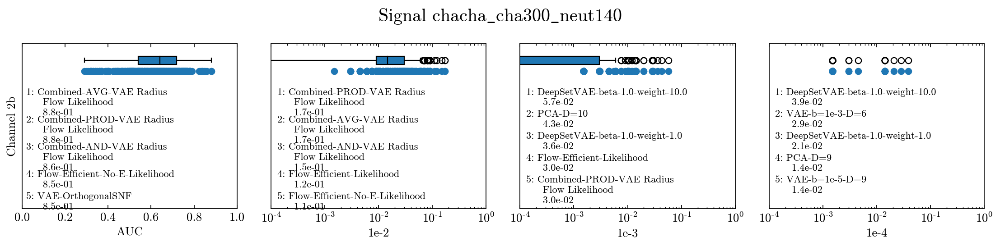

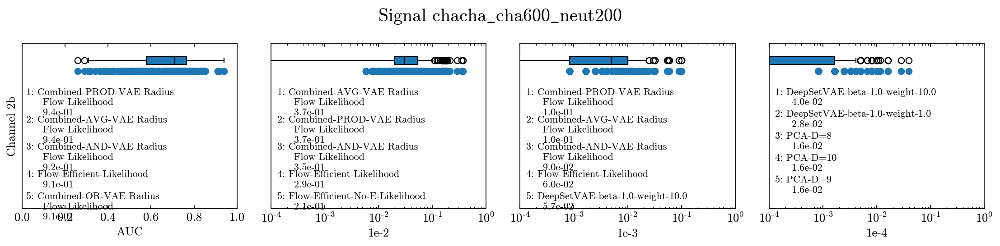

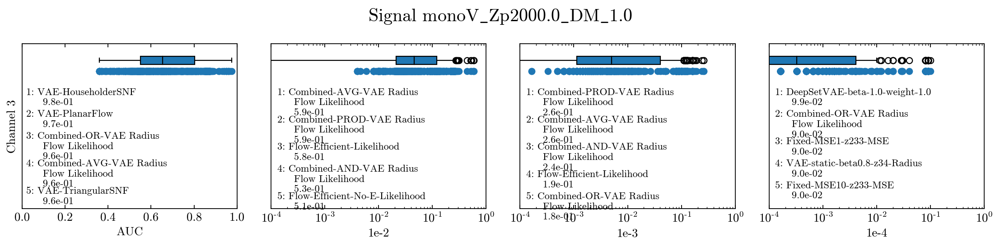

In [50]:
AllSigs = list(AllCombined['Signal'].unique())
for sig in AllSigs:
    tmp_df = AllCombined[AllCombined['Signal'] == sig]
    channels = list(tmp_df.Chan.unique())
    lc = len(channels)
    plt.figure(figsize=(3.5*4, 3.5*lc))
    
    for i, chan in enumerate(channels):
        tmp_df = AllCombined[(AllCombined['Signal'] == sig) & (AllCombined['Chan'] == chan)]
        for j, metric in enumerate(['AUC', '1e-2', '1e-3', '1e-4']):
            plt.subplot(lc, 4, (i*4)+j+1)
            myones = np.ones(len(tmp_df))
            plt.scatter(tmp_df[metric], myones, rasterized=True)
            plt.boxplot(np.array(tmp_df[metric]).reshape(-1, 1),
                        vert=False,
                        manage_ticks=False,
                        patch_artist=True,
                        medianprops={'color':'k'},
                        positions=[1.2]
                       )
            top_models = list(tmp_df.sort_values(by=metric, ascending=False)['Model'][:5])
            plt.ylim(-1.5, 1.5)
            base = 0.7
            for mn in range(5):
                change = 0.4
                mod = top_models[mn]
                if len(mod.split('+')) == 2:
                    change+=0.1
                    
                    
                plt.text(0.02 if metric == 'AUC' else (np.log10(20))*1e-4,
                         base,
                         (f'{mn + 1}: {top_models[mn]}'.replace('+', '\n    ').replace('_','-')) + '\n    ' f" {float(tmp_df[tmp_df['Model']==top_models[mn]][metric]):.1e}",
                         fontsize=10,
                         ha='left',
                         va='top'
                        )
                base -= change
            if metric == 'AUC':
                plt.xlim(0, 1)
                plt.ylabel(f'Channel {chan}')
            else:
                plt.xlim(1e-4, 1)
                plt.xscale('log')
                plt.xticks([1e-4, 1e-3, 1e-2, 1e-1, 1])
            plt.yticks([])
            plt.xlabel(metric)
    plt.suptitle(f'Signal {sig}'.replace("_", r"$\_$"), fontsize=18, y=0.97)
    plt.tight_layout()
    
    plt.savefig(f'IndividualSignal_{sig}.pdf', bbox_inches='tight')
    plt.show()


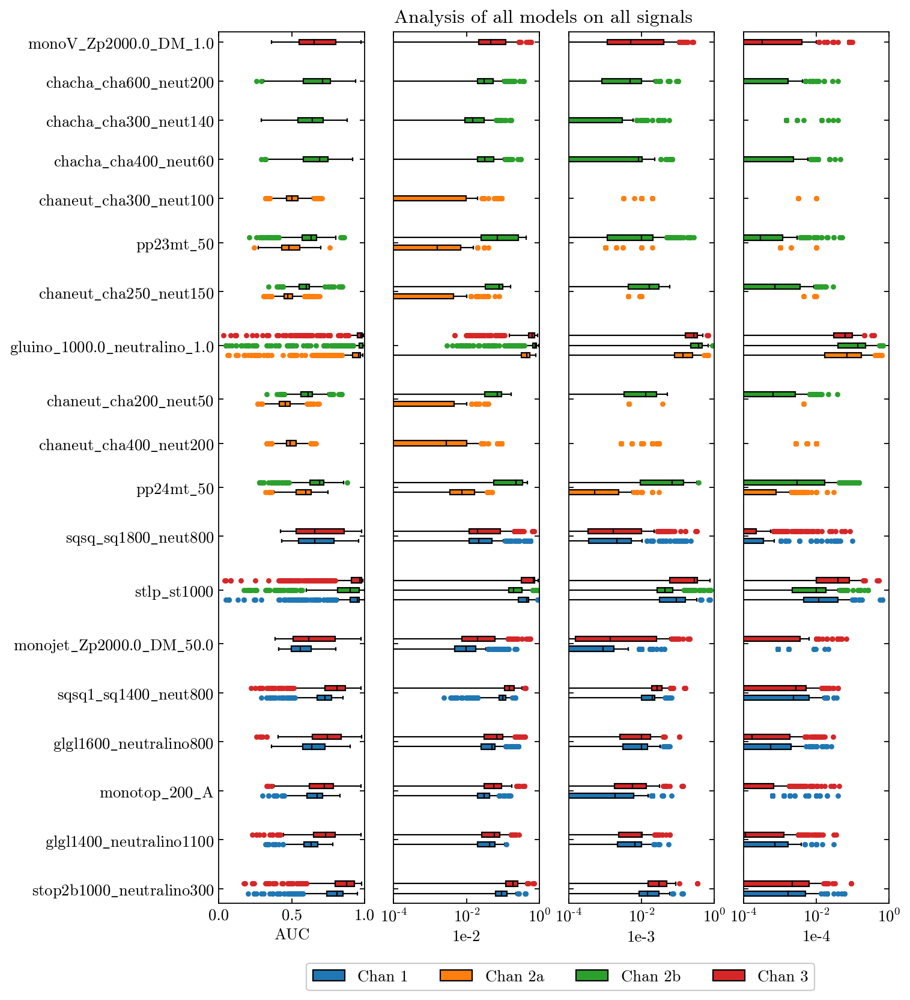

In [51]:
counter = 0
yvs = []
ListAUC = []
List1m2 = []
List1m3 = []
List1m4 = []
my_yticks = []
my_ynames = []
mycolors = []
colordict = {'1': 'C0', '2a': 'C1', '2b': 'C2', '3': 'C3'}
plt.figure(figsize=(9, 12))
for sig in AllSigs:
    tmp_df = AllCombined[AllCombined['Signal'] == sig]
    channels = list(tmp_df.Chan.unique())
    lc = len(channels)
    
    tmp_yn = []
    for i, chan in enumerate(channels):
        tmp_df = AllCombined[(AllCombined['Signal'] == sig) & (AllCombined['Chan'] == chan)]
        
        ListAUC.append(tmp_df['AUC'])
        List1m2.append(tmp_df['1e-2'])
        List1m3.append(tmp_df['1e-3'])
        List1m4.append(tmp_df['1e-4'])
        yvs.append(counter)
        tmp_yn.append(counter)
        counter += 1
        mycolors.append(colordict[chan])
    counter += 3
    my_yticks.append(np.mean(tmp_yn))
    my_ynames.append(sig.replace('_', '$\_$'))
plt.subplot(1, 4, 1)    
bbox1 = plt.boxplot(np.array(ListAUC).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xlim(0, 1)
plt.yticks(my_yticks, my_ynames)
plt.xlabel('AUC')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)

plt.subplot(1, 4, 2)    
bbox1 = plt.boxplot(np.array(List1m2).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xscale('log')
plt.xlim(1e-4, 1)
plt.yticks(my_yticks, [])
plt.xlabel('1e-2')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)

plt.subplot(1, 4, 3)    
bbox1 = plt.boxplot(np.array(List1m3).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xscale('log')
plt.xlim(1e-4, 1)
plt.yticks(my_yticks, [])
plt.xlabel('1e-3')
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.ylim(min(yvs)-1, max(yvs)+1)

plt.subplot(1, 4, 4)    
bbox1 = plt.boxplot(np.array(List1m4).T,
            vert=False,
            manage_ticks=False,
            patch_artist=True,
            medianprops={'color':'k'},
            positions=yvs
           )
plt.xscale('log')
plt.xlim(1e-4, 1)
plt.yticks(my_yticks, [])
for patch, flier, color in zip(bbox1['boxes'], bbox1['fliers'], mycolors):
    patch.set_facecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markerfacecolor(color)
    flier.set_markersize(3)
    flier.set_markeredgecolor(color)
plt.xlabel('1e-4')
plt.ylim(min(yvs)-1, max(yvs)+1)
    
    
legend_elements = [Patch(facecolor='C0', edgecolor='k',
                         label='Chan 1'),
                   Patch(facecolor='C1', edgecolor='k',
                         label='Chan 2a'),
                   Patch(facecolor='C2', edgecolor='k',
                         label='Chan 2b'),
                   Patch(facecolor='C3', edgecolor='k',
                         label='Chan 3')
                  ]
plt.legend(handles=legend_elements, 
           loc=(-3, -0.1), 
           labelspacing=1,
           ncol=4,
           facecolor='white',
           framealpha=1,
#            markerscale=100,
           frameon=True)
    
plt.suptitle('Analysis of all models on all signals', y=0.9)
plt.savefig('../reports/Plots/AllModelsAllSignals.pdf', bbox_inches='tight')
plt.show()
